#**Spatio-Temporal Air Quality Index (AQI) Modeling in DKI Jakarta Using a Hybrid LightGBM Regressor and Attention Mechanism Approach**

Thesis for the Master’s Program in Information Systems

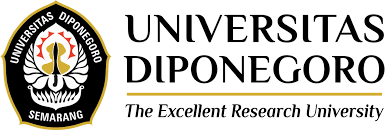

**Fauzia Dhiyaa’ Farros (30000324410004)**

# Introduction

In densely populated urban areas like DKI Jakarta, air pollution—especially fine particulate matter (PM2.5)—poses serious health risks, contributing to bronchitis, asthma, heart disease, stroke, and even death [1]. The interplay of multiple pollutants, weather variability, traffic emissions, and industrial activities complicates air quality dynamics [2], [13], prompting recent research to treat pollution as a spatiotemporal problem rather than isolated measurements [3], [14]. This approach captures both temporal patterns (e.g., hourly or daily changes) and spatial relationships across monitoring stations. Traditional statistical methods often fail to model these complex, nonlinear patterns, whereas machine learning models like LightGBM handle high-dimensional structured data efficiently using histogram-based binning and a leaf-wise growth strategy [4], [15]. However, LightGBM alone may not effectively prioritize temporal or environmental features unless explicitly guided. To address this, attention mechanisms—originally from natural language processing—are now applied in time series forecasting to emphasize critical features such as sudden weather shifts or pollution spikes [5], [6], [16], [17], [18]. Combining LightGBM with attention improves interpretability and predictive accuracy [6], [9], [10], [19], [20], though many models remain limited to low-resolution data or single-station inputs [7], [21]. This study proposes a hybrid attention–LightGBM Regressor framework to model multivariate spatiotemporal correlations of PM2.5 in DKI Jakarta, using hourly climate data from five satellite-derived sources and pollutant data (PM2.5, PM10, NO₂, SO₂, CO, O₃) from five ground stations (2020–2024). An attention mechanism is applied after preprocessing and temporal segmentation to highlight key variables at each timestep, followed by LightGBM to model nonlinear interactions. The method enhances interpretability and forecasting performance, offering insights for data-driven policymaking and urban air quality management.

# Business Understanding

This research provides accurate assessments of PM2.5 levels across urban areas, supporting strategies to control pollution from industry and transportation by integrating pollutant concentrations with climate conditions that often exceed who’s recommended limits, the system can capture both rapid fluctuations and long-term seasonal patterns.

The forecasting ability directly supports:
1. **Emission management**, where local governments can temporarily restrict heavy trucks or industrial activities when high pollution levels are predicted
2. **Public health advisory**, enabling early alerts when pm2.5 is expected to exceed 5 μg/m³ annually, potentially reducing hospital visits for respiratory problems by 3–5% and saving jakarta rp 50–100 billion in healthcare costs each year [3]
3. **Sustainable urban planning**, where long-term predictions guide low-emission zones, green spaces, and relocation of sensitive facilities by linking spatio-temporal correlations between pollutants and weather elements, this approach enhances prediction accuracy and strengthens data-driven decision-making for fast-response systems in Jakarta’s most vulnerable areas.

# Air Pollution Standard Index (BMKG AQI)

The dataset utilized in this study comprises the temporal Air Pollution Standard Index (ISPU) parameters collected from five Air Quality Monitoring Stations by Jakarta Environmental Agency. These stations are strategically located in the following areas:

1. DKI1 – Bundaran HI, Central Jakarta
2. DKI2 – Kelapa Gading, North Jakarta
3. DKI3 – Jagakarsa, South Jakarta
4. DKI4 – Lubang Buaya, East Jakarta
5. DKI5 – Kebon Jeruk, West Jakarta

The data is publicly available as open-source through the Jakarta Smart City portal at: https://satudata.jakarta.go.id/

## Data Understanding

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import pandas as pd

folder_path = '/content/drive/MyDrive/aqi_data/aqi'
file_list = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

dataframes = {}
for file_name in file_list:
    df_aqi = pd.read_csv(os.path.join(folder_path, file_name))
    dataframes[file_name] = df_aqi

In [ ]:
print(dataframes.keys())

dict_keys(['2020.csv', '2022.csv', '2023.csv', '2021.csv', '2024.csv'])


#### Dataframe 2020

In [ ]:
dataframes['2020.csv'].head()

,periode_data,tanggal,pm10,so2,co,o3,no2,max,critical,categori,lokasi_spku
0,202005,2020-05-01,55,26,21,83,10,83,O3,SEDANG,DKI5
1,202005,2020-05-02,36,22,12,80,9,80,O3,SEDANG,DKI5
2,202005,2020-05-03,65,34,35,49,11,65,PM10,SEDANG,DKI5
3,202005,2020-05-04,53,21,14,75,8,75,O3,SEDANG,DKI5
4,202005,2020-05-05,53,22,18,73,9,73,O3,SEDANG,DKI5


#### Dataframe 2021

In [ ]:
dataframes['2021.csv'].head()

,periode_data,tanggal,stasiun,pm10,pm25,so2,co,o3,no2,max,critical,categori
0,202101,2021-01-22,DKI5 (Kebon Jeruk) Jakarta Barat,45,NaN,21,13,40,15,45,PM10,BAIK
1,202101,2021-01-23,DKI5 (Kebon Jeruk) Jakarta Barat,80,NaN,22,44,44,22,80,PM10,SEDANG
2,202101,2021-01-24,DKI5 (Kebon Jeruk) Jakarta Barat,27,NaN,14,9,29,---,29,CO,BAIK
3,202101,2021-01-25,DKI5 (Kebon Jeruk) Jakarta Barat,55,NaN,19,29,67,13,67,CO,SEDANG
4,202101,2021-01-26,DKI5 (Kebon Jeruk) Jakarta Barat,57,NaN,21,23,36,16,57,PM10,SEDANG


#### Dataframe 2022

In [ ]:
dataframes['2022.csv'].head()

,critical,categori,lokasi_spku,periode_data,tanggal,pm_10,pm_duakomalima,so2,co,o3,no2,max
0,"PM2,5",SEDANG,DKI4,202212,44926.625,54,73,56,24,23,24,73
1,"PM2,5",SEDANG,DKI4,202212,2022-12-30,40,64,57,21,17,24,64
2,"PM2,5",TIDAK SEHAT,DKI4,202207,2022-07-06,75,129,45,25,71,26,129
3,"PM2,5",TIDAK SEHAT,DKI4,202207,2022-07-05,66,110,47,16,61,23,110
4,"PM2,5",SEDANG,DKI4,202207,2022-07-04,56,78,49,11,60,13,78


#### Dataframe 2023

In [ ]:
dataframes['2023.csv'].head()

,periode_data,tanggal,stasiun,pm_sepuluh,pm_duakomalima,sulfur_dioksida,karbon_monoksida,ozon,nitrogen_dioksida,max,parameter_pencemar_kritis,kategori
0,202302,2023-02-25,DKI5 Kebon Jeruk Jakarta Barat,35,-,13,12,31,18,35,PM10,BAIK
1,202302,2023-02-26,DKI5 Kebon Jeruk Jakarta Barat,23,-,14,9,32,11,32,O3,BAIK
2,202302,2023-02-27,DKI5 Kebon Jeruk Jakarta Barat,20,-,13,8,33,13,33,O3,BAIK
3,202302,2023-02-28,DKI5 Kebon Jeruk Jakarta Barat,30,-,21,11,28,18,30,PM10,BAIK
4,202303,2023-03-01,DKI1 Bunderan HI,38,44,50,8,19,27,50,3,BAIK


#### Dataframe 2024

In [ ]:
dataframes['2024.csv'].head()

,parameter_pencemar_kritis,kategori,periode_data,bulan,tanggal,stasiun,pm_sepuluh,pm_duakomalima,sulfur_dioksida,karbon_monoksida,ozon,nitrogen_dioksida,max
0,NaN,SEDANG,202401,1,2024-01-21,DKI3 Jagakarsa,51.0,65.0,45.0,9.0,8.0,79.0,79.0
1,NaN,SEDANG,202401,1,2024-01-22,DKI3 Jagakarsa,27.0,34.0,45.0,5.0,8.0,56.0,56.0
2,PM25,SEDANG,202401,1,2024-01-23,DKI3 Jagakarsa,NaN,52.0,46.0,6.0,9.0,51.0,52.0
3,PM25,SEDANG,202401,1,2024-01-24,DKI3 Jagakarsa,46.0,65.0,46.0,8.0,9.0,38.0,65.0
4,PM25,SEDANG,202401,1,2024-01-25,DKI3 Jagakarsa,37.0,55.0,47.0,7.0,11.0,28.0,55.0


## Data Preparation

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler

df_cleaned = df_aqi.copy()

rename_map = {
    'pm10': 'PM10', 'pm_10': 'PM10', 'pm25': 'PM2.5', 'pm_duakomalima': 'PM2.5', 'pm_sepuluh': 'PM10',
    'so2': 'SO2', 'co': 'CO', 'o3': 'O3', 'no2': 'NO2',
    'karbon_monoksida': 'CO', 'ozon': 'O3', 'nitrogen_dioksida': 'NO2',
    'sulfur_dioksida': 'SO2',
    'critical': 'Critical', 'parameter_pencemar_kritis': 'Critical',
    'categori': 'Category', 'kategori': 'Category',
    'lokasi_spku': 'Station', 'stasiun': 'Station'
}

df_cleaned.columns = df_cleaned.columns.str.lower()
rename_map_lower = {k.lower(): v for k, v in rename_map.items()}
df_cleaned.rename(columns=rename_map_lower, inplace=True)

def convert_to_datetime(val):
    try:
        return pd.to_datetime(val)
    except:
        try:
            return pd.to_datetime(float(val), unit='D', origin='1899-12-30')
        except:
            return pd.NaT

df_cleaned['tanggal'] = df_cleaned['tanggal'].apply(convert_to_datetime)

df_cleaned.dropna(subset=['tanggal'], inplace=True)

df_cleaned.set_index('tanggal', inplace=True)
df_cleaned.sort_index(inplace=True)

print("Initial missing values:\n", df_cleaned.isna().sum())

pollutant_cols = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2']

pollutant_cols_present = [col for col in pollutant_cols if col in df_cleaned.columns]

if 'Station' in df_cleaned.columns:
    df_cleaned[pollutant_cols_present] = df_cleaned.groupby('Station')[pollutant_cols_present].transform(
        lambda x: x.interpolate(method='linear', limit_direction='both')
    )

for col in pollutant_cols_present:
    df_cleaned[col].fillna(df_cleaned[col].median(), inplace=True)

print("\nMissing values after median imputation:\n", df_cleaned[pollutant_cols_present].isna().sum())

df_cleaned['year'] = df_cleaned.index.year
df_cleaned['month'] = df_cleaned.index.month
df_cleaned['hour'] = df_cleaned.index.hour
df_cleaned['day_of_week'] = df_cleaned.index.dayofweek

if 'Critical' in df_cleaned.columns:
    df_cleaned['Critical'].fillna(method='ffill', inplace=True)
if 'Max' in df_cleaned.columns:
    df_cleaned['Max'].fillna(df_cleaned['Max'].median(), inplace=True)

print("\nFinal missing values check:\n", df_cleaned.isna().sum())

scaler = StandardScaler()
cols_to_scale = [col for col in pollutant_cols_present if pd.api.types.is_numeric_dtype(df_cleaned[col])]

df_cleaned[cols_to_scale] = scaler.fit_transform(df_cleaned[cols_to_scale])

display(df_cleaned.head())

Initial missing values:
 Critical         59
Category          0
periode_data      0
bulan             0
Station           0
PM10            142
PM2.5            43
SO2              48
CO               39
O3               36
NO2              60
max               5
dtype: int64

Missing values after median imputation:
 PM10     0
PM2.5    0
SO2      0
CO       0
O3       0
NO2      0
dtype: int64

Final missing values check:
 Critical        0
Category        0
periode_data    0
bulan           0
Station         0
PM10            0
PM2.5           0
SO2             0
CO              0
O3              0
NO2             0
max             5
year            0
month           0
hour            0
day_of_week     0
dtype: int64


/tmp/ipython-input-3950181682.py:49: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_cleaned[col].fillna(df_cleaned[col].median(), inplace=True)
/tmp/ipython-input-3950181682.py:59: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplac

,Critical,Category,periode_data,bulan,Station,PM10,PM2.5,SO2,CO,O3,NO2,max,year,month,hour,day_of_week
tanggal,,,,,,,,,,,,,,,,
2024-01-01,PM25,TIDAK SEHAT,202401,1,DKI4 Lubang Buaya,1.513453,1.772590,-1.491491,0.621058,-0.018683,-0.924403,110.0,2024,1,0,0
2024-01-01,PM25,SEDANG,202401,1,DKI1 Bundaran Hotel Indonesia (HI),0.940633,0.870309,0.918952,-0.893893,-0.802813,0.271868,89.0,2024,1,0,0
2024-01-01,PM25,TIDAK SEHAT,202401,1,DKI2 Kelapa Gading,1.112479,1.471830,-0.114095,0.345612,0.123886,-0.326268,103.0,2024,1,0,0
2024-01-01,PM25,SEDANG,202401,1,DKI3 Jagakarsa,0.997915,0.870309,-1.261925,5.303636,-0.802813,-1.343099,89.0,2024,1,0,0
2024-01-01,PM25,SEDANG,202401,1,DKI5 Kebon Jeruk Jakarta Barat,0.596941,1.299967,0.230254,0.345612,2.191139,-0.804776,99.0,2024,1,0,0


## Exploratory Data Analysis (EDA)

### Descriptive Summary

#### Data Type


In [ ]:
import pandas as pd
import os

folder_path = '/content/drive/MyDrive/aqi_data/aqi'
file_list = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

rename_map = {
    'pm_sepuluh': 'PM10',
    'pm_duakomalima': 'PM2.5',
    'pm_10': 'PM10',
    'pm25': 'PM2.5',
    'pm10': 'PM10',
    'so2': 'SO2',
    'co': 'CO',
    'o3': 'O3',
    'no2': 'NO2',
    'max': 'Max',
    'critical': 'Critical',
    'categori': 'Category',
    'kategori': 'Category',
    'lokasi_spku': 'Station',
    'stasiun': 'Station',
    'parameter_pencemar_kritis': 'Critical'
}

dataframes = []
for file_name in file_list:
    df = pd.read_csv(os.path.join(folder_path, file_name))
    df.columns = df.columns.str.lower()
    rename_map_lower = {k.lower(): v for k, v in rename_map.items()}
    df.rename(columns=rename_map_lower, inplace=True)
    dataframes.append(df)

df_aqi_combined = pd.concat(dataframes, ignore_index=True)

In [ ]:
import pandas as pd

df_aqi_combined['tanggal'] = pd.to_datetime(df_aqi_combined['tanggal'], errors='coerce')

numeric_cols = [
    'PM10', 'SO2', 'CO', 'O3', 'NO2', 'Max', 'PM2.5',
    'sulfur_dioksida', 'karbon_monoksida', 'ozon', 'nitrogen_dioksida'
]

for col in numeric_cols:
    if col in df_aqi_combined.columns:
        df_aqi_combined[col] = pd.to_numeric(df_aqi_combined[col], errors='coerce')
    else:
        print(f"Warning: Column '{col}' not found in the dataframe.")

print(df_aqi_combined.dtypes)
print("Total rows:", len(df_aqi_combined))

periode_data                  int64
tanggal              datetime64[ns]
PM10                        float64
SO2                         float64
CO                          float64
O3                          float64
NO2                         float64
Max                         float64
Critical                     object
Category                     object
Station                      object
PM2.5                       float64
sulfur_dioksida             float64
karbon_monoksida            float64
ozon                        float64
nitrogen_dioksida           float64
bulan                       float64
dtype: object
Total rows: 6966


#### Data Analysis

##### Numerical Data

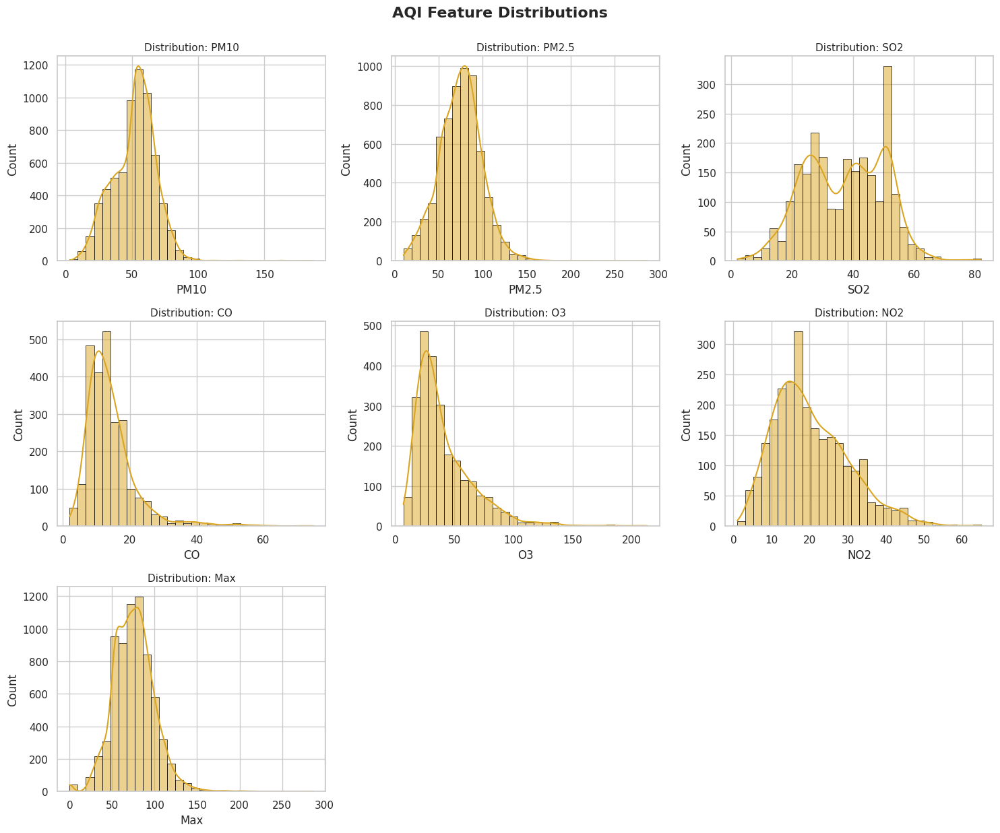

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

aqi_numerical_features = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2', 'Max']

for col in aqi_numerical_features:
    if col in df_aqi_combined.columns:
       df_aqi_combined[col] = pd.to_numeric(df_aqi_combined[col], errors='coerce')

def plot_distributions(df, numerical_features, main_title="Numerical Feature Distributions", color='steelblue'):
    sns.set(style='whitegrid')

    num_cols = len(numerical_features)
    n_cols = 3
    n_rows = -(-num_cols // n_cols)

    plt.figure(figsize=(5 * n_cols, 4 * n_rows))

    for i, col in enumerate(numerical_features):
        plt.subplot(n_rows, n_cols, i + 1)
        if col in df.columns:
            sns.histplot(df[col].dropna(), kde=True, bins=30, color=color, edgecolor='black', linewidth=0.5)
            plt.title(f'Distribution: {col}', fontsize=11)
            plt.xlabel(col)
            plt.ylabel('Count')
        else:
            plt.title(f'{col} not found', fontsize=10)
            plt.axis('off')

    plt.tight_layout()
    plt.suptitle(main_title, fontsize=16, fontweight='bold', y=1.03)
    plt.show()

aqi_features_present = [f for f in aqi_numerical_features if f in df_aqi_combined.columns]

plot_distributions(df_aqi_combined, aqi_features_present, main_title='AQI Feature Distributions', color='goldenrod')

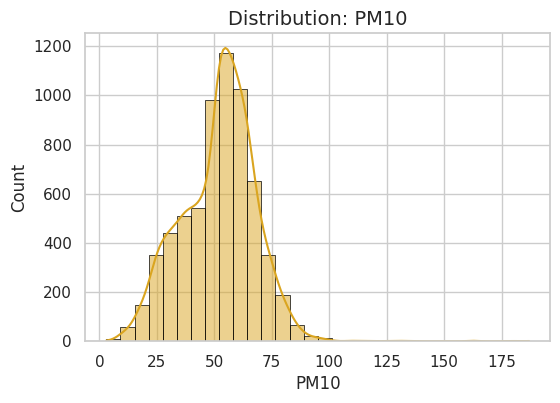

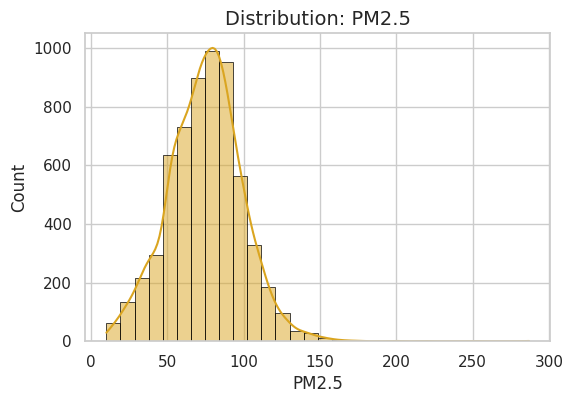

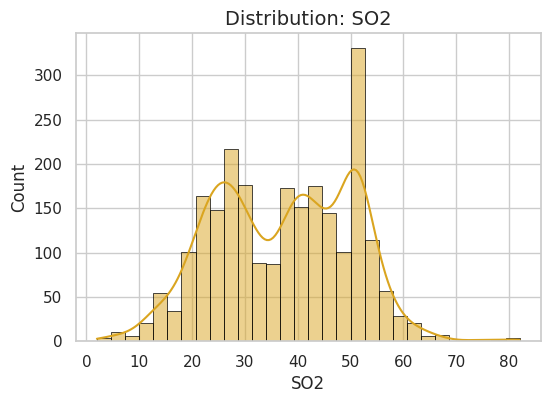

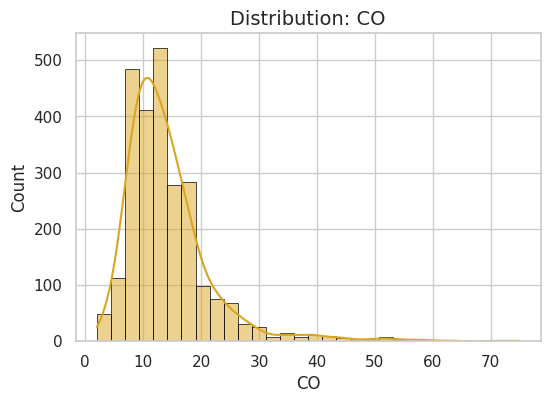

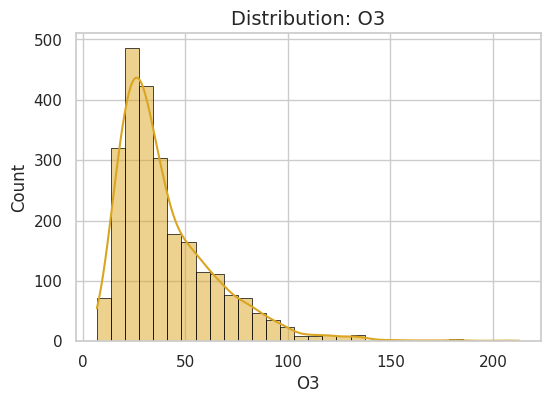

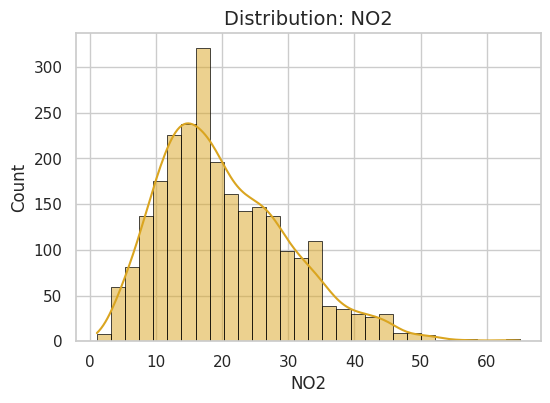

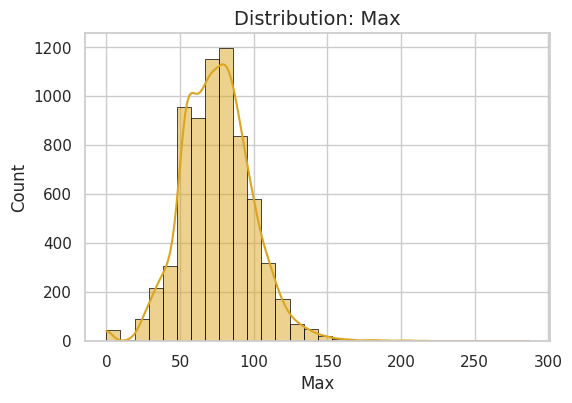

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

aqi_numerical_features = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2', 'Max']

for col in aqi_numerical_features:
    if col in df_aqi_combined.columns:
        df_aqi_combined[col] = pd.to_numeric(df_aqi_combined[col], errors='coerce')

def plot_distributions_separate(df, numerical_features, color='steelblue'):
    sns.set(style='whitegrid')

    for col in numerical_features:
        if col in df.columns:
            plt.figure(figsize=(6,4))
            sns.histplot(df[col].dropna(), kde=True, bins=30,
                         color=color, edgecolor='black', linewidth=0.5)
            plt.title(f'Distribution: {col}', fontsize=14)
            plt.xlabel(col)
            plt.ylabel('Count')
            plt.show()
        else:
            print(f"Kolom {col} tidak ditemukan di dataframe")

aqi_features_present = [f for f in aqi_numerical_features if f in df_aqi_combined.columns]

plot_distributions_separate(df_aqi_combined, aqi_features_present, color='goldenrod')


##### Categorical Data

In [ ]:
df_aqi_combined['Station'] = df_aqi_combined['Station'].str.strip()
df_aqi_combined['Category'] = df_aqi_combined['Category'].str.upper().str.strip()

expected_categories = ['BAIK', 'SEDANG', 'TIDAK SEHAT', 'SANGAT TIDAK SEHAT', 'BERBAHAYA', 'TIDAK ADA DATA']
expected_stations = ['DKI1', 'DKI2', 'DKI3', 'DKI4', 'DKI5']

df_aqi_combined['Category'] = df_aqi_combined['Category'].apply(lambda x: x if x in expected_categories else 'TIDAK ADA DATA')
df_aqi_combined['Category'] = df_aqi_combined['Category'].fillna('TIDAK ADA DATA')

station_mapping = {
    'DKI1': 'DKI1 - Bundaran HI',
    'DKI1 (BUNDARAN HI)': 'DKI1 - Bundaran HI',
    'DKI1 BUNDARAN HI': 'DKI1 - Bundaran HI',
    'DKI2': 'DKI2 - Kelapa Gading',
    'DKI2 (KELAPA GADING)': 'DKI2 - Kelapa Gading',
    'DKI2 KELAPA GADING': 'DKI2 - Kelapa Gading',
    'DKI3': 'DKI3 - Jagakarsa',
    'DKI3 (JAGAKARSA)': 'DKI3 - Jagakarsa',
    'DKI3 JAGAKARSA': 'DKI3 - Jagakarsa',
    'DKI4': 'DKI4 - Lubang Buaya',
    'DKI4 (LUBANG BUAYA)': 'DKI4 - Lubang Buaya',
    'DKI4 LUBANG BUAYA': 'DKI4 - Lubang Buaya',
    'DKI5': 'DKI5 - Kebon Jeruk',
    'DKI5 (KEBON JERUK) JAKARTA BARAT': 'DKI5 - Kebon Jeruk',
    'DKI5 KEBON JERUK JAKARTA BARAT': 'DKI5 - Kebon Jeruk',
    'DKI5 KEBON JERUK': 'DKI5 - Kebon Jeruk',
}
df_aqi_combined['Station'] = df_aqi_combined['Station'].apply(lambda x: station_mapping.get(x, x))

df_filtered = df_aqi_combined[
    df_aqi_combined['Station'].isin(station_mapping.values()) &
    df_aqi_combined['Category'].isin(expected_categories)
].copy()


categorical_features = ['Station', 'Category']

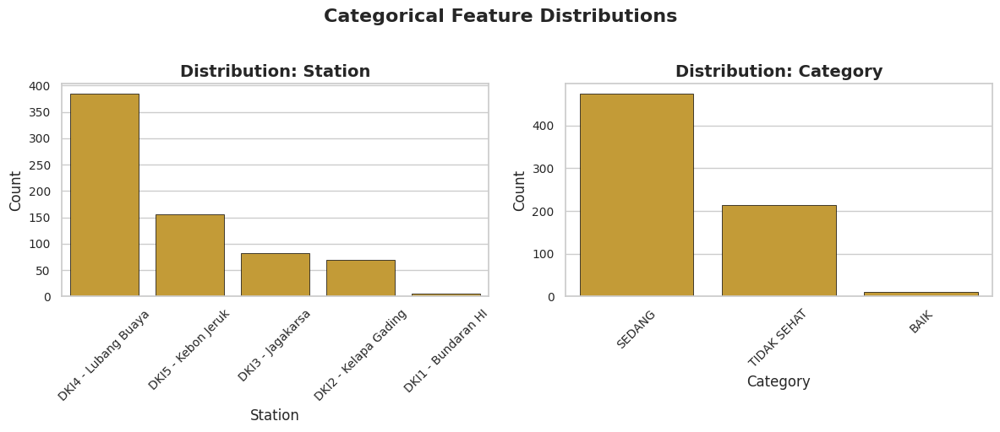

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_categorical_distributions_grid(df, categorical_features, color='goldenrod'):
    sns.set(style='whitegrid')

    n_features = len(categorical_features)
    n_cols = 2 if n_features > 1 else 1
    n_rows = -(-n_features // n_cols)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 5 * n_rows))
    axes = axes.flatten()

    for i, col in enumerate(categorical_features):
        if col in df.columns:
            order = df[col].value_counts().index
            sns.countplot(
                data=df,
                x=col,
                order=order,
                color=color,
                edgecolor='black',
                linewidth=0.5,
                ax=axes[i]
            )
            axes[i].set_title(f'Distribution: {col}', fontsize=14, fontweight='bold')
            axes[i].set_xlabel(col, fontsize=12)
            axes[i].set_ylabel('Count', fontsize=12)
            axes[i].tick_params(axis='x', rotation=45, labelsize=10)
            axes[i].tick_params(axis='y', labelsize=10)
        else:
            axes[i].set_title(f'{col} not found', fontsize=12)
            axes[i].axis('off')

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    fig.suptitle("Categorical Feature Distributions", fontsize=16, fontweight="bold", y=1.02)
    plt.tight_layout()
    plt.show()

plot_categorical_distributions_grid(
    df_filtered,
    categorical_features,
    color='goldenrod'
)

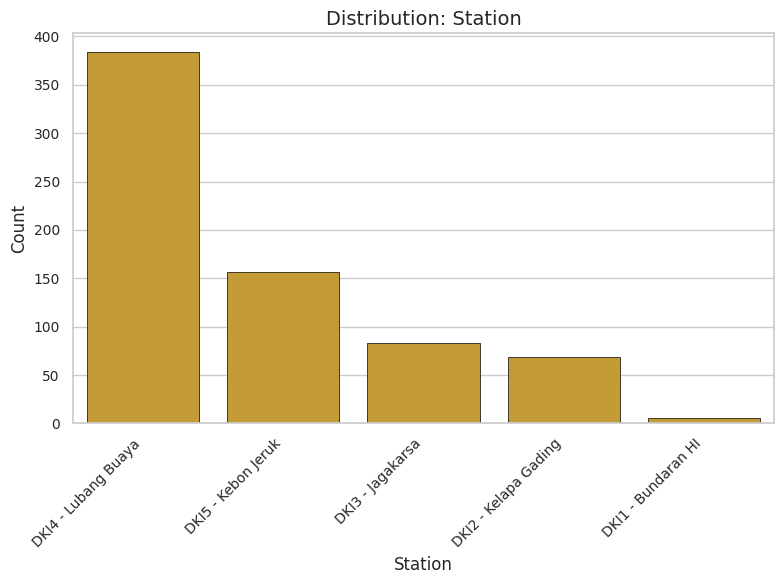

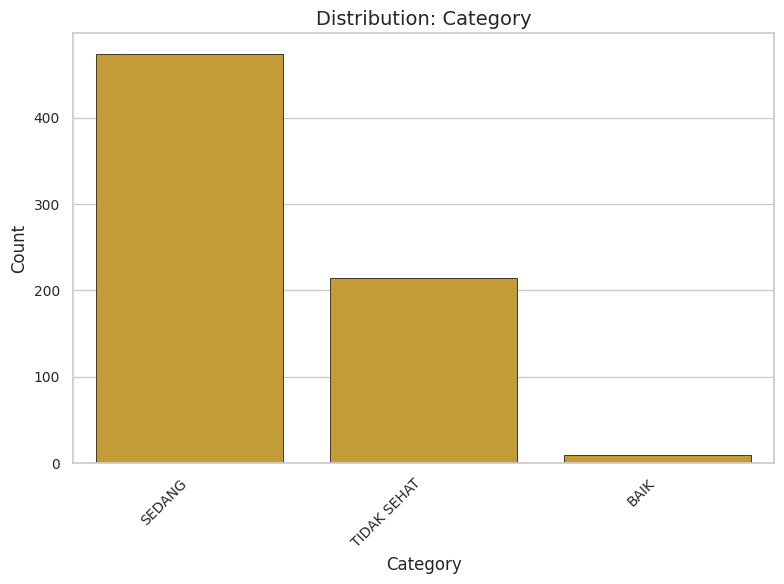

In [ ]:
def plot_categorical_distributions_separate(df, categorical_features, color='goldenrod'):
    sns.set(style='whitegrid')

    for col in categorical_features:
        if col in df.columns:
            plt.figure(figsize=(8, 6))
            order = df[col].value_counts().index
            sns.countplot(
                data=df,
                x=col,
                order=order,
                color=color,
                edgecolor='black',
                linewidth=0.5
            )
            plt.title(f'Distribution: {col}', fontsize=14)
            plt.xlabel(col, fontsize=12)
            plt.ylabel('Count', fontsize=12)
            plt.xticks(rotation=45, ha='right', fontsize=10)
            plt.yticks(fontsize=10)
            plt.tight_layout()
            plt.show()
        else:
            print(f"Kolom {col} tidak ditemukan di dataframe")

plot_categorical_distributions_separate(
    df_filtered,
    categorical_features,
    color='goldenrod'
)

#### Statistic Descriptive

In [ ]:
numeric_cols = df_aqi_combined.select_dtypes(include=['number']).columns
descriptive_stats = df_aqi_combined[numeric_cols].describe()
display(descriptive_stats)

,periode_data,PM10,SO2,CO,O3,NO2,Max,PM2.5,sulfur_dioksida,karbon_monoksida,ozon,nitrogen_dioksida,bulan
count,6966.000000,6534.000000,2429.000000,2519.000000,2488.000000,2521.000000,6957.000000,6162.000000,4323.000000,4327.000000,4345.000000,4284.000000,2585.000000
mean,202278.464111,51.859045,37.222725,14.152441,40.959807,20.358191,75.323559,75.036352,36.898681,14.336492,25.962025,22.381419,5.491296
std,148.215925,16.095447,12.918202,7.609394,25.016440,9.810457,24.090264,24.269272,15.923228,7.165504,13.793087,14.494637,3.400285
min,202001.000000,3.000000,2.000000,2.000000,7.000000,1.000000,0.000000,10.000000,3.000000,1.000000,2.000000,0.000000,1.000000
25%,202110.000000,41.000000,26.000000,9.000000,24.000000,13.000000,59.000000,59.000000,23.000000,9.000000,16.000000,13.000000,3.000000
50%,202306.000000,54.000000,38.000000,13.000000,33.000000,19.000000,75.000000,76.000000,35.000000,13.000000,24.000000,19.000000,5.000000
75%,202406.000000,62.000000,49.000000,17.000000,52.000000,26.000000,90.000000,90.000000,53.000000,19.000000,33.000000,29.000000,8.000000
max,202505.000000,187.000000,82.000000,75.000000,213.000000,65.000000,287.000000,287.000000,112.000000,70.000000,115.000000,202.000000,12.000000


### Temporal Analysis


#### Annual Trend


In [ ]:
df_filtered_stations = df_aqi.copy()

rename_map = {
    'pm_sepuluh': 'PM10',
    'pm_duakomalima': 'PM2.5',
    'pm_10': 'PM10',
    'pm25': 'PM2.5',
    'pm10': 'PM10',
    'so2': 'SO2',
    'co': 'CO',
    'o3': 'O3',
    'no2': 'NO2',
    'max': 'Max',
    'critical': 'Critical',
    'categori': 'Category',
    'kategori': 'Category',
    'lokasi_spku': 'Station',
    'stasiun': 'Station',
    'parameter_pencemar_kritis': 'Critical'
}

df_filtered_stations = df_filtered_stations.rename(columns=rename_map)

pollutant_cols = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2','Max']
pollutant_cols_present = [col for col in pollutant_cols if col in df_filtered_stations.columns]

if 'Station' in df_filtered_stations.columns:
    df_filtered_stations[pollutant_cols_present] = df_filtered_stations.groupby('Station')[pollutant_cols_present]\
        .transform(lambda x: x.interpolate(method='linear', limit_direction='both'))

for col in pollutant_cols_present:
    df_filtered_stations[col] = df_filtered_stations[col].fillna(df_filtered_stations[col].median())

print("Jumlah NaN setelah imputasi:\n", df_filtered_stations[pollutant_cols_present].isna().sum())


Jumlah NaN setelah imputasi:
 PM10     0
PM2.5    0
Max      0
dtype: int64


In [ ]:
df_combined_cleaned = df_aqi_combined.copy()
df_combined_cleaned.columns = df_combined_cleaned.columns.str.lower()

rename_map = {
    'pm10': 'PM10', 'pm_10': 'PM10', 'pm25': 'PM2.5', 'pm_duakomalima': 'PM2.5', 'pm_sepuluh': 'PM10',
    'so2': 'SO2', 'co': 'CO', 'o3': 'O3', 'no2': 'NO2',
    'karbon_monoksida': 'CO', 'ozon': 'O3', 'nitrogen_dioksida': 'NO2', 'sulfur_dioksida': 'SO2',
    'critical': 'Critical', 'parameter_pencemar_kritis': 'Critical',
    'categori': 'Category', 'kategori': 'Category',
    'lokasi_spku': 'Station', 'stasiun': 'Station'
}
rename_map_lower = {k.lower(): v for k, v in rename_map.items()}
df_combined_cleaned.rename(columns=rename_map_lower, inplace=True)

station_mapping = {
    'DKI1': 'DKI1 - Bunderan HI',
    'DKI1 (Bunderan HI)': 'DKI1 - Bunderan HI',
    'DKI1 Bunderan HI': 'DKI1 - Bunderan HI',
    'DKI1  Bunderan HI ': 'DKI1 - Bunderan HI',
    ' DKI1  Bunderan HI  ': 'DKI1 - Bunderan HI',
    'DKI1  Bundaran Hotel Indonesia (HI)': 'DKI1 - Bunderan HI',
    'DKI1 Bundaran Hotel Indonesia (HI)': 'DKI1 - Bunderan HI',
    'DKI2': 'DKI2 - Kelapa Gading',
    'DKI2 (Kelapa Gading)': 'DKI2 - Kelapa Gading',
    'DKI2 Kelapa Gading': 'DKI2 - Kelapa Gading',
    'DKI2  Kelapa Gading ': 'DKI2 - Kelapa Gading',
    ' DKI2  Kelapa Gading  ': 'DKI2 - Kelapa Gading',
    'DKI3': 'DKI3 - Jagakarsa',
    'DKI3 (Jagakarsa)': 'DKI3 - Jagakarsa',
    'DKI3 Jagakarsa': 'DKI3 - Jagakarsa',
    'DKI3  Jagakarsa ': 'DKI3 - Jagakarsa',
    ' DKI3  Jagakarsa  ': 'DKI3 - Jagakarsa',
    'DKI4': 'DKI4 - Lubang Buaya',
    'DKI4 (Lubang Buaya)': 'DKI4 - Lubang Buangitaya',
    'DKI4 Lubang Buaya': 'DKI4 - Lubang Buaya',
    'DKI4  Lubang Buaya ': 'DKI4 - Lubang Buaya',
    ' DKI4  Lubang Buaya  ': 'DKI4 - Lubang Buaya',
    'DKI5': 'DKI5 - Kebon Jeruk',
    'DKI5 (Kebon Jeruk) Jakarta Barat': 'DKI5 - Kebon Jeruk',
    'DKI5 Kebon Jeruk Jakarta Barat': 'DKI5 - Kebon Jeruk',
    'DKI5 Kebon Jeruk': 'DKI5 - Kebon Jeruk',
    'DKI5  Kebon Jeruk  Jakarta Barat': 'DKI5 - Kebon Jeruk',
    'DKI4  Lubang Buaya': 'DKI4 - Lubang Buaya',
    'DKI2  Kelapa Gading': 'DKI2 - Kelapa Gading',
    'DKI3  Jagakarsa': 'DKI3 - Jagakarsa',
    'DKI1  Bunderan HI': 'DKI1 - Bunderan HI',
    'DKI5 - Kebon Jeras': 'DKI5 - Kebon Jeruk',
    'DKI5 - Kebon Jeruk Jakarta Barat': 'DKI5 - Kebon Jeruk',

}

df_combined_cleaned['Station_grouped'] = df_combined_cleaned['station'].astype(str).apply(lambda x: station_mapping.get(x.strip(), None))
df_filtered_stations = df_combined_cleaned.dropna(subset=['Station_grouped']).copy()

df_filtered_stations.rename(columns={'Station_grouped': 'Station'}, inplace=True)


aqi_parameters = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2', 'Max']
aqi_parameters_present = [col for col in aqi_parameters if col in df_filtered_stations.columns]

print(df_filtered_stations[aqi_parameters_present].isna().sum())

display(df_filtered_stations.head())

PM10     432
SO2     4524
SO2     1912
CO      4446
CO      1908
O3      4478
O3      1890
NO2     4445
NO2     1951
dtype: int64


,periode_data,tanggal,PM10,SO2,CO,O3,NO2,max,Critical,category,station,pm2.5,SO2,CO,O3,NO2,bulan,Station
731,202302,2023-02-25,35.0,NaN,NaN,NaN,NaN,35.0,PM10,BAIK,DKI5 Kebon Jeruk Jakarta Barat,NaN,13.0,12.0,31.0,18.0,NaN,DKI5 - Kebon Jeruk
732,202302,2023-02-26,23.0,NaN,NaN,NaN,NaN,32.0,O3,BAIK,DKI5 Kebon Jeruk Jakarta Barat,NaN,14.0,9.0,32.0,11.0,NaN,DKI5 - Kebon Jeruk
733,202302,2023-02-27,20.0,NaN,NaN,NaN,NaN,33.0,O3,BAIK,DKI5 Kebon Jeruk Jakarta Barat,NaN,13.0,8.0,33.0,13.0,NaN,DKI5 - Kebon Jeruk
734,202302,2023-02-28,30.0,NaN,NaN,NaN,NaN,30.0,PM10,BAIK,DKI5 Kebon Jeruk Jakarta Barat,NaN,21.0,11.0,28.0,18.0,NaN,DKI5 - Kebon Jeruk
735,202303,2023-03-01,38.0,NaN,NaN,NaN,NaN,50.0,3,BAIK,DKI1 Bunderan HI,44.0,50.0,8.0,19.0,27.0,NaN,DKI1 - Bunderan HI


In [ ]:
rename_map = {
    'pm_sepuluh': 'PM10',
    'pm_duakomalima': 'PM2.5',
    'pm_10': 'PM10',
    'pm25': 'PM2.5',
    'pm10': 'PM10',
    'pm2.5': 'PM2.5',
    'so2': 'SO2',
    'co': 'CO',
    'o3': 'O3',
    'no2': 'NO2',
    'sulfur_dioksida': 'SO2',
    'karbon_monoksida': 'CO',
    'ozon': 'O3',
    'nitrogen_dioksida': 'NO2',
    'max': 'Max',
    'critical': 'Critical',
    'categori': 'Category',
    'kategori': 'Category',
    'lokasi_spku': 'Station',
    'stasiun': 'Station'
}
df_filtered_stations = df_filtered_stations.rename(columns=rename_map)

df_filtered_stations = df_filtered_stations.loc[:, ~df_filtered_stations.columns.duplicated()]

aqi_parameters = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2', 'Max']
aqi_columns_present = [col for col in aqi_parameters if col in df_filtered_stations.columns]

for col in aqi_columns_present:
    df_filtered_stations[col] = pd.to_numeric(df_filtered_stations[col], errors='coerce')

df_daily_mean_station = df_filtered_stations.groupby(['tanggal', 'station'])[aqi_columns_present].mean().reset_index()

df_daily_mean_station[aqi_columns_present] = df_daily_mean_station[aqi_columns_present].fillna(df_daily_mean_station[aqi_columns_present].median())

display(df_daily_mean_station.head())


,tanggal,station,PM10,PM2.5,SO2,CO,O3,NO2,Max
0,2021-01-01,DKI1 (Bunderan HI),38.0,53.0,29.0,6.0,31.0,13.0,53.0
1,2021-01-01,DKI2 (Kelapa Gading),38.0,58.0,2.0,11.0,65.0,6.0,65.0
2,2021-01-01,DKI3 (Jagakarsa),43.0,56.0,15.0,10.0,33.0,5.0,56.0
3,2021-01-01,DKI4 (Lubang Buaya),41.0,75.0,37.0,14.0,35.0,4.0,41.0
4,2021-01-01,DKI5 (Kebon Jeruk) Jakarta Barat,37.0,75.0,20.0,12.0,25.0,4.0,37.0


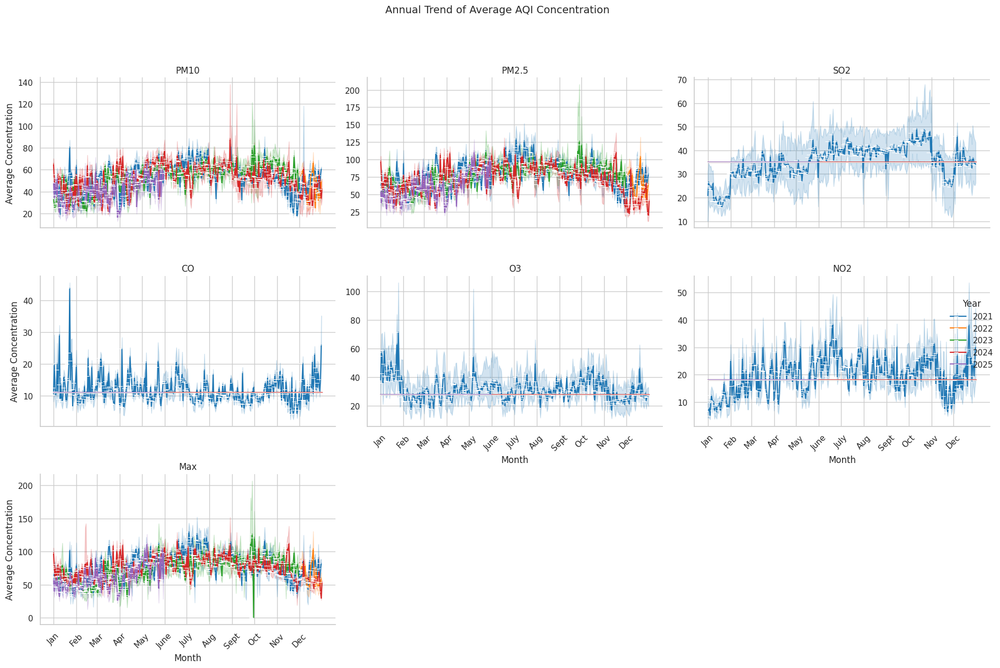

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np


df_all = df_daily_mean_station.copy()

def robust_to_datetime(date_value):
    if pd.isna(date_value):
        return pd.NaT
    try:
        return pd.to_datetime(date_value)
    except:
        try:
            if pd.api.types.is_numeric_dtype(type(date_value)):
                 return pd.to_datetime(date_value, origin='1899-12-30', unit='D', errors='coerce')
            else:
                 return pd.NaT
        except:
            return pd.NaT

df_all['tanggal'] = df_all['tanggal'].apply(robust_to_datetime)
df_all.dropna(subset=['tanggal'], inplace=True)

df_all['Tahun'] = df_all['tanggal'].dt.year
df_all['Hari-Bulan'] = df_all['tanggal'].dt.strftime('%m-%d')

aqi_parameters = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2', 'Max']

aqi_parameters_present = [col for col in aqi_parameters if col in df_all.columns]

df_melted_nasional = df_all.melt(
    id_vars=['Tahun', 'Hari-Bulan'],
    value_vars=aqi_parameters_present,
    var_name='Parameter',
    value_name='Average Concentration'
)

g = sns.FacetGrid(
    df_melted_nasional,
    col='Parameter',
    col_wrap=3,
    height=4,
    aspect=1.5,
    sharey=False
)

g.map_dataframe(
    sns.lineplot,
    x='Hari-Bulan',
    y='Average Concentration',
    hue='Tahun',
    marker=False,
    dashes=False,
    palette='tab10'
)

for ax in g.axes.flatten():
    ax.set_xticks(['01-01', '02-01', '03-01', '04-01', '05-01', '06-01',
                   '07-01', '08-01', '09-01', '10-01', '11-01', '12-01'])
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'June',
                        'July', 'Aug', 'Sept', 'Oct', 'Nov', 'Dec'], rotation=45)

g.set_titles(col_template="{col_name}")
g.set_axis_labels('Month', 'Average Concentration')
g.fig.suptitle('Annual Trend of Average AQI Concentration', fontsize=14, y=1.05)
g.add_legend(title='Year')

plt.tight_layout()
plt.show()

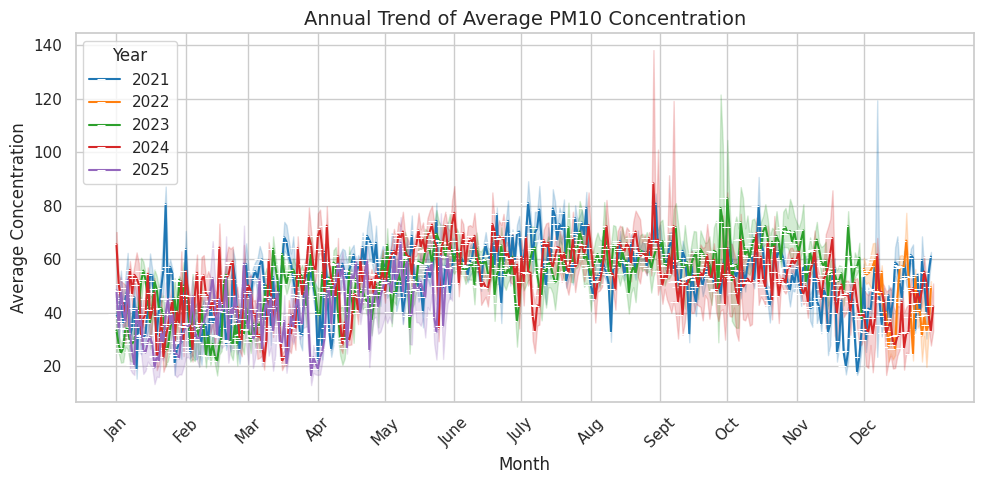

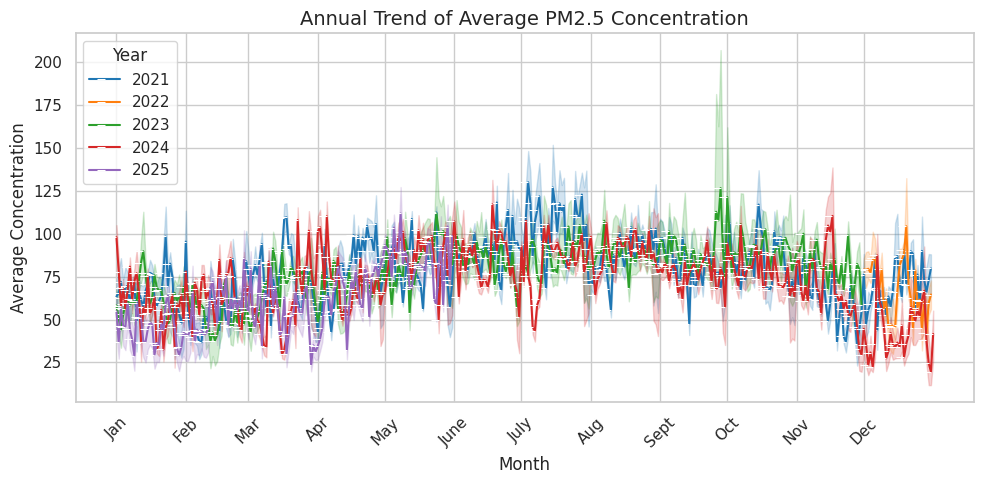

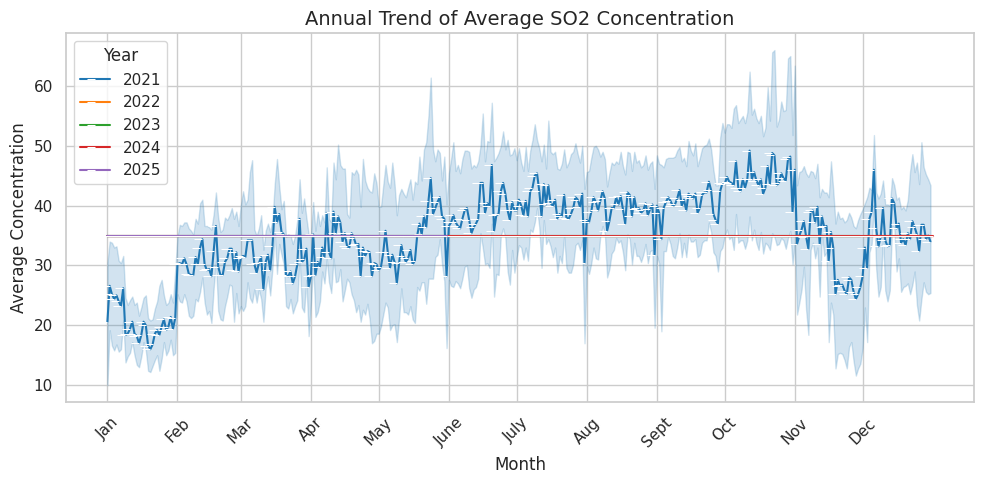

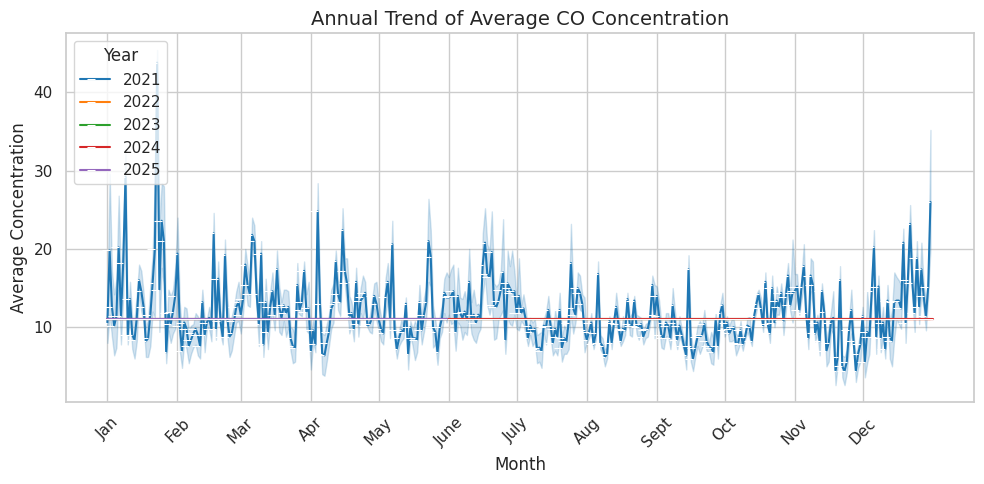

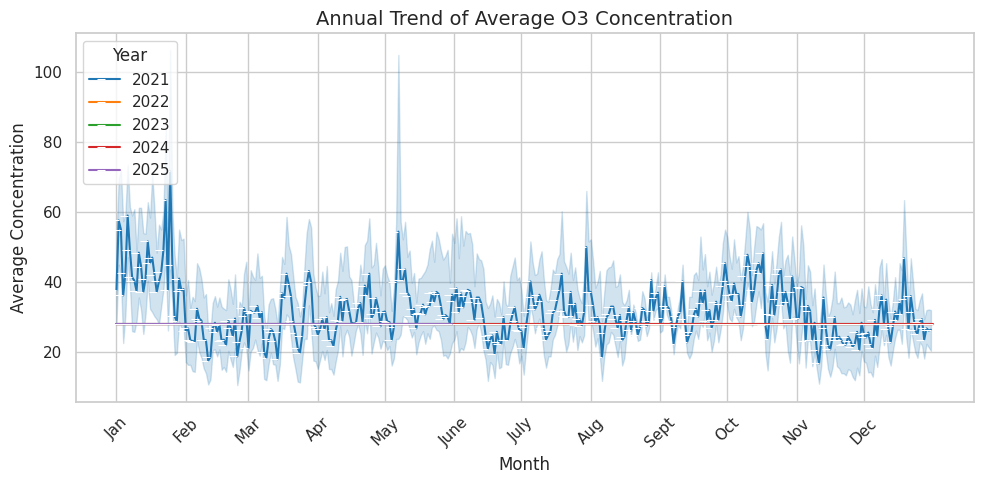

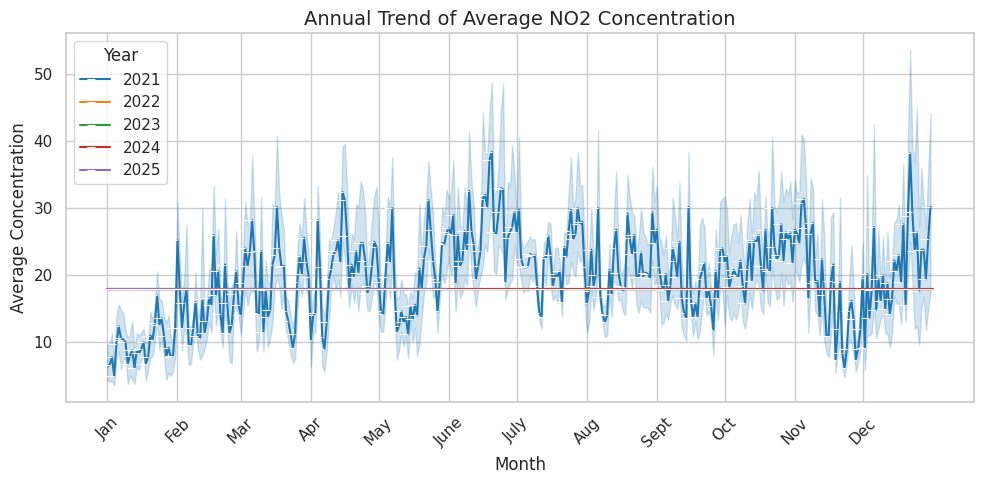

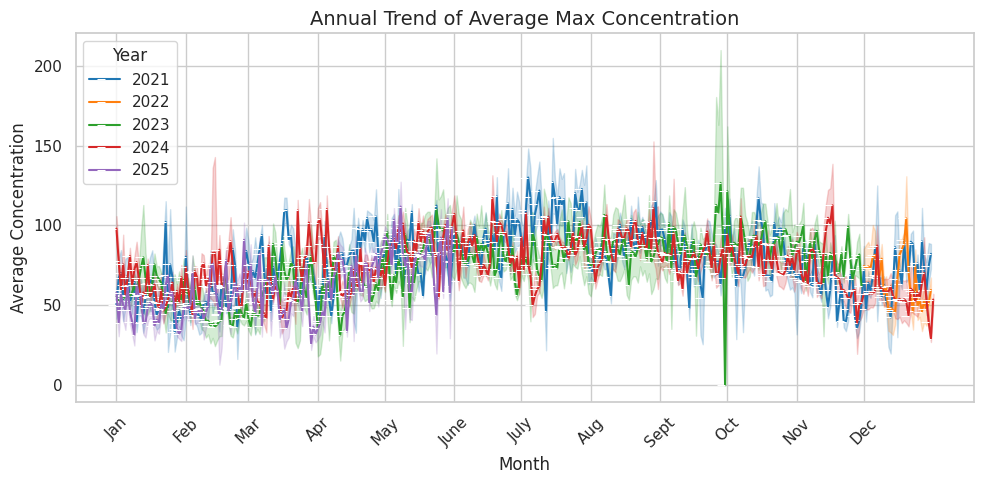

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

aqi_parameters = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2', 'Max']
aqi_parameters_present = [col for col in aqi_parameters if col in df_all.columns]

df_melted_nasional = df_all.melt(
    id_vars=['Tahun', 'Hari-Bulan'],
    value_vars=aqi_parameters_present,
    var_name='Parameter',
    value_name='Average Concentration'
)

for param in df_melted_nasional['Parameter'].unique():
    df_param = df_melted_nasional[df_melted_nasional['Parameter'] == param]

    plt.figure(figsize=(10,5))
    sns.lineplot(
        data=df_param,
        x='Hari-Bulan',
        y='Average Concentration',
        hue='Tahun',
        marker=False,
        dashes=False,
        palette='tab10'
    )

    plt.xticks(
        ticks=['01-01', '02-01', '03-01', '04-01', '05-01', '06-01',
               '07-01', '08-01', '09-01', '10-01', '11-01', '12-01'],
        labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'June',
                'July', 'Aug', 'Sept', 'Oct', 'Nov', 'Dec'],
        rotation=45
    )

    plt.title(f'Annual Trend of Average {param} Concentration', fontsize=14)
    plt.xlabel('Month')
    plt.ylabel('Average Concentration')
    plt.legend(title='Year', loc='upper left')
    plt.tight_layout()
    plt.show()

#### Hourly Trend Interval

In [ ]:
df_hourly_mean_station = df_combined_cleaned.copy()

In [ ]:
df_hourly_mean_station['tanggal'] = pd.to_datetime(df_hourly_mean_station['tanggal'], errors='coerce')
df_hourly_mean_station = df_hourly_mean_station.set_index('tanggal')

In [ ]:
df_hourly_mean_station = df_hourly_mean_station.rename(columns=rename_map)
df_hourly_mean_station = df_hourly_mean_station.loc[:, ~df_hourly_mean_station.columns.duplicated()]

In [ ]:
pollutant_cols = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2']

for col in pollutant_cols:
    if col in df_hourly_mean_station.columns:
        df_hourly_mean_station[col] = pd.to_numeric(
            df_hourly_mean_station[col].replace('-', np.nan),
            errors='coerce'
        )

In [ ]:
print(df_hourly_mean_station.columns.tolist())

['periode_data', 'PM10', 'SO2', 'CO', 'O3', 'NO2', 'Max', 'Critical', 'category', 'station', 'PM2.5', 'bulan', 'Station_grouped']


In [ ]:
import pandas as pd
df_hourly_mean_station.rename(columns={'lokasi_spku_grouped': 'Stasiun'}, inplace=True)
aqi_parameters = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2']

df_melted_1H = df_hourly_mean_station.melt(
    id_vars=['Station_grouped'],
    value_vars=aqi_parameters,
    var_name='Parameter',
    value_name='Rata-rata Konsentrasi'
)

In [ ]:
df_filtered_stations['tanggal'] = pd.to_datetime(df_filtered_stations['tanggal'], errors='coerce')
df_filtered_stations.dropna(subset=['tanggal'], inplace=True)

intervals = ['1H', '8H', '12H', '24H', '48H']
resampled_dict = {}

for interval in intervals:
    df_resampled = (
        df_filtered_stations
        .groupby('station')
        .resample(interval, on='tanggal')[aqi_columns_present]
        .mean()
        .reset_index()
    )
    resampled_dict[interval] = df_resampled

/tmp/ipython-input-1439470434.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  .resample(interval, on='tanggal')[aqi_columns_present]
/tmp/ipython-input-1439470434.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  .resample(interval, on='tanggal')[aqi_columns_present]
/tmp/ipython-input-1439470434.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  .resample(interval, on='tanggal')[aqi_columns_present]
/tmp/ipython-input-1439470434.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  .resample(interval, on='tanggal')[aqi_columns_present]
/tmp/ipython-input-1439470434.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  .resample(interval, on='tanggal')[aqi_columns_present]


##### 1 Hour Trend

In [ ]:
display(resampled_dict['1H'].head())

,station,tanggal,PM10,PM2.5,SO2,CO,O3,NO2,Max
0,DKI1 Bundaran Hotel Indonesia (HI),2024-01-01 00:00:00,64.0,89.0,NaN,NaN,NaN,NaN,89.0
1,DKI1 Bundaran Hotel Indonesia (HI),2024-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,DKI1 Bundaran Hotel Indonesia (HI),2024-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,DKI1 Bundaran Hotel Indonesia (HI),2024-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,DKI1 Bundaran Hotel Indonesia (HI),2024-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##### 8 Hour Trend

In [ ]:
display(resampled_dict['8H'].head())

,station,tanggal,PM10,PM2.5,SO2,CO,O3,NO2,Max
0,DKI1 Bunderan HI,2023-01-01 00:00:00,44.0,55.0,NaN,NaN,NaN,NaN,55.0
1,DKI1 Bunderan HI,2023-01-01 08:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,DKI1 Bunderan HI,2023-01-01 16:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,DKI1 Bunderan HI,2023-01-02 00:00:00,32.0,43.0,NaN,NaN,NaN,NaN,52.0
4,DKI1 Bunderan HI,2023-01-02 08:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##### 12 Hour Trend

In [ ]:
display(resampled_dict['12H'].head())

,station,tanggal,PM10,PM2.5,SO2,CO,O3,NO2,Max
0,DKI1 Bunderan HI,2023-01-01 00:00:00,44.0,55.0,NaN,NaN,NaN,NaN,55.0
1,DKI1 Bunderan HI,2023-01-01 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,DKI1 Bunderan HI,2023-01-02 00:00:00,32.0,43.0,NaN,NaN,NaN,NaN,52.0
3,DKI1 Bunderan HI,2023-01-02 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,DKI1 Bunderan HI,2023-01-03 00:00:00,31.0,35.0,NaN,NaN,NaN,NaN,49.0


##### 24 Hour Trend

In [ ]:
display(resampled_dict['24H'].head())

,station,tanggal,PM10,PM2.5,SO2,CO,O3,NO2,Max
0,DKI1 Bundaran Hotel Indonesia (HI),2024-01-01,64.0,89.0,NaN,NaN,NaN,NaN,89.0
1,DKI1 Bundaran Hotel Indonesia (HI),2024-01-02,53.0,93.0,NaN,NaN,NaN,NaN,93.0
2,DKI1 Bundaran Hotel Indonesia (HI),2024-01-03,52.0,57.0,NaN,NaN,NaN,NaN,57.0
3,DKI1 Bundaran Hotel Indonesia (HI),2024-01-04,30.0,NaN,NaN,NaN,NaN,NaN,112.0
4,DKI1 Bundaran Hotel Indonesia (HI),2024-01-05,22.0,54.0,NaN,NaN,NaN,NaN,54.0


##### 48 Hour Trend

In [ ]:
display(resampled_dict['48H'].head())

,station,tanggal,PM10,PM2.5,SO2,CO,O3,NO2,Max
0,DKI1 Bundaran Hotel Indonesia (HI),2024-01-01,58.5,91.0,NaN,NaN,NaN,NaN,91.0
1,DKI1 Bundaran Hotel Indonesia (HI),2024-01-03,41.0,57.0,NaN,NaN,NaN,NaN,84.5
2,DKI1 Bundaran Hotel Indonesia (HI),2024-01-05,35.5,61.0,NaN,NaN,NaN,NaN,61.0
3,DKI1 Bundaran Hotel Indonesia (HI),2024-01-07,50.5,64.5,NaN,NaN,NaN,NaN,64.5
4,DKI1 Bundaran Hotel Indonesia (HI),2024-01-09,49.5,64.0,NaN,NaN,NaN,NaN,64.0


##### Comparison 1h, 8h, 12h, 24h, 48h AQI Trends

In [ ]:
df_melted = pd.DataFrame()
for interval, df in resampled_dict.items():
    aqi_parameters = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2']
    available_aqi_vars = [v for v in aqi_parameters if v in df.columns]

    df_melted_interval = df.melt(
        id_vars=['station', 'tanggal'],
        value_vars=available_aqi_vars,
        var_name='Parameter',
        value_name='Konsentrasi'
    )
    df_melted_interval['Interval'] = interval
    df_melted = pd.concat([df_melted, df_melted_interval], ignore_index=True)

df_melted['tanggal'] = pd.to_datetime(df_melted['tanggal'], errors='coerce')
df_melted = df_melted.dropna(subset=['tanggal'])

if not df_melted.empty:
    df_melted['elapsed_hours'] = (
        df_melted['tanggal'] - df_melted['tanggal'].min()
    ).dt.total_seconds() / 3600
else:
    print("df_melted is empty after date processing.")

intervals_present = df_melted['Interval'].unique()
print(intervals_present)

['1H' '8H' '12H' '24H' '48H']


In [ ]:
intervals = df_melted['Interval'].unique()

for interval in intervals:
    count = len(df_melted[df_melted['Interval'] == interval])
    print(f"Interval {interval}: {count} rows")

Interval 1H: 1159020 rows
Interval 8H: 144972 rows
Interval 12H: 96684 rows
Interval 24H: 48396 rows
Interval 48H: 24216 rows


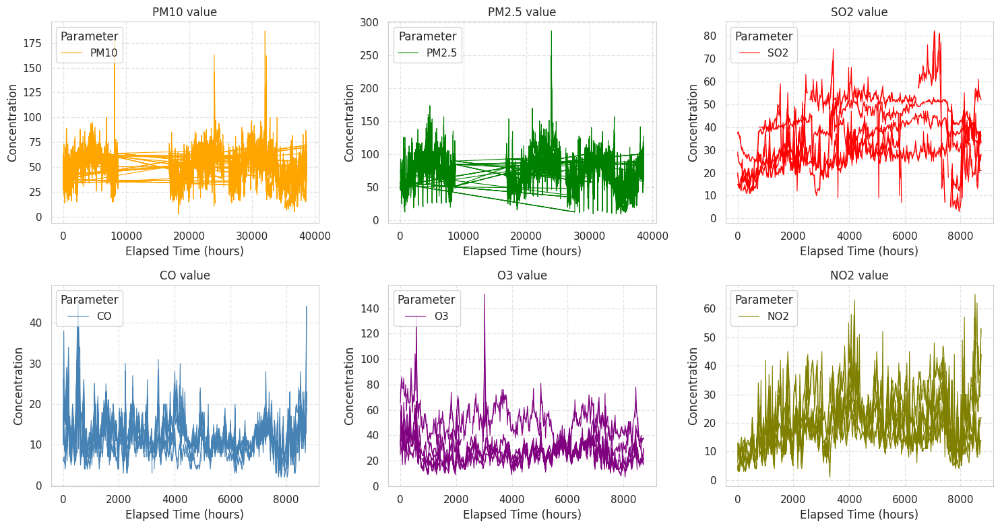

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import math

aqi_colors = {
    'PM10': 'orange',
    'PM2.5': 'green',
    'SO2': 'red',
    'CO': 'steelblue',
    'O3': 'purple',
    'NO2': 'olive'
}

parameters = df_melted['Parameter'].unique()
n_params = len(parameters)

n_cols = 3
n_rows = math.ceil(n_params / n_cols)

intervals_present = df_melted['Interval'].unique()

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4))
axes = axes.flatten()

for i, param in enumerate(parameters):
    ax = axes[i]
    subset_param = df_melted[df_melted['Parameter'] == param]

    for idx, interval in enumerate(intervals_present):
        subset_interval = subset_param[subset_param['Interval'] == interval]
        if not subset_interval.empty:
            label = param if idx == 0 else None
            ax.plot(
                subset_interval['elapsed_hours'],
                subset_interval['Konsentrasi'],
                label=label,
                color=aqi_colors.get(param, 'gray'),
                linewidth=0.8
            )

    ax.set_title(f"{param} value")
    ax.set_xlabel("Elapsed Time (hours)")
    ax.set_ylabel("Concentration")
    ax.legend(title="Parameter", loc='upper left')
    ax.grid(True, linestyle='--', alpha=0.5)

    for spine in ax.spines.values():
        spine.set_edgecolor('#cccccc')
        spine.set_linewidth(0.8)

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

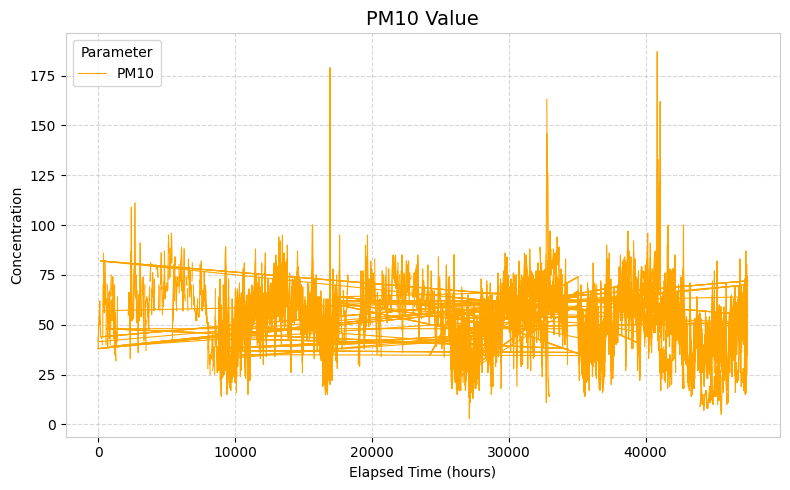

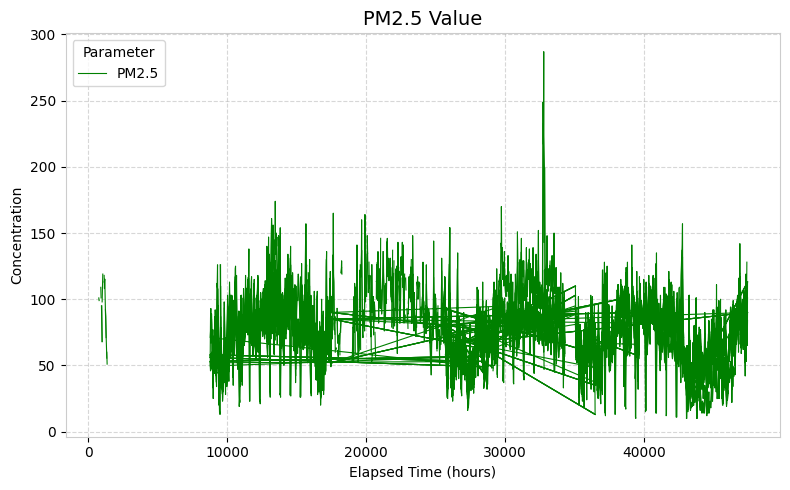

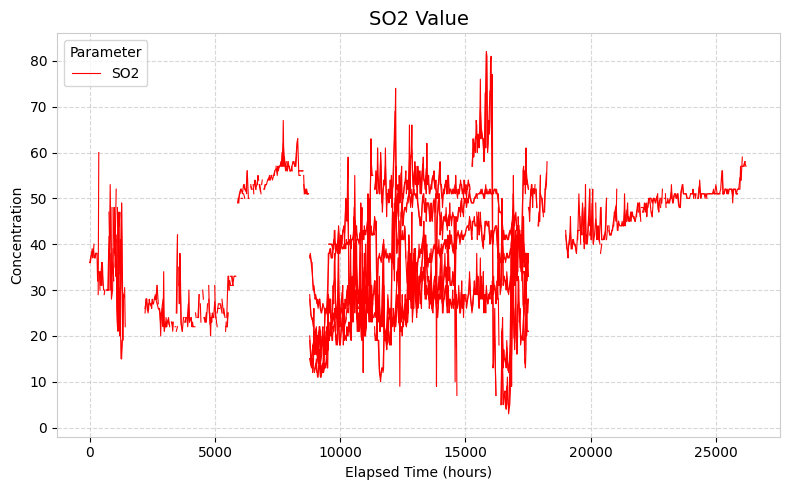

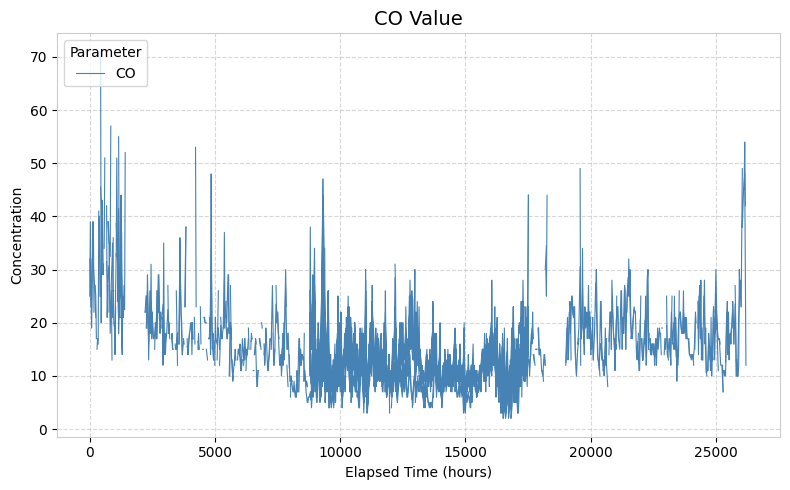

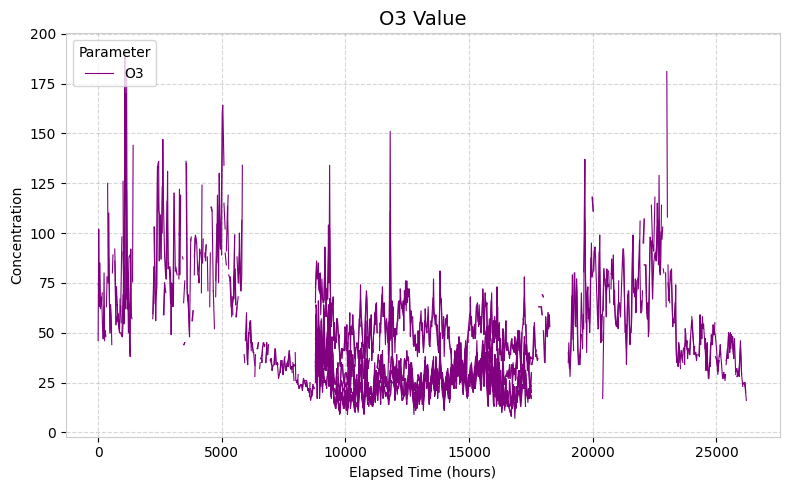

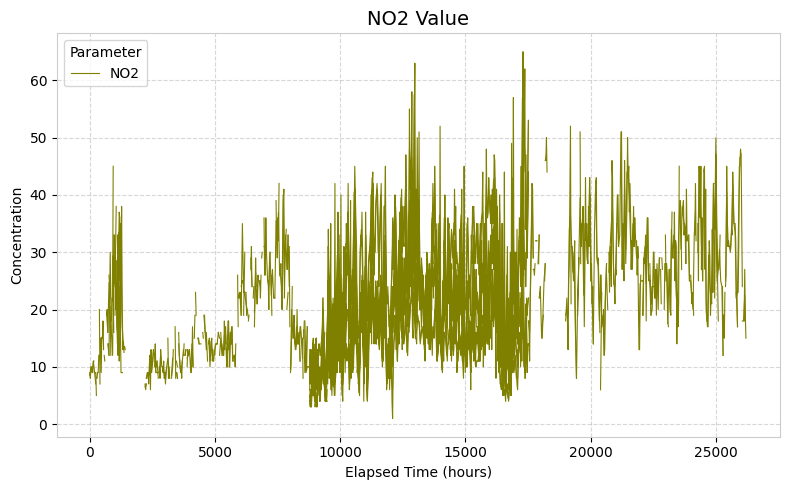

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

aqi_colors = {
    'PM10': 'orange',
    'PM2.5': 'green',
    'SO2': 'red',
    'CO': 'steelblue',
    'O3': 'purple',
    'NO2': 'olive'
}

parameters = df_melted['Parameter'].unique()
intervals_present = df_melted['Interval'].unique()

for param in parameters:
    plt.figure(figsize=(8, 5))
    subset_param = df_melted[df_melted['Parameter'] == param]

    for idx, interval in enumerate(intervals_present):
        subset_interval = subset_param[subset_param['Interval'] == interval]
        if not subset_interval.empty:
            label = param if idx == 0 else None
            plt.plot(
                subset_interval['elapsed_hours'],
                subset_interval['Konsentrasi'],
                label=label,
                color=aqi_colors.get(param, 'lightgray'),
                linewidth=0.8
            )

    plt.title(f"{param} Value", fontsize=14)
    plt.xlabel("Elapsed Time (hours)")
    plt.ylabel("Concentration")
    plt.legend(title="Parameter", loc="upper left")
    plt.grid(True, linestyle="--", alpha=0.5)

    ax = plt.gca()
    for spine in ax.spines.values():
        spine.set_edgecolor('#cccccc')
        spine.set_linewidth(0.8)

    plt.tight_layout()
    plt.show()

#### Peak Concentration Highlight

In [ ]:
import pandas as pd

station_mapping = {
    'DKI1': 'DKI1 - Bunderan HI',
    'DKI1 (Bunderan HI)': 'DKI1 - Bunderan HI',
    'DKI1 Bunderan HI': 'DKI1 - Bunderan HI',
    'DKI1  Bunderan HI ': 'DKI1 - Bunderan HI',
    ' DKI1  Bunderan HI ': 'DKI1 - Bunderan HI',
    'DKI1  Bundaran Hotel Indonesia (HI)': 'DKI1 - Bunderan HI',
    'DKI1 Bundaran Hotel Indonesia (HI)': 'DKI1 - Bunderan HI',
    'DKI2': 'DKI2 - Kelapa Gading',
    'DKI2 (Kelapa Gading)': 'DKI2 - Kelapa Gading',
    'DKI2 Kelapa Gading': 'DKI2 - Kelapa Gading',
    'DKI2  Kelapa Gading ': 'DKI2 - Kelapa Gading',
    ' DKI2  Kelapa Gading  ': 'DKI2 - Kelapa Gading',
    'DKI3': 'DKI3 - Jagakarsa',
    'DKI3 (Jagakarsa)': 'DKI3 - Jagakarsa',
    'DKI3 Jagakarsa': 'DKI3 - Jagakarsa',
    'DKI3  Jagakarsa ': 'DKI3 - Jagakarsa',
    ' DKI3  Jagakarsa  ': 'DKI3 - Jagakarsa',
    'DKI4': 'DKI4 - Lubang Buaya',
    'DKI4 (Lubang Buaya)': 'DKI4 - Lubang Buaya',
    'DKI4 Lubang Buaya': 'DKI4 - Lubang Buaya',
    'DKI4  Lubang Buaya ': 'DKI4 - Lubang Buaya',
    ' DKI4  Lubang Buaya  ': 'DKI4 - Lubang Buaya',
    'DKI5': 'DKI5 - Kebon Jeruk',
    'DKI5 (Kebon Jeruk) Jakarta Barat': 'DKI5 - Kebon Jeruk',
    'DKI5 Kebon Jeruk Jakarta Barat': 'DKI5 - Kebon Jeruk',
    'DKI5 Kebon Jeruk': 'DKI5 - Kebon Jeruk',
    'DKI5  Kebon Jeruk  Jakarta Barat': 'DKI5 - Kebon Jeruk',
}

def standardize_station_name(name):
    name = name.strip()
    return station_mapping.get(name, name)

df_daily_mean_station['station'] = (
    df_daily_mean_station['station'].astype(str).apply(standardize_station_name)
)

df_daily_mean_station['tanggal'] = pd.to_datetime(
    df_daily_mean_station['tanggal'], errors='coerce'
)

aqi_parameters = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2']
peak_aqi_data = {}

for param in aqi_parameters:
    if param in df_daily_mean_station.columns:
        df_daily_mean_station[param] = pd.to_numeric(df_daily_mean_station[param], errors='coerce')
        df_param = df_daily_mean_station.dropna(subset=[param])
        if not df_param.empty:
            max_row = df_param.loc[df_param[param].idxmax()]
            peak_aqi_data[param] = {
                'date': max_row['tanggal'],
                'concentration': max_row[param],
                'station': max_row['station']
            }
        else:
            print(f"Warning: Parameter '{param}' has no non-null values after dropping NaNs.")
    else:
        print(f"Warning: Parameter '{param}' not found in df_daily_mean_station.")

print("Peak AQI Concentration Data:")
for param, data in peak_aqi_data.items():
    print(f"{param}: Date = {data['date'].strftime('%Y-%m-%d')}, "
          f"Concentration = {data['concentration']:.2f}, Station = {data['station']}")


Peak AQI Concentration Data:
PM10: Date = 2024-08-29, Concentration = 187.00, Station = DKI4 - Lubang Buaya
PM2.5: Date = 2023-09-28, Concentration = 287.00, Station = DKI4 - Lubang Buaya
SO2: Date = 2021-10-22, Concentration = 82.00, Station = DKI2 - Kelapa Gading
CO: Date = 2021-01-23, Concentration = 47.00, Station = DKI4 - Lubang Buaya
O3: Date = 2021-05-07, Concentration = 151.00, Station = DKI3 - Jagakarsa
NO2: Date = 2021-12-22, Concentration = 65.00, Station = DKI5 - Kebon Jeruk


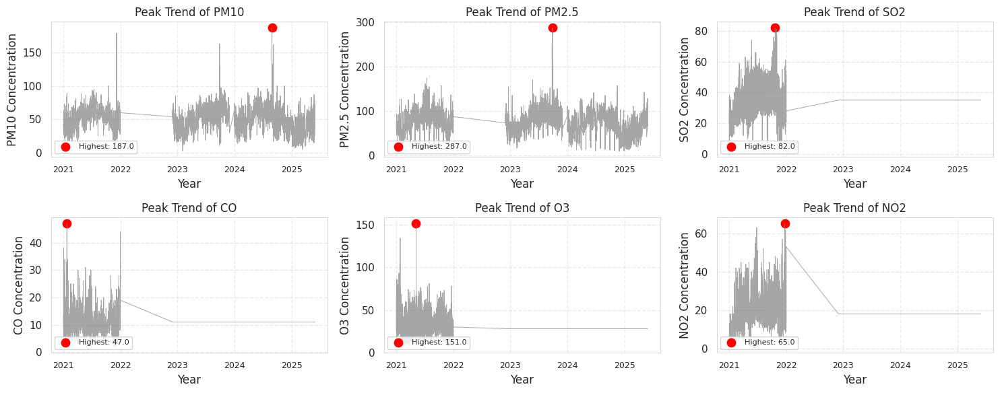

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd

aqi_parameters = ['PM10', 'PM2.5', 'SO2', 'CO', 'O3', 'NO2']
highest_concentration_dates = {}

for param in aqi_parameters:
    if param in df_daily_mean_station.columns:
        df_daily_mean_station[param] = pd.to_numeric(df_daily_mean_station[param], errors='coerce')
        if not df_daily_mean_station[param].isna().all():
            max_row = df_daily_mean_station.loc[df_daily_mean_station[param].idxmax()]
            highest_concentration_dates[param] = {
                'date': max_row['tanggal'],
                'concentration': max_row[param]
            }

params_to_plot = [p for p in aqi_parameters if p in highest_concentration_dates]

n_params = len(params_to_plot)
n_cols = 3
n_rows = (n_params + n_cols - 1) // n_cols if n_params > 0 else 0

if n_rows > 0:
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 3))
    axes = axes.flatten()

    for i, param in enumerate(params_to_plot):
        ax = axes[i]
        ax.plot(df_daily_mean_station['tanggal'], df_daily_mean_station[param],
                color='gray', linestyle='-', linewidth=0.7, alpha=0.7)

        if param in highest_concentration_dates:
            peak_date = highest_concentration_dates[param]['date']
            peak_concentration = highest_concentration_dates[param]['concentration']
            ax.scatter(peak_date, peak_concentration, color='red', s=80,
                       label=f'Highest: {peak_concentration:.1f}')

        ax.set_title(f'Peak Trend of {param}', fontsize=12)
        ax.set_xlabel('Year')
        ax.set_ylabel(f'{param} Concentration')
        ax.grid(True, linestyle='--', alpha=0.4)

        ax.xaxis.set_major_locator(mdates.YearLocator())
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.setp(ax.get_xticklabels(), rotation=0, ha='center', fontsize=9)

        ax.legend(fontsize=8, loc='lower left')

        for spine in ax.spines.values():
            spine.set_linewidth(0.6)
            spine.set_edgecolor('lightgray')

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()
else:
    print("No AQI parameters found to plot peak trends.")

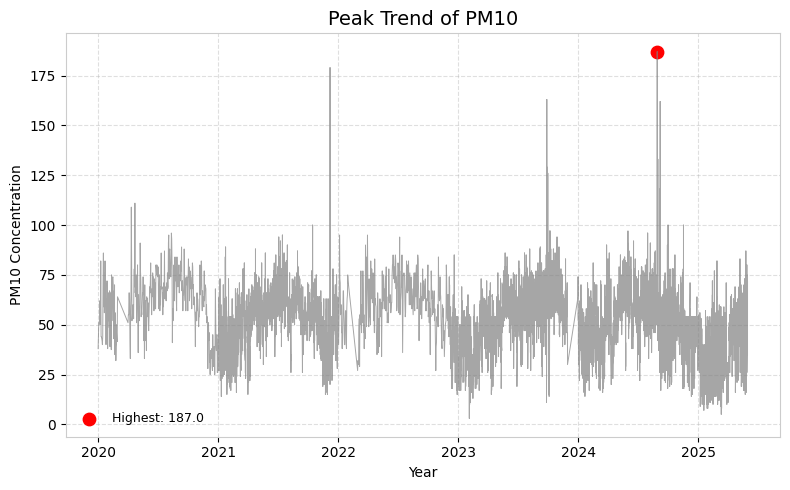

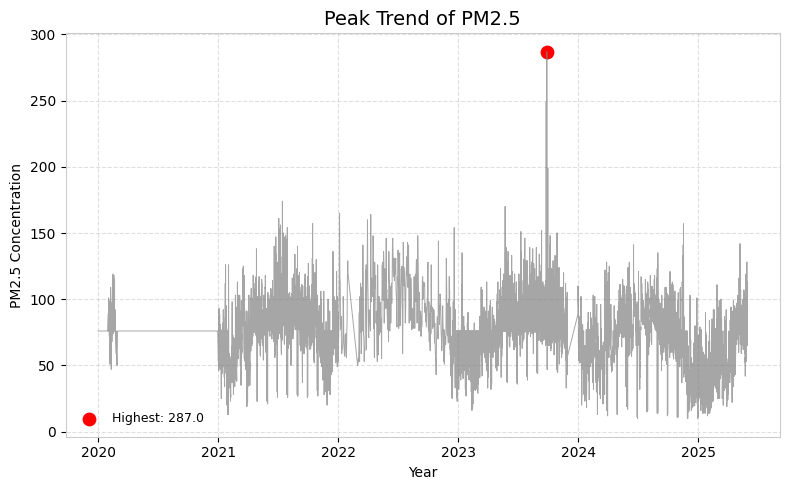

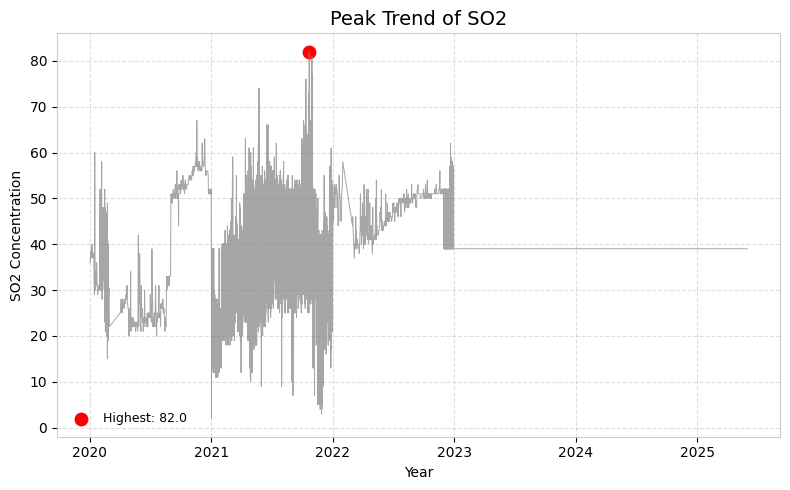

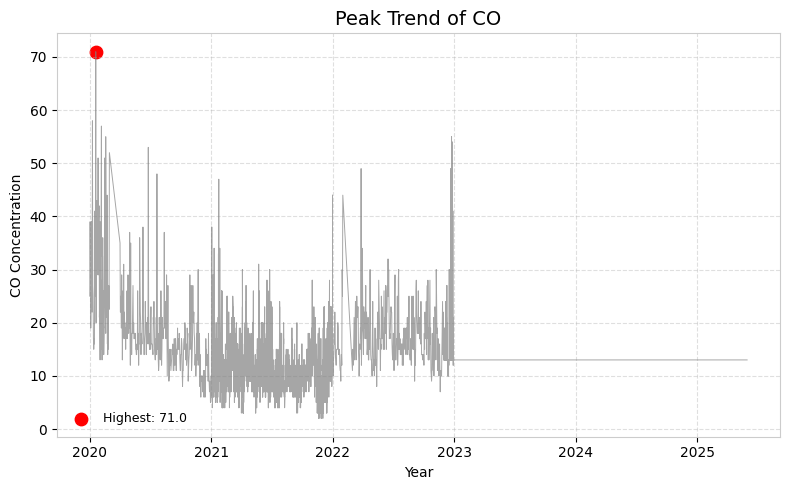

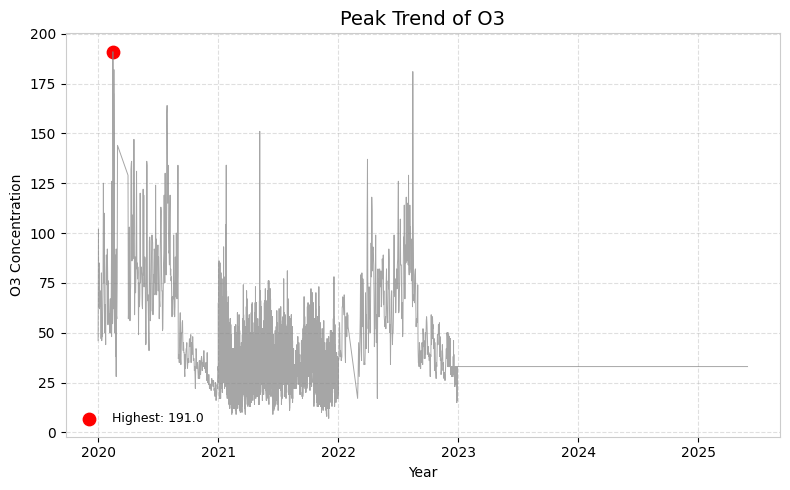

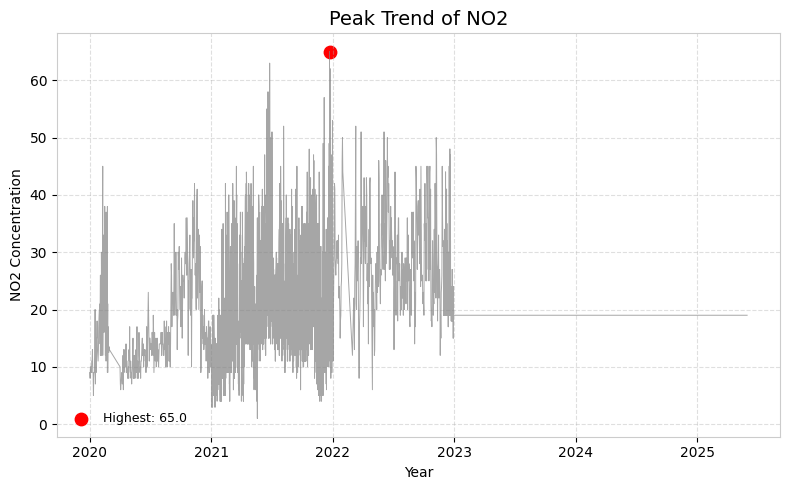

In [ ]:
import matplotlib.dates as mdates

for param in params_to_plot:
    plt.figure(figsize=(8,5))
    plt.plot(df_daily_mean_station['tanggal'], df_daily_mean_station[param],
             color='gray', linestyle='-', linewidth=0.7, alpha=0.7)

    if param in highest_concentration_dates:
        peak_date = highest_concentration_dates[param]['date']
        peak_concentration = highest_concentration_dates[param]['concentration']
        plt.scatter(peak_date, peak_concentration, color='red', s=80,
                    label=f'Highest: {peak_concentration:.1f}')

    plt.title(f'Peak Trend of {param}', fontsize=14)
    plt.xlabel('Year')
    plt.ylabel(f'{param} Concentration')
    plt.grid(True, linestyle='--', alpha=0.4)

    plt.legend(fontsize=9, loc='lower left', frameon=False)

    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())

    for spine in plt.gca().spines.values():
        spine.set_edgecolor('#cccccc')
        spine.set_linewidth(0.8)

    plt.tight_layout()
    plt.show()

# Global Historical Climatology Network-hourly (NOAA Satellite)

The dataset utilized in this study also includes hourly meteorological data, containing variables such as STATION, Station_name, DATE, LATITUDE, LONGITUDE, Elevation, temperature, precipitation_24_hour, remarks, and others. These data are collected from four stations managed by the National Oceanic and Atmospheric Administration (NOAA) of the U.S. Government, namely:

1. IDI0000WIHH – Halim Perdanakusuma Station, East Jakarta
2. IDU096749-1 – Soekarno Hatta Station, Banten
3. IDU096745-1 – Jakarta Observatory
4. IDU096741-1 – Tanjungpriok Station, North Jakarta

This dataset is publicly available as open source at:
https://www.ncei.noaa.gov/access/search/data-search/global-historical-climatology-network-hourly?bbox=-5.834,106.464,-6.596,107.226&page

## Data Understanding

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
import pandas as pd

folder_path = '/content/drive/MyDrive/aqi_data/meteorology'
file_list = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

dataframes = {}
for file_name in file_list:
    df = pd.read_csv(os.path.join(folder_path, file_name))
    dataframes[file_name] = df

/tmp/ipython-input-824928412.py:9: DtypeWarning: Columns (56,72,73,75,77) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(os.path.join(folder_path, file_name))
/tmp/ipython-input-824928412.py:9: DtypeWarning: Columns (56,72,73,75,77,187,189,191) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(os.path.join(folder_path, file_name))
/tmp/ipython-input-824928412.py:9: DtypeWarning: Columns (14,32,56,139,141,143,168,169,171,173,177,179) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(os.path.join(folder_path, file_name))
/tmp/ipython-input-824928412.py:9: DtypeWarning: Columns (45,47,56) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(os.path.join(folder_path, file_name))
/tmp/ipython-input-824928412.py:9: DtypeWarning: Columns (56,78,79,81,83) have mixed types. Specify dtype option on import or set low_memory=Fal

In [ ]:
print(dataframes.keys())

dict_keys(['GHCNh_IDI0000WIHH_2020.csv', 'GHCNh_IDI0000WIHH_2021.csv', 'GHCNh_IDI0000WIHH_2022.csv', 'GHCNh_IDI0000WIHH_2023.csv', 'GHCNh_IDI0000WIHH_2024.csv', 'GHCNh_IDI0000WIHH_2025.csv', 'GHCNh_IDU096741-1_2023.csv', 'GHCNh_IDU096741-1_2024.csv', 'GHCNh_IDU096741-1_2025.csv', 'GHCNh_IDU096745-1_2023.csv', 'GHCNh_IDU096745-1_2024.csv', 'GHCNh_IDU096745-1_2025.csv', 'GHCNh_IDU096749-1_2023.csv', 'GHCNh_IDU096749-1_2024.csv', 'GHCNh_IDU096749-1_2025.csv'])


### Dataframe 2020

#### Halim Perdanakusuma Station (IDI0000WIHH)

In [ ]:
dataframes['GHCNh_IDI0000WIHH_2020.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2020-01-01T00:00:00,-6.2666,106.8911,25.6,25.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET078METAR WIHH 010000Z 27004KT 3000 TSRA FEW...,NaN,F,NaN,223,ICAO-WIHH
1,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2020-01-01T00:30:00,-6.2666,106.8911,25.6,25.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET077METAR WIHH 010030Z 24005KT 3000 TSRA FEW...,NaN,F,NaN,223,ICAO-WIHH
2,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2020-01-01T01:00:00,-6.2666,106.8911,25.6,24.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET078METAR WIHH 010100Z 24005KT 3000 TSRA FEW...,NaN,F,NaN,223,ICAO-WIHH
3,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2020-01-01T02:00:00,-6.2666,106.8911,25.6,25.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET078METAR WIHH 010200Z 27003KT 3000 TSRA FEW...,NaN,F,NaN,223,ICAO-WIHH
4,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2020-01-01T02:30:00,-6.2666,106.8911,25.6,25.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET061METAR WIHH 010230Z 25004KT 4000 -RA BKN0...,NaN,F,NaN,223,ICAO-WIHH


### Dataframe 2021

#### Halim Perdanakusuma Station (IDI0000WIHH)

In [ ]:
dataframes['GHCNh_IDI0000WIHH_2021.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2021-01-01T00:00:00,-6.2666,106.8911,25.6,25.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010000Z 26003KT 6000 FEW020 2...,NaN,F,NaN,223,ICAO-WIHH
1,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2021-01-01T00:30:00,-6.2666,106.8911,25.6,26.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010030Z 27004KT 6000 FEW020 2...,NaN,F,NaN,223,ICAO-WIHH
2,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2021-01-01T01:00:00,-6.2666,106.8911,25.6,27.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010100Z 27006KT 7000 FEW021 2...,NaN,F,NaN,223,ICAO-WIHH
3,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2021-01-01T01:30:00,-6.2666,106.8911,25.6,28.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010130Z 29006KT 7000 SCT019 2...,NaN,F,NaN,223,ICAO-WIHH
4,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2021-01-01T02:00:00,-6.2666,106.8911,25.6,29.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010200Z 28006KT 6000 SCT019 2...,NaN,F,NaN,223,ICAO-WIHH


### Dataframe 2022

#### Halim Perdanakusuma Station (IDI0000WIHH)

In [ ]:
dataframes['GHCNh_IDI0000WIHH_2022.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2022-01-01T00:30:00,-6.2666,106.8911,25.6,27.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010030Z 27004KT 6000 FEW020 2...,NaN,F,NaN,223,ICAO-WIHH
1,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2022-01-01T01:00:00,-6.2666,106.8911,25.6,27.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010100Z 24006KT 7000 FEW022 2...,NaN,F,NaN,223,ICAO-WIHH
2,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2022-01-01T01:30:00,-6.2666,106.8911,25.6,29.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010130Z 23003KT 7000 FEW022 2...,NaN,F,NaN,223,ICAO-WIHH
3,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2022-01-01T02:00:00,-6.2666,106.8911,25.6,29.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010200Z 27003KT 7000 FEW020 2...,NaN,F,NaN,223,ICAO-WIHH
4,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2022-01-01T02:30:00,-6.2666,106.8911,25.6,29.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 010230Z 24003KT 7000 SCT020 2...,NaN,F,NaN,223,ICAO-WIHH


### Dataframe 2023

#### Halim Perdanakusuma Station (IDI0000WIHH)

In [ ]:
dataframes['GHCNh_IDI0000WIHH_2023.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2023-01-02T00:30:00,-6.2666,106.8911,25.6,26.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET063METAR WIHH 020030Z 24006KT 6000 SCT020 2...,NaN,F,NaN,223,ICAO-WIHH
1,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2023-01-02T01:30:00,-6.2666,106.8911,25.6,26.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 020130Z 24010KT 6000 SCT018 2...,NaN,F,NaN,223,ICAO-WIHH
2,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2023-01-02T02:00:00,-6.2666,106.8911,25.6,27.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 020200Z 27005KT 6000 SCT018 2...,NaN,F,NaN,223,ICAO-WIHH
3,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2023-01-02T02:30:00,-6.2666,106.8911,25.6,28.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 020230Z 25005KT 6000 SCT018 2...,NaN,F,NaN,223,ICAO-WIHH
4,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2023-01-02T03:00:00,-6.2666,106.8911,25.6,28.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIHH 020300Z 24005KT 6000 SCT018 2...,NaN,F,NaN,223,ICAO-WIHH


#### Soekarno Hatta Station (IDU096749-1)

In [ ]:
dataframes['GHCNh_IDU096749-1_2023.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDU096749-1,JAKARTA/SOEKARNO-HA,2023-01-01T00:00:00,-6.12,106.65,8.0,25.0,NaN,1.0,FM15-METAR,...,1.0,FM12-SYNOP,223.0,ICAO-WIII,MET095METAR WIII 010000Z VRB04KT 5000 -TSRA FE...,NaN,F,NaN,223,ICAO-WIII
1,IDU096749-1,JAKARTA/SOEKARNO-HA,2023-01-01T00:30:00,-6.12,106.65,8.0,25.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET113METAR WIII 010030Z 22012G22KT 2000 +TSRA...,NaN,F,NaN,223,ICAO-WIII
2,IDU096749-1,JAKARTA/SOEKARNO-HA,2023-01-01T01:00:00,-6.12,106.65,8.0,24.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET112METAR WIII 010100Z VRB09KT 2000 +TSRA FE...,NaN,F,NaN,223,ICAO-WIII
3,IDU096749-1,JAKARTA/SOEKARNO-HA,2023-01-01T01:30:00,-6.12,106.65,8.0,24.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET105METAR WIII 010130Z VRB05KT 2000 TSRA FEW...,NaN,F,NaN,223,ICAO-WIII
4,IDU096749-1,JAKARTA/SOEKARNO-HA,2023-01-01T02:00:00,-6.12,106.65,8.0,25.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET110METAR WIII 010200Z 25004KT 3000 VCTS -RA...,NaN,F,NaN,223,ICAO-WIII


#### Jakarta Observartory (IDU096745-1)

In [ ]:
dataframes['GHCNh_IDU096745-1_2023.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDU096745-1,JAKARTA/OBSERVATORY,2023-01-01T00:00:00,-6.18,106.83,8.0,24.6,NaN,1.0,FM12-SYNOP,...,1.0,FM12-SYNOP,220.0,WMO-96745,SYN11896745 01456 70000 10246 20238 30123 4012...,NaN,F,NaN,220,WMO-96745
1,IDU096745-1,JAKARTA/OBSERVATORY,2023-01-01T03:00:00,-6.18,106.83,8.0,24.4,NaN,1.0,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN10696745 21456 80000 10244 20238 30132 4013...,NaN,F,NaN,220,WMO-96745
2,IDU096745-1,JAKARTA/OBSERVATORY,2023-01-01T06:00:00,-6.18,106.83,8.0,27.2,NaN,1.0,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN08896745 11456 73205 10272 20248 30106 4011...,NaN,F,NaN,220,WMO-96745
3,IDU096745-1,JAKARTA/OBSERVATORY,2023-01-01T09:00:00,-6.18,106.83,8.0,29.4,NaN,1.0,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN08896745 21557 73206 10294 20234 30087 4009...,NaN,F,NaN,220,WMO-96745
4,IDU096745-1,JAKARTA/OBSERVATORY,2023-01-01T12:00:00,-6.18,106.83,8.0,27.8,NaN,1.0,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN09496745 12556 60000 10278 20225 30107 4011...,NaN,F,NaN,220,WMO-96745


#### Tanjungpriok Station (IDU096741-1)

In [ ]:
dataframes['GHCNh_IDU096741-1_2023.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDU096741-1,JAKARTA/TANJUNGPRI,2023-01-01T00:00:00,-6.1,106.87,2.0,24.2,NaN,1,FM12-SYNOP,...,1.0,FM12-SYNOP,220.0,WMO-96741,SYN14296741 01420 82707 10242 20239 30122 4012...,NaN,F,NaN,220,WMO-96741
1,IDU096741-1,JAKARTA/TANJUNGPRI,2023-01-01T03:00:00,-6.1,106.87,2.0,24.0,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN11896741 21430 82009 10240 20237 30128 4013...,NaN,F,NaN,220,WMO-96741
2,IDU096741-1,JAKARTA/TANJUNGPRI,2023-01-01T06:00:00,-6.1,106.87,2.0,26.8,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN10696741 01457 82812 10268 20251 30108 4011...,NaN,F,NaN,220,WMO-96741
3,IDU096741-1,JAKARTA/TANJUNGPRI,2023-01-01T09:00:00,-6.1,106.87,2.0,29.6,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN07096741 32558 72506 10296 20254 30086 4009...,NaN,F,NaN,220,WMO-96741
4,IDU096741-1,JAKARTA/TANJUNGPRI,2023-01-01T12:00:00,-6.1,106.87,2.0,28.0,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN08896741 32450 63104 10280 20243 30105 4010...,NaN,F,NaN,220,WMO-96741


### Dataframe 2024

#### Halim Perdanakusuma Station (IDI0000WIHH)

In [ ]:
dataframes['GHCNh_IDI0000WIHH_2024.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2024-01-01T00:00:00,-6.2666,106.8911,25.6,26.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET060METAR WIHH 010000Z 20003KT 3000 BR SCT02...,NaN,F,NaN,223,ICAO-WIHH
1,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2024-01-01T00:30:00,-6.2666,106.8911,25.6,27.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET060METAR WIHH 010030Z 20004KT 3000 BR SCT02...,NaN,F,NaN,223,ICAO-WIHH
2,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2024-01-01T01:00:00,-6.2666,106.8911,25.6,27.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET060METAR WIHH 010100Z 20004KT 3000 BR SCT02...,NaN,F,NaN,223,ICAO-WIHH
3,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2024-01-01T01:30:00,-6.2666,106.8911,25.6,29.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET060METAR WIHH 010130Z 19003KT 5000 HZ SCT02...,NaN,F,NaN,223,ICAO-WIHH
4,IDI0000WIHH,HALIM PERDANAKUSUMA INTL,2024-01-01T02:00:00,-6.2666,106.8911,25.6,30.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET060METAR WIHH 010200Z 17003KT 5000 HZ FEW02...,NaN,F,NaN,223,ICAO-WIHH


#### Soekarno Hatta Station (IDU096749-1)

In [ ]:
dataframes['GHCNh_IDU096749-1_2024.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDU096749-1,JAKARTA/SOEKARNO-HA,2024-01-01T00:00:00,-6.12,106.65,8.0,27.0,NaN,1.0,FM15-METAR,...,1.0,FM12-SYNOP,223.0,ICAO-WIII,MET078METAR WIII 010000Z 24002KT 6000 FEW019CB...,NaN,F,NaN,223,ICAO-WIII
1,IDU096749-1,JAKARTA/SOEKARNO-HA,2024-01-01T00:30:00,-6.12,106.65,8.0,28.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET083METAR WIII 010030Z 20005KT 7000 VCTS FEW...,NaN,F,NaN,223,ICAO-WIII
2,IDU096749-1,JAKARTA/SOEKARNO-HA,2024-01-01T01:00:00,-6.12,106.65,8.0,28.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIII 010100Z VRB04KT 7000 SCT020 2...,NaN,F,NaN,223,ICAO-WIII
3,IDU096749-1,JAKARTA/SOEKARNO-HA,2024-01-01T01:30:00,-6.12,106.65,8.0,29.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIII 010130Z 19003KT 7000 SCT020 2...,NaN,F,NaN,223,ICAO-WIII
4,IDU096749-1,JAKARTA/SOEKARNO-HA,2024-01-01T02:00:00,-6.12,106.65,8.0,30.0,NaN,1.0,FM15-METAR,...,NaN,NaN,NaN,NaN,MET057METAR WIII 010200Z 13002KT 7000 SCT020 3...,NaN,F,NaN,223,ICAO-WIII


#### Jakarta Observatory (IDU096745-1)

In [ ]:
dataframes['GHCNh_IDU096745-1_2024.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDU096745-1,JAKARTA/OBSERVATORY,2024-01-01T00:00:00,-6.18,106.83,8.0,27.2,NaN,1,FM12-SYNOP,...,1.0,FM12-SYNOP,220.0,WMO-96745,SYN11296745 11556 70000 10272 20245 30097 4010...,NaN,F,NaN,220,WMO-96745
1,IDU096745-1,JAKARTA/OBSERVATORY,2024-01-01T03:00:00,-6.18,106.83,8.0,30.6,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN07696745 32557 60000 10306 20249 30110 4011...,NaN,F,NaN,220,WMO-96745
2,IDU096745-1,JAKARTA/OBSERVATORY,2024-01-01T06:00:00,-6.18,106.83,8.0,31.2,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN07696745 32557 63507 10312 20253 30085 4009...,NaN,F,NaN,220,WMO-96745
3,IDU096745-1,JAKARTA/OBSERVATORY,2024-01-01T09:00:00,-6.18,106.83,8.0,31.0,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN07696745 32557 63506 10310 20251 30074 4007...,NaN,F,NaN,220,WMO-96745
4,IDU096745-1,JAKARTA/OBSERVATORY,2024-01-01T12:00:00,-6.18,106.83,8.0,30.4,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN08896745 32556 60000 10304 20262 30091 4009...,NaN,F,NaN,220,WMO-96745


#### Tanjungpriok Station (IDU096741-1)

In [ ]:
dataframes['GHCNh_IDU096741-1_2024.csv'].head()

,STATION,Station_name,DATE,LATITUDE,LONGITUDE,Elevation,temperature,temperature_Measurement_Code,temperature_Quality_Code,temperature_Report_Type,...,precipitation_24_hour_Quality_Code,precipitation_24_hour_Report_Type,precipitation_24_hour_Source_Code,precipitation_24_hour_Source_Station_ID,remarks,remarks_Measurement_Code,remarks_Quality_Code,remarks_Report_Type,remarks_Source_Code,remarks_Source_Station_ID
0,IDU096741-1,JAKARTA/TANJUNGPRI,2024-01-01T00:00:00,-6.1,106.87,2.0,27.4,NaN,1,FM12-SYNOP,...,1.0,FM12-SYNOP,220.0,WMO-96741,SYN11296741 02557 60000 10274 20250 30096 4010...,NaN,F,NaN,220,WMO-96741
1,IDU096741-1,JAKARTA/TANJUNGPRI,2024-01-01T03:00:00,-6.1,106.87,2.0,30.6,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN07696741 32560 70000 10306 20262 30110 4011...,NaN,F,NaN,220,WMO-96741
2,IDU096741-1,JAKARTA/TANJUNGPRI,2024-01-01T06:00:00,-6.1,106.87,2.0,32.0,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN07696741 32560 63205 10320 20265 30085 4008...,NaN,F,NaN,220,WMO-96741
3,IDU096741-1,JAKARTA/TANJUNGPRI,2024-01-01T09:00:00,-6.1,106.87,2.0,31.4,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN07696741 32560 63305 10314 20267 30074 4007...,NaN,F,NaN,220,WMO-96741
4,IDU096741-1,JAKARTA/TANJUNGPRI,2024-01-01T12:00:00,-6.1,106.87,2.0,30.6,NaN,1,FM12-SYNOP,...,NaN,NaN,NaN,NaN,SYN08896741 32558 50000 10306 20265 30092 4009...,NaN,F,NaN,220,WMO-96741


## Data Preparation

In [ ]:
import pandas as pd
import os

folder_path = '/content/drive/MyDrive/aqi_data/meteorology'
file_list = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

df_list = []
for file_name in file_list:
    file_path = os.path.join(folder_path, file_name)
    df = pd.read_csv(file_path, low_memory=False)
    df.columns = df.columns.str.lower()
    df_list.append(df)

df_all_meteo = pd.concat(df_list, ignore_index=True)

selected_cols = [
    'station',
    'station_name',
    'date',
    'latitude',
    'longitude',
    'elevation',
    'temperature',
    'dew_point_temperature',
    'relative_humidity',
    'wind_speed',
    'wind_direction',
    'precipitation',
    'precipitation_24_hour',
    'sea_level_pressure',
    'visibility'
]

selected_cols_existing = [col for col in selected_cols if col in df_all_meteo.columns]
df_all_meteo = df_all_meteo[selected_cols_existing].copy()


print("\nNaN count before cleaning:")
print(df_all_meteo.isna().sum())

rows_before = len(df_all_meteo)

df_all_meteo = df_all_meteo.dropna(subset=['latitude', 'longitude', 'date'], how='any')

df_all_meteo['date'] = pd.to_datetime(df_all_meteo['date'], errors='coerce')
df_all_meteo = df_all_meteo.dropna(subset=['date'])

num_cols = df_all_meteo.select_dtypes(include=['float64', 'int64']).columns
for col in num_cols:
    median_value = df_all_meteo[col].median()
    df_all_meteo[col] = df_all_meteo[col].fillna(median_value)


print("\nNaN count after cleaning:")
print(df_all_meteo.isna().sum())


rows_after = len(df_all_meteo)
print(f"\nNumber of rows before cleaning: {rows_before}")
print(f"Number of rows after cleaning : {rows_after}")

print("\nCleaned data preview:")
print(df_all_meteo.head())


NaN count before cleaning:
station_name                 0
date                         0
latitude                     0
longitude                    0
elevation                    0
temperature                 29
dew_point_temperature       49
relative_humidity           58
wind_speed                 199
wind_direction            3960
precipitation            99231
precipitation_24_hour    98412
sea_level_pressure       79655
visibility                  54
dtype: int64

NaN count after cleaning:
station_name                 0
date                         0
latitude                     0
longitude                    0
elevation                    0
temperature                  0
dew_point_temperature        0
relative_humidity            0
wind_speed                   0
wind_direction               0
precipitation            99231
precipitation_24_hour        0
sea_level_pressure           0
visibility                   0
dtype: int64

Number of rows before cleaning: 99231
Number of ro

## Exploratory Data Analysis

### Descriptive Summary

#### Data Type

In [ ]:
print("\nDataset info:")
print(df_all_meteo.info())


Dataset info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99231 entries, 0 to 99230
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   station_name           99231 non-null  object        
 1   date                   99231 non-null  datetime64[ns]
 2   latitude               99231 non-null  float64       
 3   longitude              99231 non-null  float64       
 4   elevation              99231 non-null  float64       
 5   temperature            99231 non-null  float64       
 6   dew_point_temperature  99231 non-null  float64       
 7   relative_humidity      99231 non-null  float64       
 8   wind_speed             99231 non-null  float64       
 9   wind_direction         99231 non-null  float64       
 10  precipitation          0 non-null      float64       
 11  precipitation_24_hour  99231 non-null  float64       
 12  sea_level_pressure     99231 non-null  float6

#### Data Analysis

##### Numerical Data

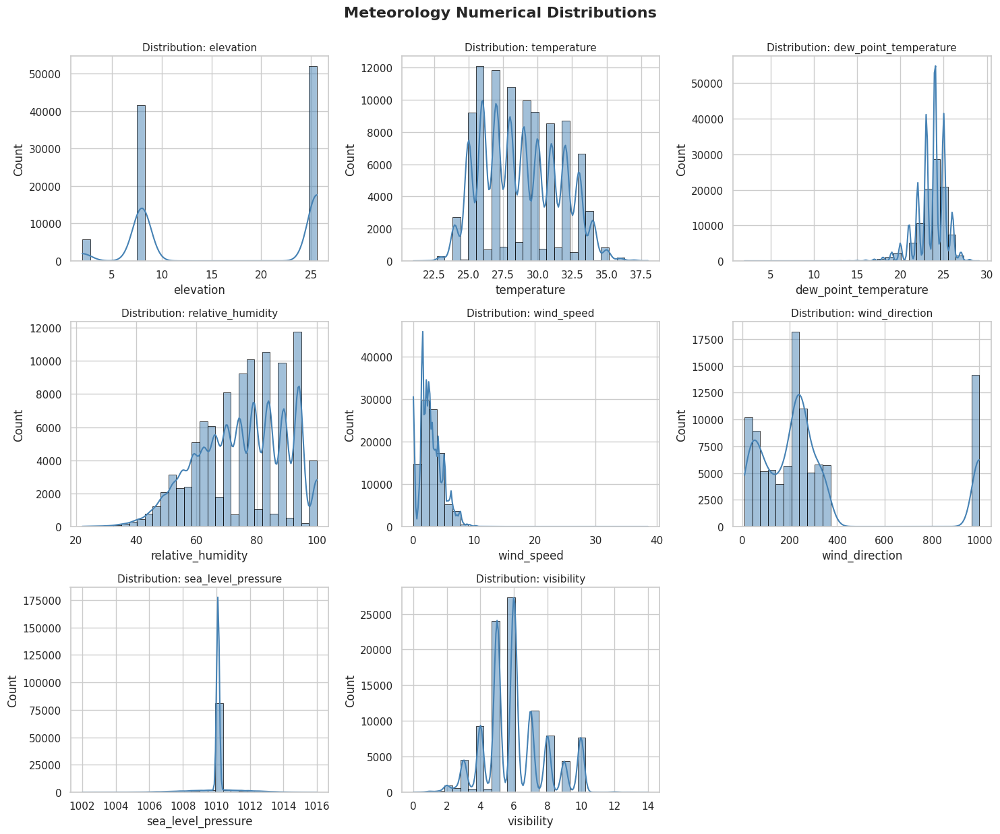

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

drop_cols = ['precipitation', 'precipitation_24_hour', 'longitude', 'latitude']

numerical_features_meteo = [
    col for col in df_all_meteo.select_dtypes(include=['float64', 'int64']).columns
    if col not in drop_cols
]

def plot_numerical_meteo(df, numerical_features, main_title="Meteorology Numerical Distributions", color='steelblue'):
    sns.set(style='whitegrid')

    num_cols = len(numerical_features)
    n_cols = 3 if num_cols >= 3 else num_cols
    n_rows = -(-num_cols // n_cols)

    plt.figure(figsize=(5 * n_cols, 4 * n_rows))

    for i, col in enumerate(numerical_features):
        plt.subplot(n_rows, n_cols, i + 1)
        if col in df.columns:
            sns.histplot(
                df[col].dropna(),
                kde=True,
                bins=30,
                color=color,
                edgecolor='black',
                linewidth=0.5
            )
            plt.title(f'Distribution: {col}', fontsize=11)
            plt.xlabel(col)
            plt.ylabel('Count')
        else:
            plt.title(f'{col} not found', fontsize=10)
            plt.axis('off')

    plt.tight_layout()
    plt.suptitle(main_title, fontsize=16, fontweight='bold', y=1.03)
    plt.show()

plot_numerical_meteo(df_all_meteo, numerical_features_meteo, main_title='Meteorology Numerical Distributions', color='steelblue')

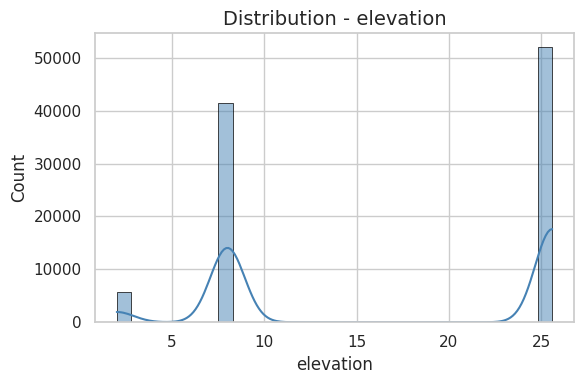

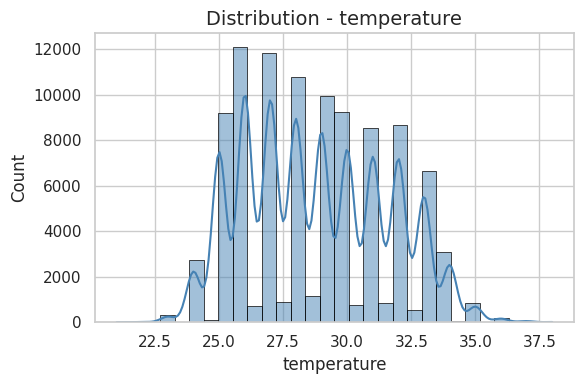

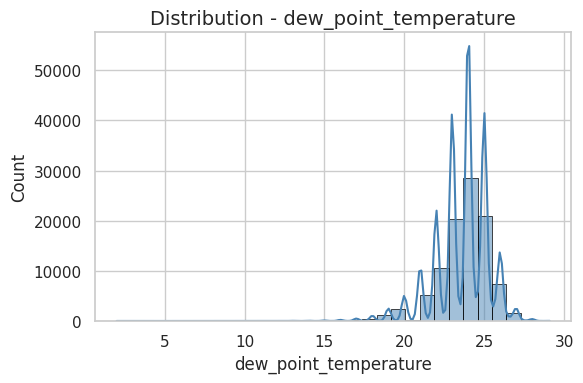

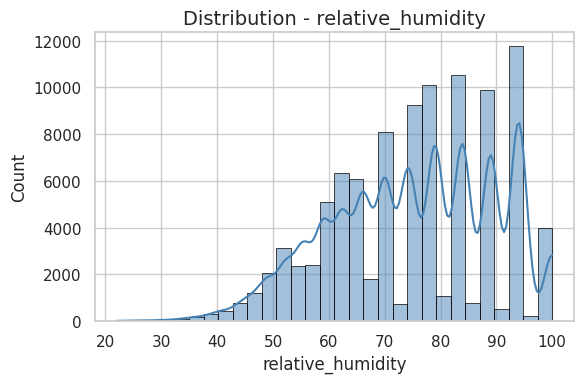

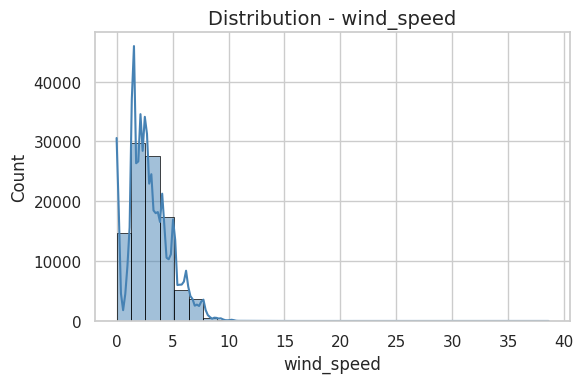

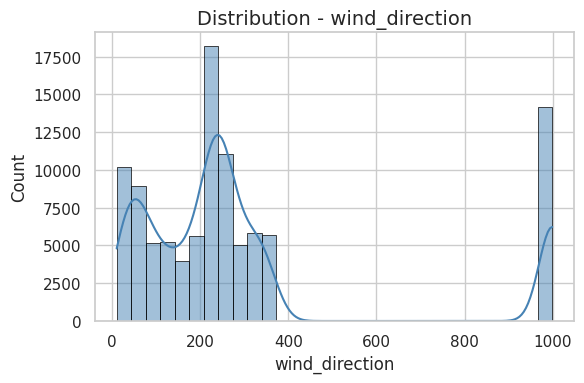

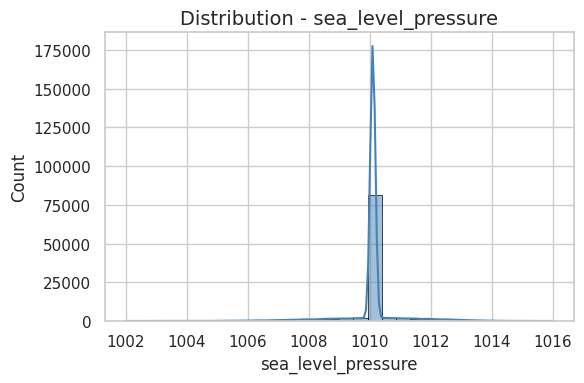

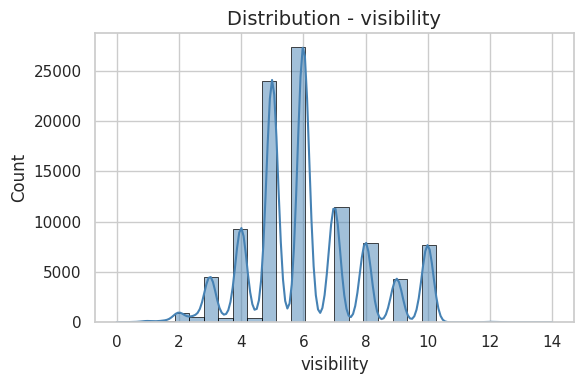

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

drop_cols = ['precipitation', 'precipitation_24_hour', 'longitude', 'latitude']

numerical_features_meteo = [
    col for col in df_all_meteo.select_dtypes(include=['float64', 'int64']).columns
    if col not in drop_cols
]

def plot_numerical_meteo_onebyone(df, numerical_features, main_title="Distribution", color='steelblue'):
    sns.set(style='whitegrid')

    for col in numerical_features:
        if col in df.columns:
            plt.figure(figsize=(6, 4))
            sns.histplot(
                df[col].dropna(),
                kde=True,
                bins=30,
                color=color,
                edgecolor='black',
                linewidth=0.5
            )
            plt.title(f'{main_title} - {col}', fontsize=14)
            plt.xlabel(col)
            plt.ylabel('Count')

            plt.tight_layout()
            plt.show()
        else:
            print(f"Column {col} not found in DataFrame")

plot_numerical_meteo_onebyone(
    df_all_meteo,
    numerical_features_meteo,
    main_title='Distribution',
    color='steelblue'
)

##### Categorical Data

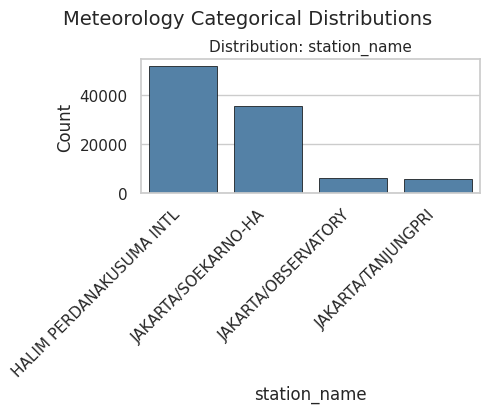

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

categorical_features_meteo = ['station_name']

def plot_categorical_meteo(df, categorical_features, main_title="Meteorology Categorical Distributions", color='steelblue'):
    sns.set(style='whitegrid')

    num_cols = len(categorical_features)
    n_cols = 3 if num_cols >= 3 else num_cols
    n_rows = -(-num_cols // n_cols)

    plt.figure(figsize=(5 * n_cols, 4 * n_rows))

    for i, col in enumerate(categorical_features):
        plt.subplot(n_rows, n_cols, i + 1)
        if col in df.columns:
            order = df[col].value_counts().index
            sns.countplot(
                data=df,
                x=col,
                order=order,
                color=color,
                edgecolor='black',
                linewidth=0.5
            )
            plt.title(f'Distribution: {col}', fontsize=11)
            plt.xlabel(col)
            plt.ylabel('Count')
            plt.xticks(rotation=45, ha='right')
        else:
            plt.title(f'{col} not found', fontsize=10)
            plt.axis('off')

    plt.tight_layout()
    plt.suptitle(main_title, fontsize=14,  y=1.03)
    plt.show()

plot_categorical_meteo(df_all_meteo, categorical_features_meteo, main_title='Meteorology Categorical Distributions', color='steelblue')

#### Statistic Descriptive

In [ ]:
print("\nDescriptive statistics:")
print(df_all_meteo.describe())


Descriptive statistics:
                                date      latitude     longitude  \
count                          99231  99231.000000  99231.000000   
mean   2023-05-02 03:41:50.139371776     -6.199217    106.799675   
min              2020-01-01 00:00:00     -6.266600    106.650000   
25%              2022-09-09 07:45:00     -6.266600    106.650000   
50%              2023-09-17 08:00:00     -6.266600    106.891100   
75%              2024-05-20 10:30:00     -6.120000    106.891100   
max              2025-01-19 21:30:00     -6.100000    106.891100   
std                              NaN      0.072271      0.112988   

          elevation   temperature  dew_point_temperature  relative_humidity  \
count  99231.000000  99231.000000           99231.000000       99231.000000   
mean      16.877000     28.794741              23.629165          75.248037   
min        2.000000     21.000000               2.000000          22.000000   
25%        8.000000     26.400000             

### Spatial Trends


#### Station Geographical Distribution of Peak AQI & Meteorolical Factors

In [ ]:
!pip install geopandas contextily rtree

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 507.6/507.6 kB 13.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.3/22.3 MB 89.5 MB/s eta 0:00:00


/tmp/ipython-input-1746359770.py:17: FutureWarning: You are adding a column named 'geometry' to a GeoDataFrame constructed without an active geometry column. Currently, this automatically sets the active geometry column to 'geometry' but in the future that will no longer happen. Instead, either provide geometry to the GeoDataFrame constructor (GeoDataFrame(... geometry=GeoSeries()) or use `set_geometry('geometry')` to explicitly set the active geometry column.
  gdf_aqi['geometry'] = gdf_aqi.apply(lambda row: Point(row['Lon'], row['Lat']), axis=1)
/tmp/ipython-input-1746359770.py:28: FutureWarning: You are adding a column named 'geometry' to a GeoDataFrame constructed without an active geometry column. Currently, this automatically sets the active geometry column to 'geometry' but in the future that will no longer happen. Instead, either provide geometry to the GeoDataFrame constructor (GeoDataFrame(... geometry=GeoSeries()) or use `set_geometry('geometry')` to explicitly set the activ

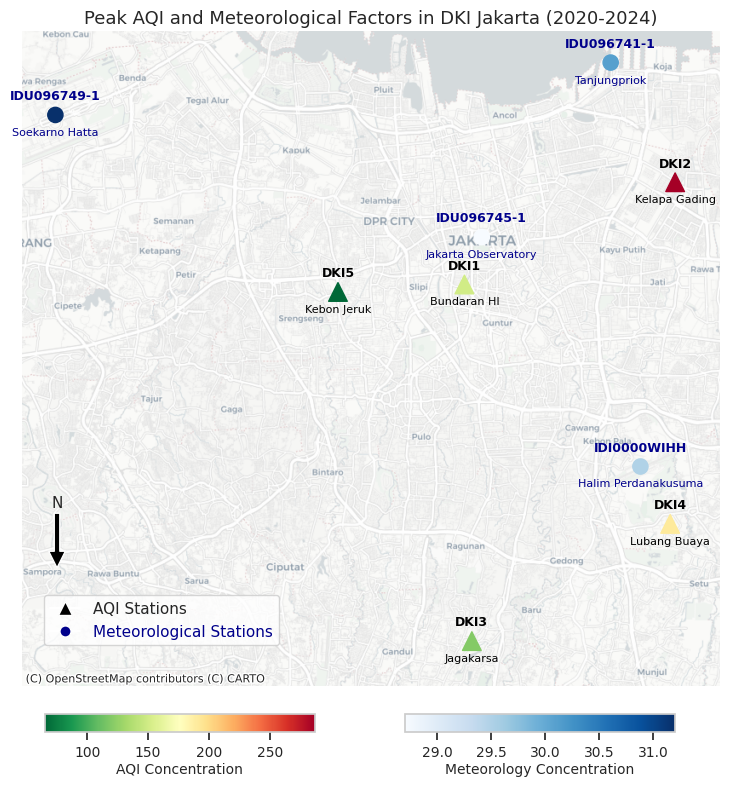

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import contextily as ctx
from scipy.interpolate import griddata
from matplotlib.lines import Line2D

aqi_data = [
    ('DKI1', 'Bundaran HI', -6.193, 106.820, 150),
    ('DKI2', 'Kelapa Gading', -6.152, 106.905, 287),
    ('DKI3', 'Jagakarsa', -6.336, 106.823, 120),
    ('DKI4', 'Lubang Buaya', -6.289, 106.903, 191),
    ('DKI5', 'Kebon Jeruk', -6.196, 106.769, 65)
]
gdf_aqi = gpd.GeoDataFrame(aqi_data, columns=['ID', 'Name', 'Lat', 'Lon', 'PeakValue'])
gdf_aqi['geometry'] = gdf_aqi.apply(lambda row: Point(row['Lon'], row['Lat']), axis=1)
gdf_aqi.set_crs(epsg=4326, inplace=True)
gdf_aqi = gdf_aqi.to_crs(epsg=3857)

meteo_data = [
    ('IDI0000WIHH', 'Halim Perdanakusuma', -6.266, 106.891, 29.5),
    ('IDU096749-1', 'Soekarno Hatta', -6.125, 106.655, 31.2),
    ('IDU096745-1', 'Jakarta Observatory', -6.174, 106.827, 28.7),
    ('IDU096741-1', 'Tanjungpriok', -6.104, 106.879, 30.1)
]
gdf_meteo = gpd.GeoDataFrame(meteo_data, columns=['ID', 'Name', 'Lat', 'Lon', 'PeakValue'])
gdf_meteo['geometry'] = gdf_meteo.apply(lambda row: Point(row['Lon'], row['Lat']), axis=1)
gdf_meteo.set_crs(epsg=4326, inplace=True)
gdf_meteo = gdf_meteo.to_crs(epsg=3857)

x = gdf_aqi.geometry.x.values
y = gdf_aqi.geometry.y.values
z = gdf_aqi["PeakValue"].values

grid_x, grid_y = np.mgrid[x.min()-2000:x.max()+2000:500j, y.min()-2000:y.max()+2000:500j]
grid_z = griddata((x, y), z, (grid_x, grid_y), method='cubic')

fig, ax = plt.subplots(figsize=(9, 9))

ax.imshow(
    grid_z.T,
    extent=(x.min()-2000, x.max()+2000, y.min()-2000, y.max()+2000),
    origin='lower',
    cmap="RdYlGn_r",
    alpha=0.55
)

sc_aqi = ax.scatter(
    gdf_aqi.geometry.x,
    gdf_aqi.geometry.y,
    c=gdf_aqi["PeakValue"],
    cmap="RdYlGn_r",
    s=180,
    marker="^",
    zorder=3
)

sc_meteo = ax.scatter(
    gdf_meteo.geometry.x,
    gdf_meteo.geometry.y,
    c=gdf_meteo["PeakValue"],
    cmap="Blues",
    s=120,
    marker="o",
    zorder=3
)

for x0, y0, code, name in zip(gdf_aqi.geometry.x, gdf_aqi.geometry.y, gdf_aqi["ID"], gdf_aqi["Name"]):
    ax.text(x0, y0+700, code, fontsize=9, weight="bold", color="black", ha="center")
    ax.text(x0, y0-900, name, fontsize=8, color="black", ha="center")

for x0, y0, code, name in zip(gdf_meteo.geometry.x, gdf_meteo.geometry.y, gdf_meteo["ID"], gdf_meteo["Name"]):
    ax.text(x0, y0+700, code, fontsize=9, weight="bold", color="darkblue", ha="center")
    ax.text(x0, y0-900, name, fontsize=8, color="darkblue", ha="center")

legend_elements = [
    Line2D([0], [0], marker='^', color='w', markerfacecolor='black',
           markersize=10, label='AQI Stations'),
    Line2D([0], [0], marker='o', color='w', markerfacecolor='darkblue',
           markersize=8, label='Meteorological Stations')
]
legend = ax.legend(handles=legend_elements, loc="lower left", frameon=True, bbox_to_anchor=(0.02, 0.05))
for text in legend.get_texts():
    if "Meteorological" in text.get_text():
        text.set_color("darkblue")

ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

ax.set_title("Peak AQI and Meteorological Factors in DKI Jakarta (2020-2024)", fontsize=13)
ax.axis("off")

cax1 = fig.add_axes([0.15, 0.08, 0.3, 0.02])
cbar_aqi = fig.colorbar(sc_aqi, cax=cax1, orientation="horizontal")
cbar_aqi.set_label("AQI Concentration", fontsize=10, labelpad=2, ha="center")
cbar_aqi.ax.tick_params(labelsize=10)

cax2 = fig.add_axes([0.55, 0.08, 0.3, 0.02])
cbar_meteo = fig.colorbar(sc_meteo, cax=cax2, orientation="horizontal")
cbar_meteo.set_label("Meteorology Concentration", fontsize=10, labelpad=2, ha="center")
cbar_meteo.ax.tick_params(labelsize=10)

ax.annotate('N', xy=(0.05, 0.18), xytext=(0.05, 0.28),
            arrowprops=dict(facecolor='black', width=4, headwidth=12),
            ha='center', va='center', fontsize=11,
            xycoords=ax.transAxes)

plt.show()

#### Annual Trends

In [ ]:
import pandas as pd

df_meteo_annual = df_all_meteo.copy()

df_meteo_annual['date'] = pd.to_datetime(df_meteo_annual['date'], errors='coerce')

df_meteo_annual['year'] = df_meteo_annual['date'].dt.year

meteo_parameters = [
    'elevation',
    'temperature',
    'dew_point_temperature',
    'relative_humidity',
    'wind_speed',
    'wind_direction',
    'precipitation',
    'precipitation_24_hour',
    'sea_level_pressure',
    'visibility'
]

df_annual_mean = (
    df_meteo_annual
    .groupby(['station_name', 'year'])[meteo_parameters]
    .mean()
    .reset_index()
)

print(df_annual_mean.head())

               station_name  year  elevation  temperature  \
0  HALIM PERDANAKUSUMA INTL  2020       25.6    28.953202   
1  HALIM PERDANAKUSUMA INTL  2021       25.6    28.517369   
2  HALIM PERDANAKUSUMA INTL  2022       25.6    29.004627   
3  HALIM PERDANAKUSUMA INTL  2023       25.6    29.391009   
4  HALIM PERDANAKUSUMA INTL  2024       25.6    28.950453   

   dew_point_temperature  relative_humidity  wind_speed  wind_direction  \
0              23.044469          72.362578    2.927685      181.566954   
1              23.362465          75.320505    2.593278      191.721794   
2              23.692482          74.589640    2.803445      223.945185   
3              22.872539          69.990765    2.856543      232.015595   
4              23.476011          74.104940    2.765745      269.684466   

   precipitation  precipitation_24_hour  sea_level_pressure  visibility  
0            NaN                    4.0              1010.1    4.916633  
1            NaN                  

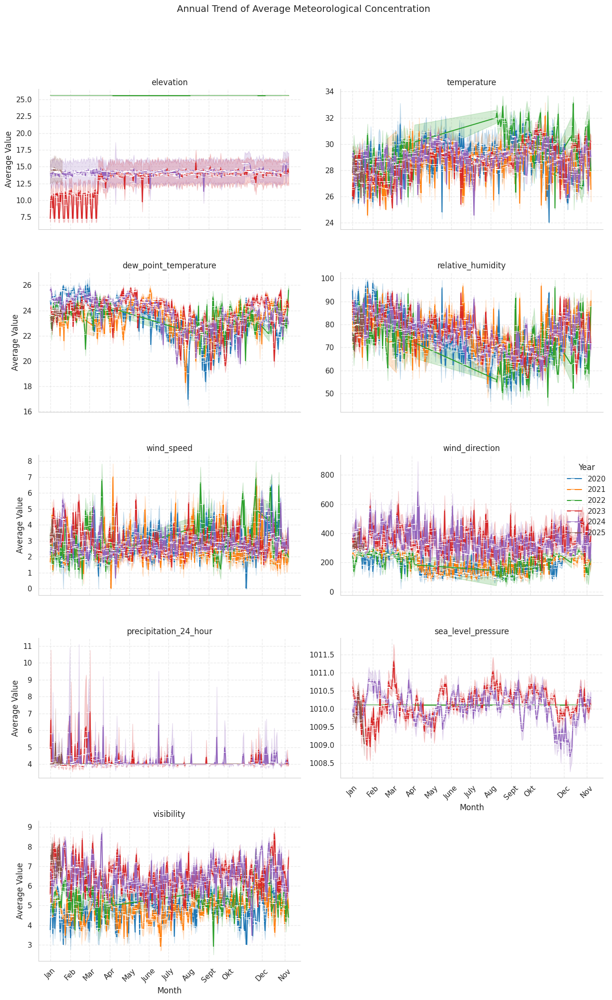

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

df_meteo_all = df_all_meteo.copy()

def robust_to_datetime(date_value):
    if pd.isna(date_value):
        return pd.NaT
    try:
        return pd.to_datetime(date_value)
    except:
        try:
            if pd.api.types.is_numeric_dtype(type(date_value)):
                return pd.to_datetime(date_value, origin='1899-12-30', unit='D', errors='coerce')
            else:
                return pd.NaT
        except:
            return pd.NaT

df_meteo_all['date'] = df_meteo_all['date'].apply(robust_to_datetime)
df_meteo_all.dropna(subset=['date'], inplace=True)

meteo_params = [
    'elevation',
    'temperature',
    'dew_point_temperature',
    'relative_humidity',
    'wind_speed',
    'wind_direction',
    'precipitation_24_hour',
    'sea_level_pressure',
    'visibility'
]
meteo_params_present = [p for p in meteo_params if p in df_meteo_all.columns]

for col in meteo_params_present:
    df_meteo_all[col] = pd.to_numeric(df_meteo_all[col], errors='coerce')

df_meteo_all[meteo_params_present] = df_meteo_all[meteo_params_present].fillna(
    df_meteo_all[meteo_params_present].median()
)

df_annual_mean = (
    df_meteo_all.groupby(['date', 'station_name'])[meteo_params_present]
    .mean()
    .reset_index()
)

df_annual_mean['Tahun'] = df_annual_mean['date'].dt.year
df_annual_mean['Hari-Bulan'] = df_annual_mean['date'].dt.strftime('%m-%d')

df_melted_meteo = df_annual_mean.melt(
    id_vars=['Tahun', 'Hari-Bulan', 'station_name'],
    value_vars=meteo_params_present,
    var_name='Parameter',
    value_name='Average Value'
)

g = sns.FacetGrid(
    df_melted_meteo,
    col='Parameter',
    col_wrap=2,
    height=4,
    aspect=1.5,
    sharey=False
)

g.map_dataframe(
    sns.lineplot,
    x='Hari-Bulan',
    y='Average Value',
    hue='Tahun',
    marker=False,
    dashes=False,
    palette='tab10'
)

for ax in g.axes.flatten():
    ax.set_xticks(['01-01', '02-01', '03-01', '04-01', '05-01', '06-01',
                   '07-01', '08-01', '09-01', '10-01', '11-01', '12-01'])
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'June',
                        'July', 'Aug', 'Sept', 'Okt', 'Nov', 'Dec'], rotation=45)
    ax.grid(True, linestyle='--', alpha=0.4)

    for spine in ax.spines.values():
        spine.set_edgecolor('#cccccc')
        spine.set_linewidth(0.8)

g.set_titles(col_template="{col_name}")
g.set_axis_labels('Month', 'Average Value')
g.fig.suptitle('Annual Trend of Average Meteorological Concentration', fontsize=14, y=1.05)
g.add_legend(title='Year')

plt.tight_layout()
plt.show()

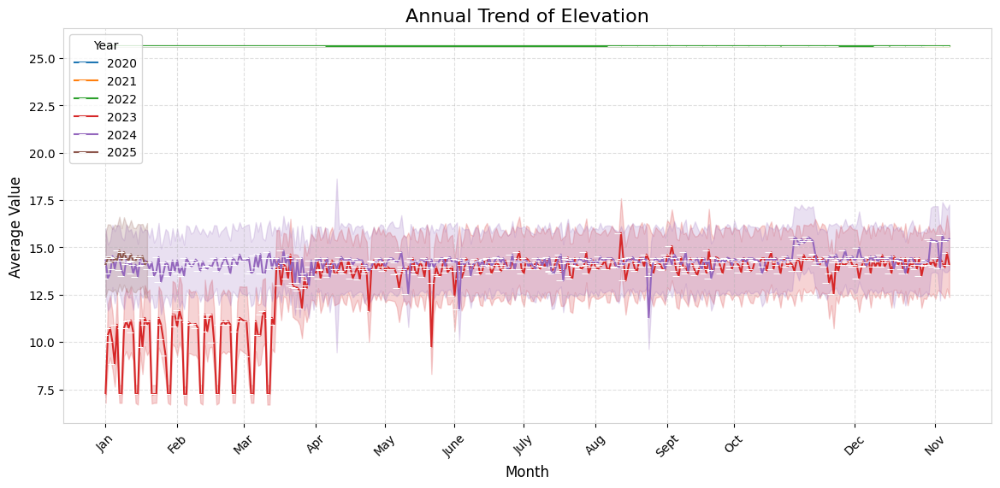

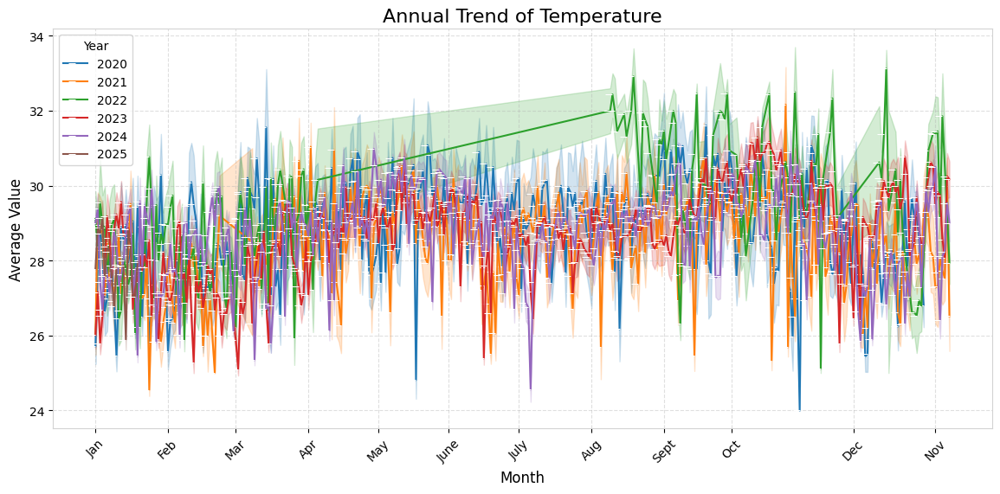

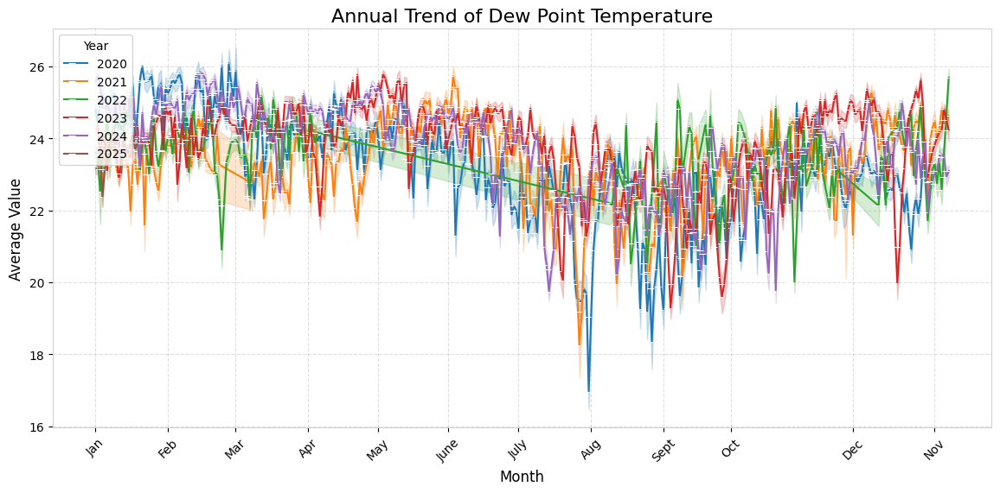

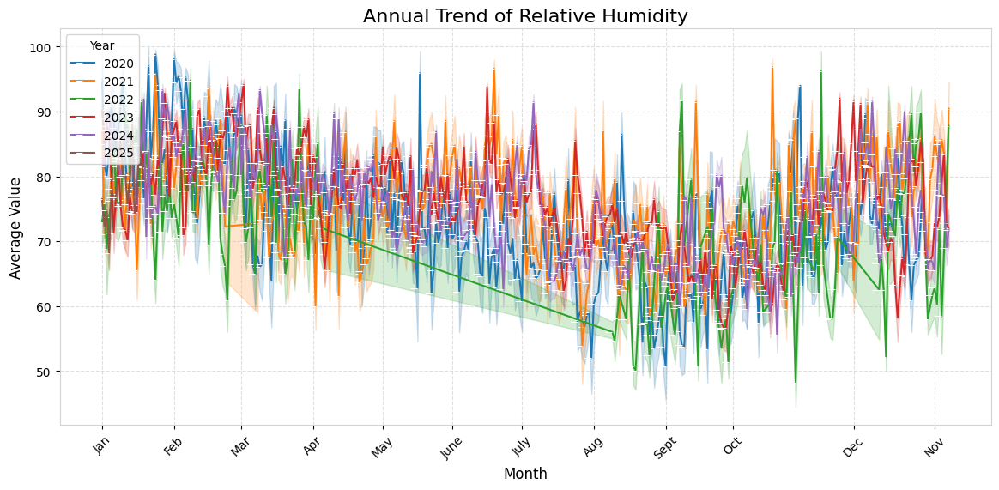

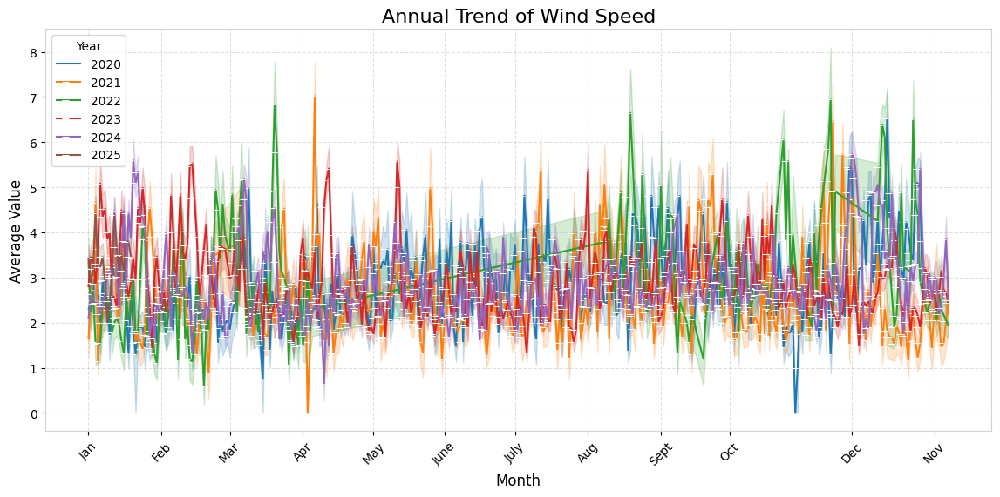

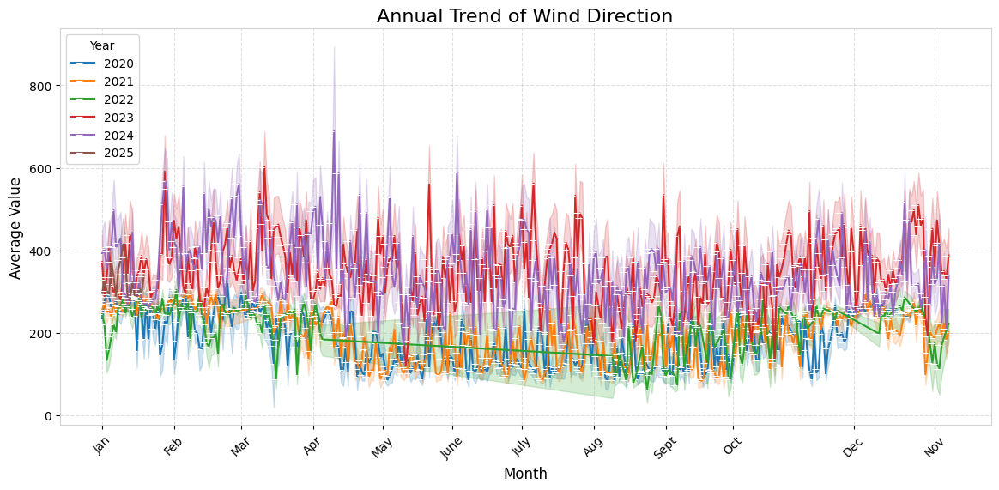

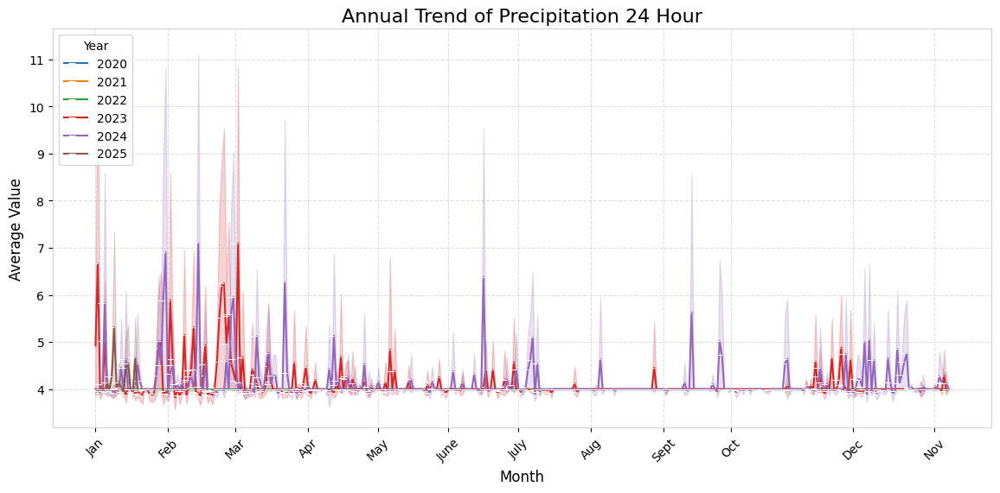

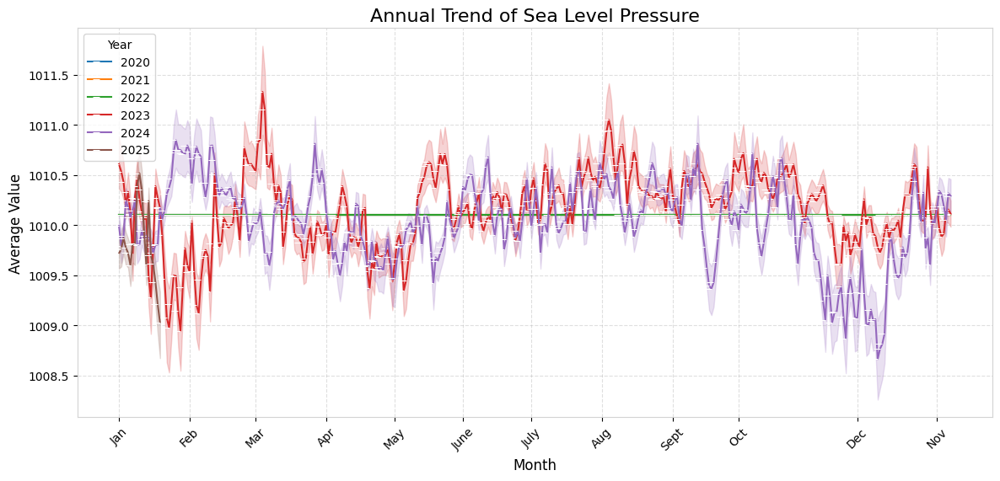

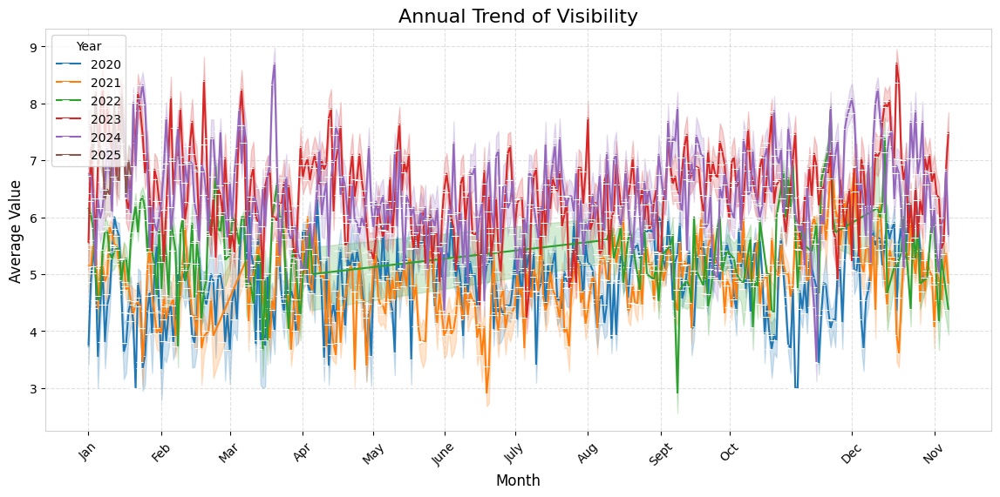

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

df_meteo_all = df_all_meteo.copy()

def robust_to_datetime(date_value):
    if pd.isna(date_value):
        return pd.NaT
    try:
        return pd.to_datetime(date_value)
    except:
        try:
            if pd.api.types.is_numeric_dtype(type(date_value)):
                return pd.to_datetime(date_value, origin='1899-12-30', unit='D', errors='coerce')
            else:
                return pd.NaT
        except:
            return pd.NaT

df_meteo_all['date'] = df_meteo_all['date'].apply(robust_to_datetime)
df_meteo_all.dropna(subset=['date'], inplace=True)

meteo_params = [
    'elevation',
    'temperature',
    'dew_point_temperature',
    'relative_humidity',
    'wind_speed',
    'wind_direction',
    'precipitation_24_hour',
    'sea_level_pressure',
    'visibility'
]
meteo_params_present = [p for p in meteo_params if p in df_meteo_all.columns]

for col in meteo_params_present:
    df_meteo_all[col] = pd.to_numeric(df_meteo_all[col], errors='coerce')

df_meteo_all[meteo_params_present] = df_meteo_all[meteo_params_present].fillna(
    df_meteo_all[meteo_params_present].median()
)

df_annual_mean = (
    df_meteo_all.groupby(['date', 'station_name'])[meteo_params_present]
    .mean()
    .reset_index()
)

df_annual_mean['Tahun'] = df_annual_mean['date'].dt.year
df_annual_mean['Hari-Bulan'] = df_annual_mean['date'].dt.strftime('%m-%d')

for param in meteo_params_present:
    plt.figure(figsize=(14, 6))
    sns.lineplot(
        data=df_annual_mean,
        x='Hari-Bulan',
        y=param,
        hue='Tahun',
        marker=False,
        dashes=False,
        palette='tab10'
    )

    plt.title(f"Annual Trend of {param.replace('_',' ').title()}", fontsize=16)
    plt.xlabel("Month", fontsize=12)
    plt.ylabel("Average Value", fontsize=12)
    plt.xticks(
        ticks=['01-01', '02-01', '03-01', '04-01', '05-01', '06-01',
               '07-01', '08-01', '09-01', '10-01', '11-01', '12-01'],
        labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'June',
                'July', 'Aug', 'Sept', 'Oct', 'Nov', 'Dec'],
        rotation=45
    )
    plt.grid(True, linestyle='--', alpha=0.4)

    for spine in plt.gca().spines.values():
        spine.set_color("lightgrey")

    plt.legend(title="Year", loc='upper left')
    plt.show()

#### Hourly Trends Interval

In [ ]:
df_meteo_hourly = df_meteo_all.copy()

meteo_parameters = [
    'elevation',
    'temperature',
    'dew_point_temperature',
    'relative_humidity',
    'wind_speed',
    'wind_direction',
    'precipitation_24_hour',
    'sea_level_pressure',
    'visibility'
]

df_meteo_hourly['date'] = pd.to_datetime(df_meteo_hourly['date'], errors='coerce')
df_meteo_hourly = df_meteo_hourly.dropna(subset=['date'])
df_meteo_hourly = df_meteo_hourly.set_index('date')

for col in meteo_parameters:
    if col in df_meteo_hourly.columns:
        df_meteo_hourly[col] = pd.to_numeric(df_meteo_hourly[col], errors='coerce')

for col in meteo_parameters:
    if col in df_meteo_hourly.columns:
        df_meteo_hourly[col].fillna(df_meteo_hourly[col].median(), inplace=True)

intervals = ['1H', '8H', '12H', '24H', '48H']
resampled_meteo_dict = {}

for interval in intervals:
    meteo_params_present = [p for p in meteo_parameters if p in df_meteo_hourly.columns]
    df_resampled = (
        df_meteo_hourly
        .groupby('station_name')[meteo_params_present]
        .resample(interval)
        .mean()
        .reset_index()
    )
    resampled_meteo_dict[interval] = df_resampled

print("Resampling of meteorological data complete.")

/tmp/ipython-input-1541964190.py:25: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_meteo_hourly[col].fillna(df_meteo_hourly[col].median(), inplace=True)
/tmp/ipython-input-1541964190.py:35: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  .resample(interval)
/tmp/ipython-input-1541964190.py:35: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  .resample(interval)
/tmp/ipython-input-1541964190.py:35: FutureWarning: 'H' is dep

Resampling of meteorological data complete.


/tmp/ipython-input-1541964190.py:35: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  .resample(interval)


In [ ]:
df_melted = pd.DataFrame()
for interval, df in resampled_meteo_dict.items():
    meteo_parameters = [
        'temperature',
        'dew_point_temperature',
        'relative_humidity',
        'wind_speed',
        'wind_direction',
        'precipitation_24_hour',
        'sea_level_pressure',
        'visibility'
    ]
    available_meteo_vars = [v for v in meteo_parameters if v in df.columns]

    df_melted_interval = df.melt(
        id_vars=['station_name', 'date'],
        value_vars=available_meteo_vars,
        var_name='Parameter',
        value_name='Value'
    )
    df_melted_interval['Interval'] = interval
    df_melted = pd.concat([df_melted, df_melted_interval], ignore_index=True)

df_melted['date'] = pd.to_datetime(df_melted['date'], errors='coerce')
df_melted = df_melted.dropna(subset=['date'])

if not df_melted.empty:
    df_melted['elapsed_hours'] = (
        df_melted['date'] - df_melted['date'].min()
    ).dt.total_seconds() / 3600
else:
    print("df_melted is empty after date processing.")

intervals = df_melted['Interval'].unique()
print(intervals)

for interval in intervals:
    count = len(df_melted[df_melted['Interval'] == interval])
    print(f"Interval {interval}: {count} rows")

['1H' '8H' '12H' '24H' '48H']
Interval 1H: 786368 rows
Interval 8H: 98304 rows
Interval 12H: 65536 rows
Interval 24H: 32768 rows
Interval 48H: 16384 rows


##### 1 Hour Trend

In [ ]:
display(resampled_meteo_dict['1H'].head())

,station_name,date,elevation,temperature,dew_point_temperature,relative_humidity,wind_speed,wind_direction,precipitation_24_hour,sea_level_pressure,visibility
0,HALIM PERDANAKUSUMA INTL,2020-01-01 00:00:00,25.6,25.0,25.0,100.0,2.35,255.0,4.0,1010.1,3.00
1,HALIM PERDANAKUSUMA INTL,2020-01-01 01:00:00,25.6,24.0,24.0,100.0,2.60,240.0,4.0,1010.1,3.00
2,HALIM PERDANAKUSUMA INTL,2020-01-01 02:00:00,25.6,25.0,25.0,100.0,1.80,260.0,4.0,1010.1,3.50
3,HALIM PERDANAKUSUMA INTL,2020-01-01 03:00:00,25.6,25.5,25.0,97.0,4.65,250.0,4.0,1010.1,3.00
4,HALIM PERDANAKUSUMA INTL,2020-01-01 04:00:00,25.6,26.0,25.0,94.0,3.60,260.0,4.0,1010.1,3.75


##### 8 Hour Trend


In [ ]:
display(resampled_meteo_dict['8H'].head())

,station_name,date,elevation,temperature,dew_point_temperature,relative_humidity,wind_speed,wind_direction,precipitation_24_hour,sea_level_pressure,visibility
0,HALIM PERDANAKUSUMA INTL,2020-01-01 00:00:00,25.6,25.363636,24.909091,97.272727,3.372727,252.727273,4.0,1010.1,3.409091
1,HALIM PERDANAKUSUMA INTL,2020-01-01 08:00:00,25.6,27.166667,24.833333,87.333333,1.550000,205.000000,4.0,1010.1,4.833333
2,HALIM PERDANAKUSUMA INTL,2020-01-01 16:00:00,25.6,24.500000,24.500000,100.000000,0.375000,225.000000,4.0,1010.1,3.000000
3,HALIM PERDANAKUSUMA INTL,2020-01-02 00:00:00,25.6,28.666667,24.583333,79.416667,2.550000,284.166667,4.0,1010.1,5.000000
4,HALIM PERDANAKUSUMA INTL,2020-01-02 08:00:00,25.6,28.800000,24.200000,77.000000,2.180000,288.000000,4.0,1010.1,5.400000


##### 12 Hour Trend

In [ ]:
display(resampled_meteo_dict['12H'].head())

,station_name,date,elevation,temperature,dew_point_temperature,relative_humidity,wind_speed,wind_direction,precipitation_24_hour,sea_level_pressure,visibility
0,HALIM PERDANAKUSUMA INTL,2020-01-01 00:00:00,25.6,25.933333,24.866667,94.066667,2.953333,240.000000,4.0,1010.1,3.833333
1,HALIM PERDANAKUSUMA INTL,2020-01-01 12:00:00,25.6,25.166667,24.666667,97.166667,0.600000,218.333333,4.0,1010.1,3.500000
2,HALIM PERDANAKUSUMA INTL,2020-01-02 00:00:00,25.6,28.875000,24.500000,78.062500,2.500000,288.125000,4.0,1010.1,5.125000
3,HALIM PERDANAKUSUMA INTL,2020-01-02 12:00:00,25.6,25.833333,24.333333,91.500000,2.500000,246.666667,4.0,1010.1,4.166667
4,HALIM PERDANAKUSUMA INTL,2020-01-03 00:00:00,25.6,29.727273,25.000000,76.136364,3.122727,287.727273,4.0,1010.1,5.454545


##### 24 Hour Trend


In [ ]:
display(resampled_meteo_dict['24H'].head())

,station_name,date,elevation,temperature,dew_point_temperature,relative_humidity,wind_speed,wind_direction,precipitation_24_hour,sea_level_pressure,visibility
0,HALIM PERDANAKUSUMA INTL,2020-01-01,25.6,25.714286,24.809524,94.952381,2.280952,233.809524,4.0,1010.1,3.738095
1,HALIM PERDANAKUSUMA INTL,2020-01-02,25.6,28.045455,24.454545,81.727273,2.500000,276.818182,4.0,1010.1,4.863636
2,HALIM PERDANAKUSUMA INTL,2020-01-03,25.6,28.931034,25.034483,80.103448,2.731034,288.620690,4.0,1010.1,5.448276
3,HALIM PERDANAKUSUMA INTL,2020-01-04,25.6,28.285714,25.214286,83.857143,3.164286,287.142857,4.0,1010.1,5.071429
4,HALIM PERDANAKUSUMA INTL,2020-01-05,25.6,26.650000,24.950000,90.750000,2.490000,262.000000,4.0,1010.1,3.550000


##### 48 Hour Trend


In [ ]:
display(resampled_meteo_dict['48H'].head())

,station_name,date,elevation,temperature,dew_point_temperature,relative_humidity,wind_speed,wind_direction,precipitation_24_hour,sea_level_pressure,visibility
0,HALIM PERDANAKUSUMA INTL,2020-01-01,25.6,26.906977,24.627907,88.186047,2.393023,255.813953,4.0,1010.1,4.313953
1,HALIM PERDANAKUSUMA INTL,2020-01-03,25.6,28.720930,25.093023,81.325581,2.872093,288.139535,4.0,1010.1,5.325581
2,HALIM PERDANAKUSUMA INTL,2020-01-05,25.6,26.810811,24.918919,89.783784,2.159459,266.756757,4.0,1010.1,3.967568
3,HALIM PERDANAKUSUMA INTL,2020-01-07,25.6,27.954545,25.045455,84.886364,2.693182,264.318182,4.0,1010.1,4.636364
4,HALIM PERDANAKUSUMA INTL,2020-01-09,25.6,25.972973,24.810811,93.486486,2.035135,254.054054,4.0,1010.1,4.581081


##### Comparison 1h, 8h, 12h, 24h, 48 Meteorology Trends

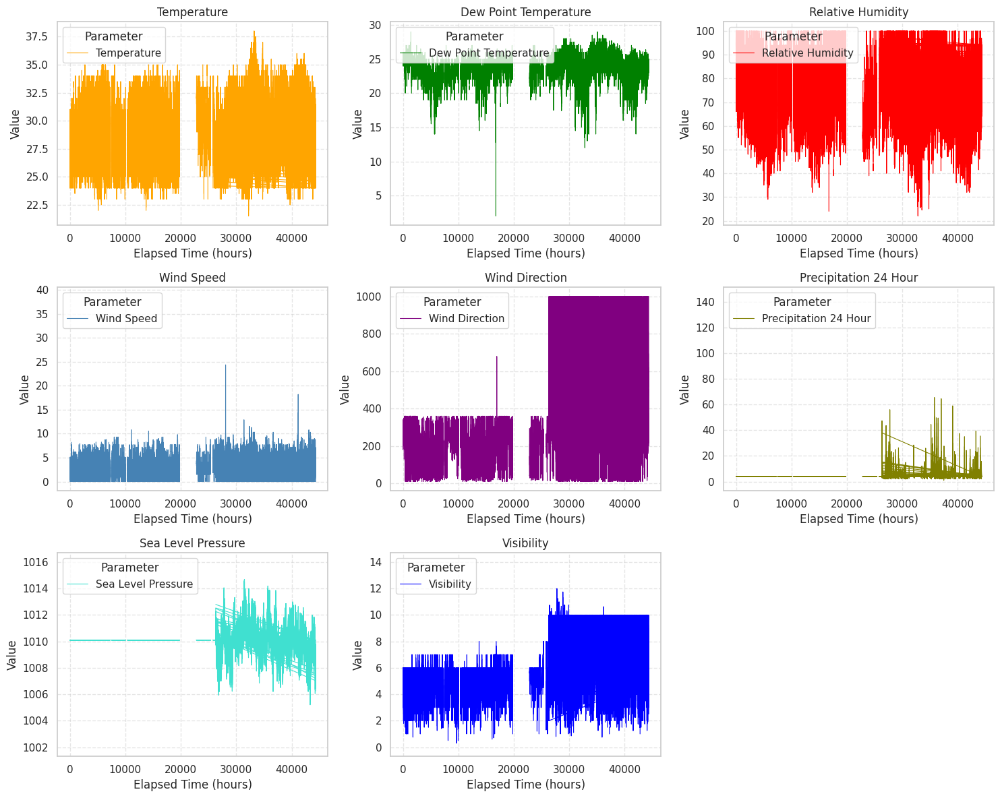

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import math

meteo_vars_colors = {
    'temperature': 'orange',
    'dew_point_temperature': 'green',
    'relative_humidity': 'red',
    'wind_speed': 'steelblue',
    'wind_direction': 'purple',
    'precipitation_24_hour': 'olive',
    'sea_level_pressure': 'turquoise',
    'visibility': 'blue'
}

parameters = df_melted['Parameter'].unique()
n_params = len(parameters)

n_cols = 3
n_rows = math.ceil(n_params / n_cols)

intervals_present = df_melted['Interval'].unique()

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4))
axes = axes.flatten()

for i, param in enumerate(parameters):
    ax = axes[i]
    subset_param = df_melted[df_melted['Parameter'] == param]

    for idx, interval in enumerate(intervals_present):
        subset_interval = subset_param[subset_param['Interval'] == interval]
        if not subset_interval.empty:
            label = param.replace('_', ' ').title() if idx == 0 else None
            ax.plot(
                subset_interval['elapsed_hours'],
                subset_interval['Value'],
                label=label,
                color=meteo_vars_colors.get(param, 'gray'),
                linewidth=0.8
            )

    ax.set_title(param.replace('_', ' ').title())
    ax.set_xlabel("Elapsed Time (hours)")
    ax.set_ylabel("Value")
    ax.legend(title="Parameter", loc='upper left')
    ax.grid(True, linestyle='--', alpha=0.5)


for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

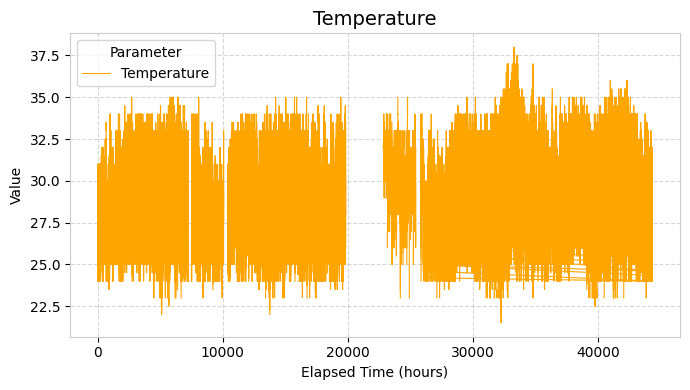

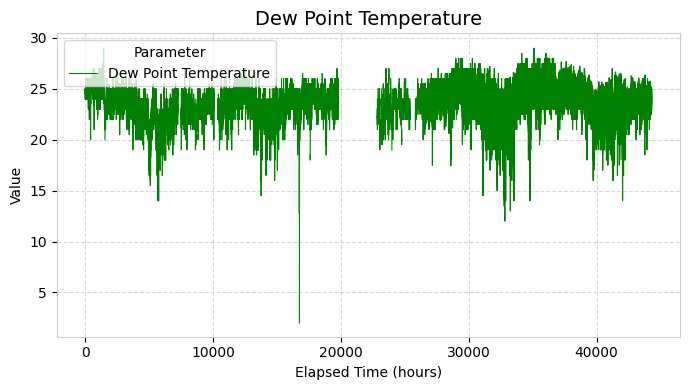

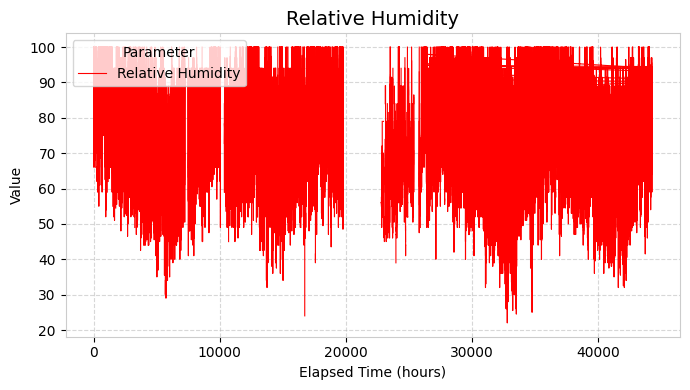

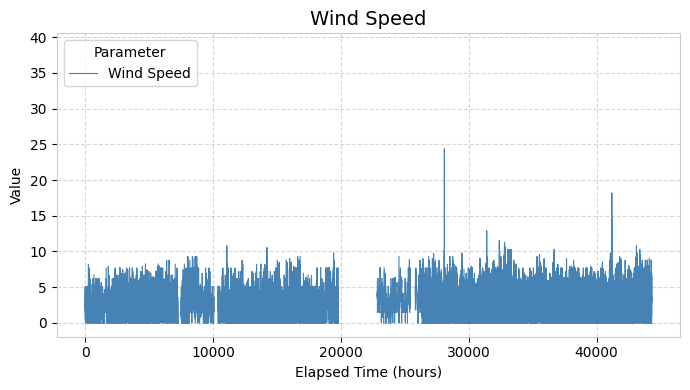

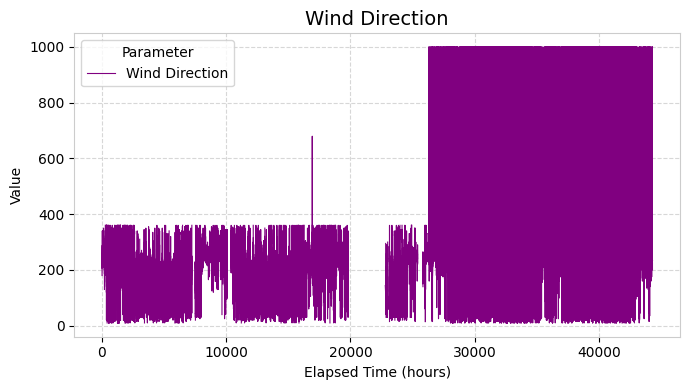

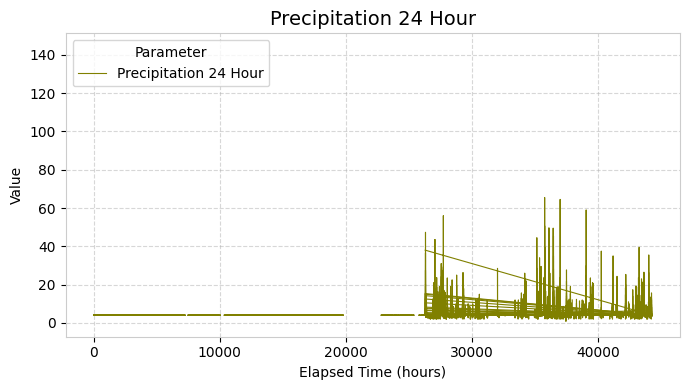

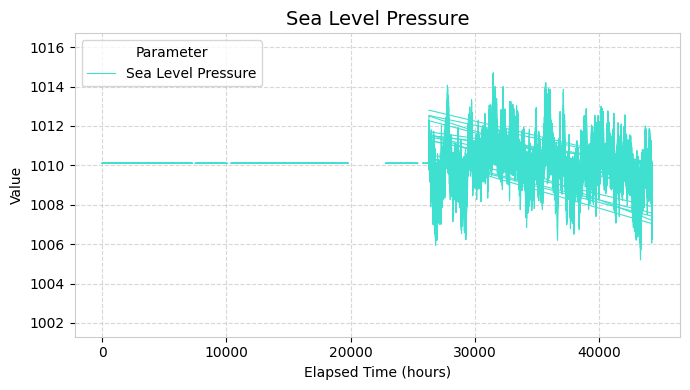

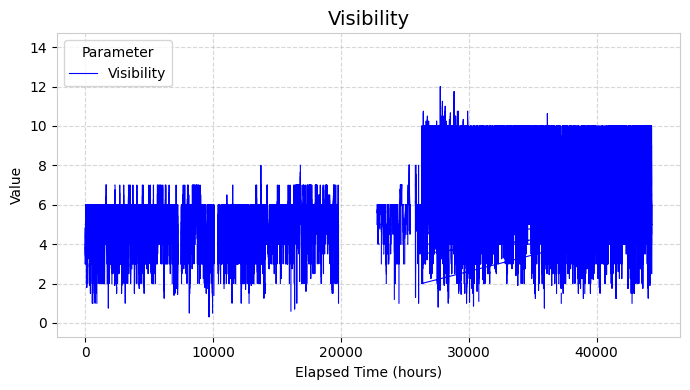

In [ ]:
import matplotlib.pyplot as plt

meteo_vars_colors = {
    'temperature': 'orange',
    'dew_point_temperature': 'green',
    'relative_humidity': 'red',
    'wind_speed': 'steelblue',
    'wind_direction': 'purple',
    'precipitation_24_hour': 'olive',
    'sea_level_pressure': 'turquoise',
    'visibility': 'blue'
}

parameters = df_melted['Parameter'].unique()
intervals_present = df_melted['Interval'].unique()

for param in parameters:
    plt.figure(figsize=(7, 4))
    subset_param = df_melted[df_melted['Parameter'] == param]

    for interval in intervals_present:
        subset_interval = subset_param[subset_param['Interval'] == interval]
        if not subset_interval.empty:
            plt.plot(
                subset_interval['elapsed_hours'],
                subset_interval['Value'],
                color=meteo_vars_colors.get(param, 'gray'),
                linewidth=0.8
            )

    plt.title(param.replace('_', ' ').title(), fontsize=14)
    plt.xlabel("Elapsed Time (hours)")
    plt.ylabel("Value")

    plt.legend([param.replace('_', ' ').title()], title="Parameter", loc='upper left')
    plt.grid(True, linestyle='--', alpha=0.5)

    ax = plt.gca()
    for spine in ax.spines.values():
        spine.set_edgecolor('#cccccc')
        spine.set_linewidth(0.8)

    plt.tight_layout()
    plt.show()

#### Peak Concentration Highlight

In [ ]:
import pandas as pd

meteo_parameters = [
    'temperature',
    'dew_point_temperature',
    'relative_humidity',
    'wind_speed',
    'wind_direction',
    'precipitation_24_hour',
    'sea_level_pressure',
    'visibility'
]

for param in meteo_parameters:
    if param in df_all_meteo.columns:
        df_all_meteo[param] = pd.to_numeric(df_all_meteo[param], errors='coerce')
    else:
        print(f"Warning: Parameter '{param}' not found in df_all_meteo.")

peak_records = []

for param in meteo_parameters:
    if param not in df_all_meteo.columns:
        continue
    idxmax_per_station = df_all_meteo.groupby('station_name')[param].idxmax().dropna()
    for station_name_code, idxmax in idxmax_per_station.items():
        if pd.isna(idxmax):
            continue
        row = df_all_meteo.loc[idxmax]

        peak_records.append({
            'station_name': station_name_code,
            'parameter': param,
            'date': row['date'],
            'concentration': row[param]
        })

peak_meteo_df = pd.DataFrame(peak_records)
peak_meteo_df = peak_meteo_df.sort_values(by=['parameter', 'station_name']).reset_index(drop=True)

print("Peak Meteorology Data per Station and Parameter:")
print(peak_meteo_df)

Peak Meteorology Data per Station and Parameter:
                station_name              parameter                date  \
0   HALIM PERDANAKUSUMA INTL  dew_point_temperature 2020-03-01 03:00:00   
1        JAKARTA/OBSERVATORY  dew_point_temperature 2023-01-13 09:00:00   
2        JAKARTA/SOEKARNO-HA  dew_point_temperature 2023-11-23 11:30:00   
3         JAKARTA/TANJUNGPRI  dew_point_temperature 2023-08-08 09:00:00   
4   HALIM PERDANAKUSUMA INTL  precipitation_24_hour 2020-01-01 00:00:00   
5        JAKARTA/OBSERVATORY  precipitation_24_hour 2024-02-14 00:00:00   
6        JAKARTA/SOEKARNO-HA  precipitation_24_hour 2024-01-30 20:30:00   
7         JAKARTA/TANJUNGPRI  precipitation_24_hour 2024-01-31 00:00:00   
8   HALIM PERDANAKUSUMA INTL      relative_humidity 2020-01-01 00:00:00   
9        JAKARTA/OBSERVATORY      relative_humidity 2024-01-28 00:00:00   
10       JAKARTA/SOEKARNO-HA      relative_humidity 2023-01-01 01:00:00   
11        JAKARTA/TANJUNGPRI      relative_humidity

In [ ]:
peak_per_param = peak_meteo_df.loc[peak_meteo_df.groupby('parameter')['concentration'].idxmax()].reset_index(drop=True)
print("Peak Meteorology Data per Parameter (1 station per parameter):")
print(peak_per_param[['station_name', 'parameter', 'date', 'concentration']])

Peak Meteorology Data per Parameter (1 station per parameter):
               station_name              parameter                date  \
0       JAKARTA/OBSERVATORY  dew_point_temperature 2023-01-13 09:00:00   
1        JAKARTA/TANJUNGPRI  precipitation_24_hour 2024-01-31 00:00:00   
2  HALIM PERDANAKUSUMA INTL      relative_humidity 2020-01-01 00:00:00   
3       JAKARTA/OBSERVATORY     sea_level_pressure 2023-08-03 15:00:00   
4  HALIM PERDANAKUSUMA INTL            temperature 2023-10-16 06:00:00   
5       JAKARTA/OBSERVATORY             visibility 2024-08-01 09:00:00   
6  HALIM PERDANAKUSUMA INTL         wind_direction 2021-12-06 05:30:00   
7       JAKARTA/OBSERVATORY             wind_speed 2023-03-16 09:00:00   

   concentration  
0           29.1  
1          144.0  
2          100.0  
3         1016.0  
4           38.0  
5           14.0  
6          999.0  
7           38.6  


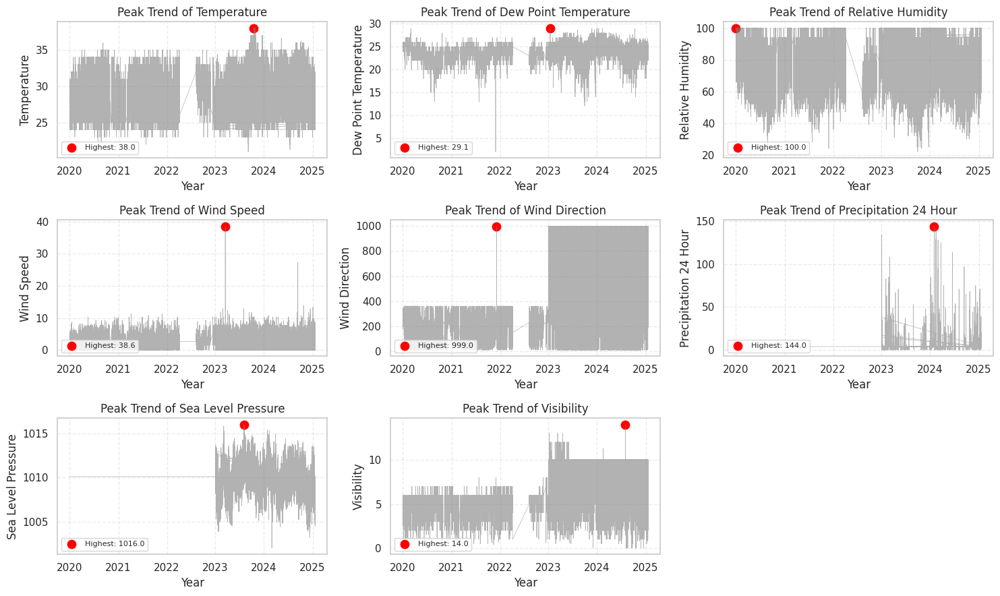

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import math

meteo_parameters = [
    'temperature',
    'dew_point_temperature',
    'relative_humidity',
    'wind_speed',
    'wind_direction',
    'precipitation_24_hour',
    'sea_level_pressure',
    'visibility'
]

highest_concentration_dates_meteo = {}

for param in meteo_parameters:
    if param in df_all_meteo.columns:
        df_all_meteo[param] = pd.to_numeric(df_all_meteo[param], errors='coerce')

        if df_all_meteo[param].notna().any():
            idx_max = df_all_meteo[param].idxmax()
            max_row = df_all_meteo.loc[idx_max]
            highest_concentration_dates_meteo[param] = {
                'date': max_row['date'],
                'concentration': max_row[param]
            }
        else:
            print(f"Warning: Parameter '{param}' has no non-null values.")
    else:
        print(f"Warning: Parameter '{param}' not found in df_all_meteo.")

params_to_plot = list(highest_concentration_dates_meteo.keys())
n_params = len(params_to_plot)
n_cols = 3
n_rows = math.ceil(n_params / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 3))
axes = axes.flatten()

for i, param in enumerate(params_to_plot):
    ax = axes[i]
    ax.plot(df_all_meteo['date'], df_all_meteo[param],
            color='gray', linestyle='-', linewidth=0.5, alpha=0.6)

    peak_date = highest_concentration_dates_meteo[param]['date']
    peak_concentration = highest_concentration_dates_meteo[param]['concentration']
    ax.scatter(peak_date, peak_concentration,
               color='red', s=80,
               label=f'Highest: {peak_concentration:.1f}')

    ax.set_title(f'Peak Trend of {param.replace("_", " ").title()}', fontsize=12)
    ax.set_xlabel('Year')
    ax.set_ylabel(param.replace("_", " ").title())
    ax.grid(True, linestyle='--', alpha=0.4)
    ax.legend(fontsize=8, loc='lower left')

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

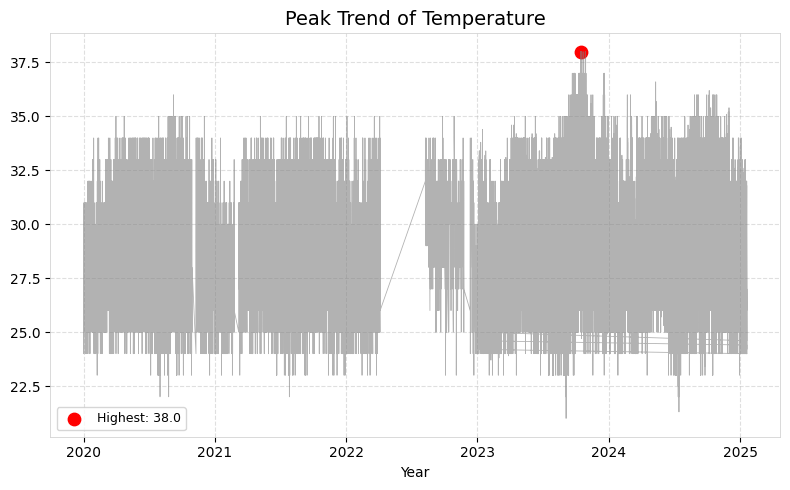

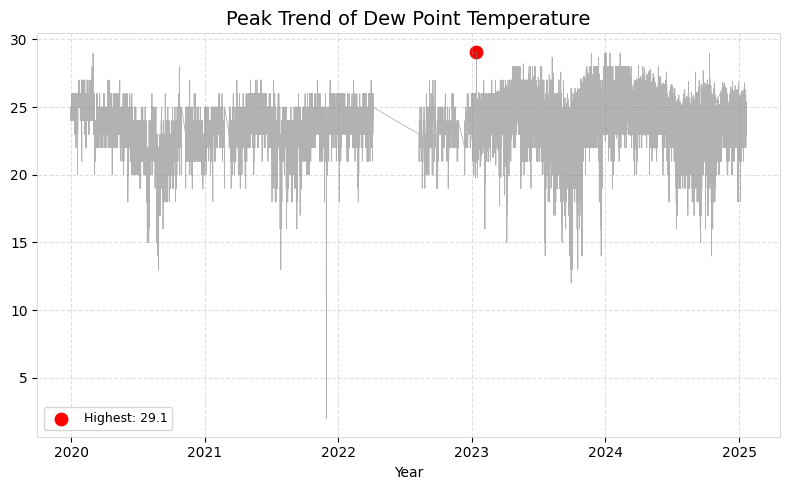

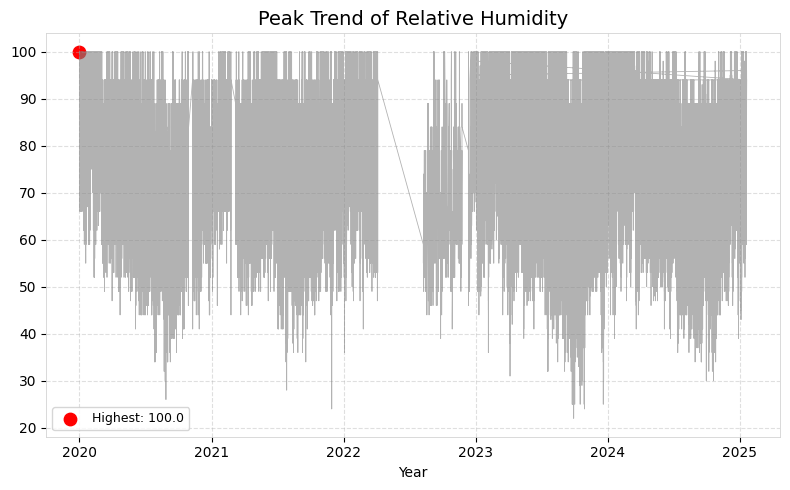

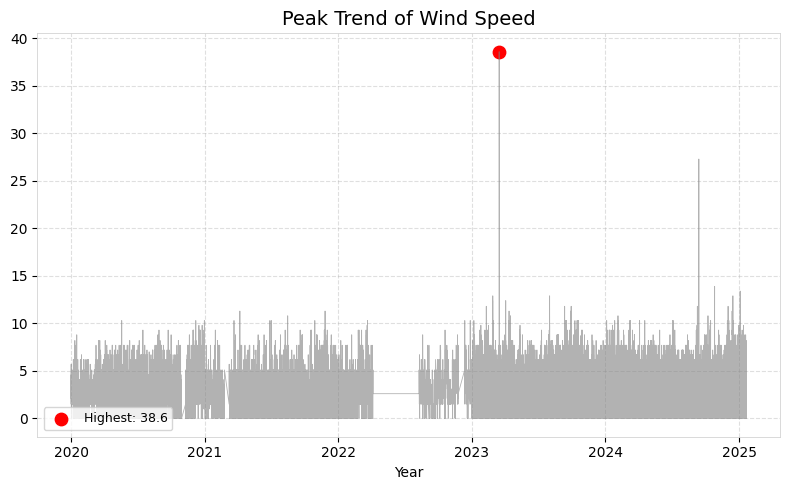

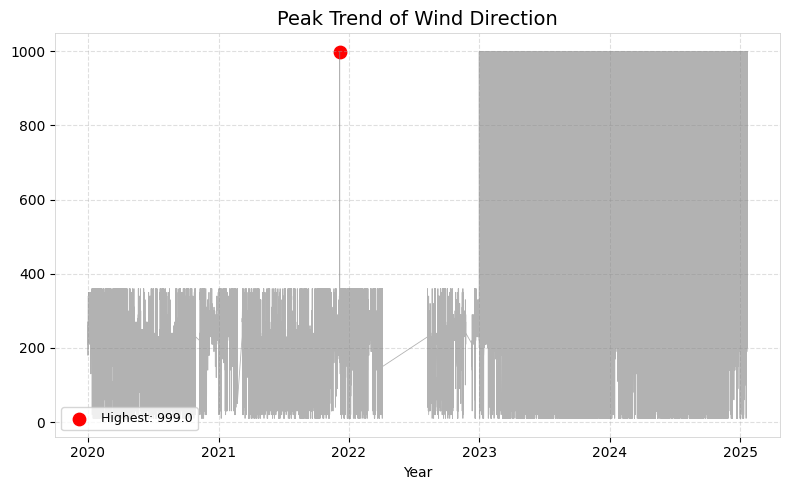

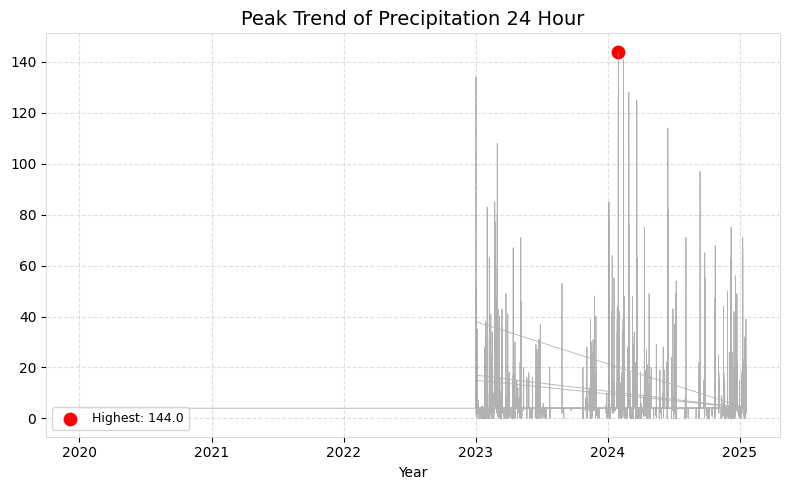

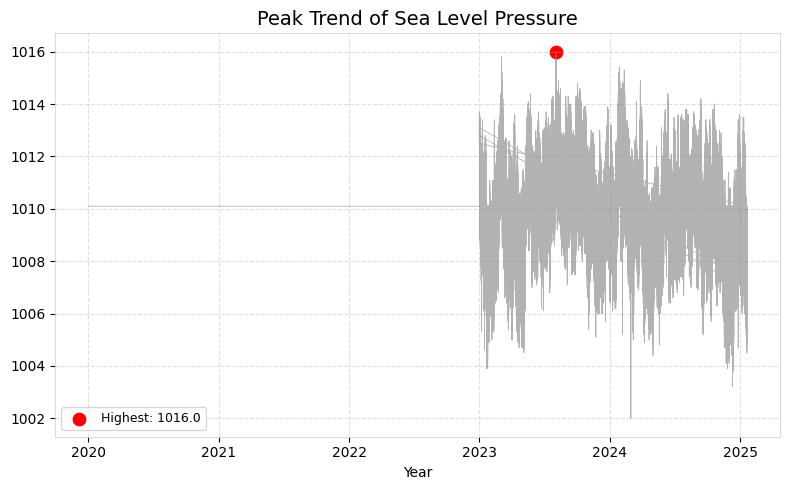

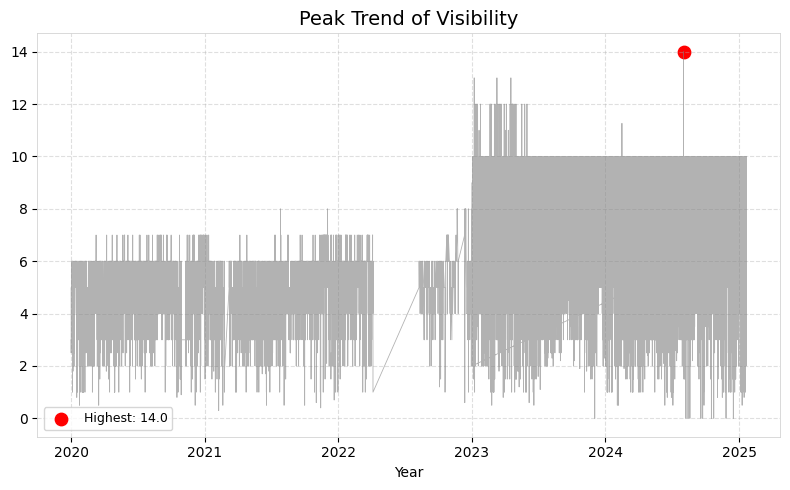

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

meteo_parameters = [
    'temperature',
    'dew_point_temperature',
    'relative_humidity',
    'wind_speed',
    'wind_direction',
    'precipitation_24_hour',
    'sea_level_pressure',
    'visibility'
]

highest_concentration_dates_meteo = {}

for param in meteo_parameters:
    if param in df_all_meteo.columns:
        df_all_meteo[param] = pd.to_numeric(df_all_meteo[param], errors='coerce')

        if df_all_meteo[param].notna().any():
            idx_max = df_all_meteo[param].idxmax()
            max_row = df_all_meteo.loc[idx_max]
            highest_concentration_dates_meteo[param] = {
                'date': max_row['date'],
                'concentration': max_row[param]
            }
        else:
            print(f"Warning: Parameter '{param}' has no non-null values.")
    else:
        print(f"Warning: Parameter '{param}' not found in df_all_meteo.")

for param, info in highest_concentration_dates_meteo.items():
    plt.figure(figsize=(8, 5))

    plt.plot(
        df_all_meteo['date'], df_all_meteo[param],
        color='gray', linestyle='-', linewidth=0.6, alpha=0.6,
    )

    plt.scatter(
        info['date'], info['concentration'],
        color='red', s=80,
        label=f'Highest: {info["concentration"]:.1f}'
    )

    plt.title(f'Peak Trend of {param.replace("_", " ").title()}', fontsize=14)
    plt.xlabel('Year')

    plt.grid(True, linestyle='--', alpha=0.4)
    plt.legend(fontsize=9, loc='lower left')

    ax = plt.gca()
    for spine in ax.spines.values():
        spine.set_linewidth(0.6)
        spine.set_edgecolor("lightgray")

    plt.tight_layout()
    plt.show()

# Data Weighting (Attention Mechanism)

## Data Merging

In [ ]:
df_merged = pd.concat([df_daily_mean_station, df_annual_mean], ignore_index=True)

df_merged['tanggal'] = pd.to_datetime(df_merged['tanggal'])

merged_cols = ['PM2.5', 'PM10', 'SO2', 'CO', 'O3', 'NO2',
               'temperature', 'dew_point_temperature', 'relative_humidity',
               'wind_speed', 'wind_direction', 'precipitation_24_hour',
               'sea_level_pressure', 'visibility']

merged_cols = [c for c in merged_cols if c in df_merged.columns]

target_col = 'PM2.5'

df_merged = df_merged.sort_values('tanggal').reset_index(drop=True)

In [ ]:
df_merged.to_csv("aqi_meteo_merged.csv", index=False)

from google.colab import files
files.download("aqi_meteo_merged.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Spatiotemporal Correlation Analysis

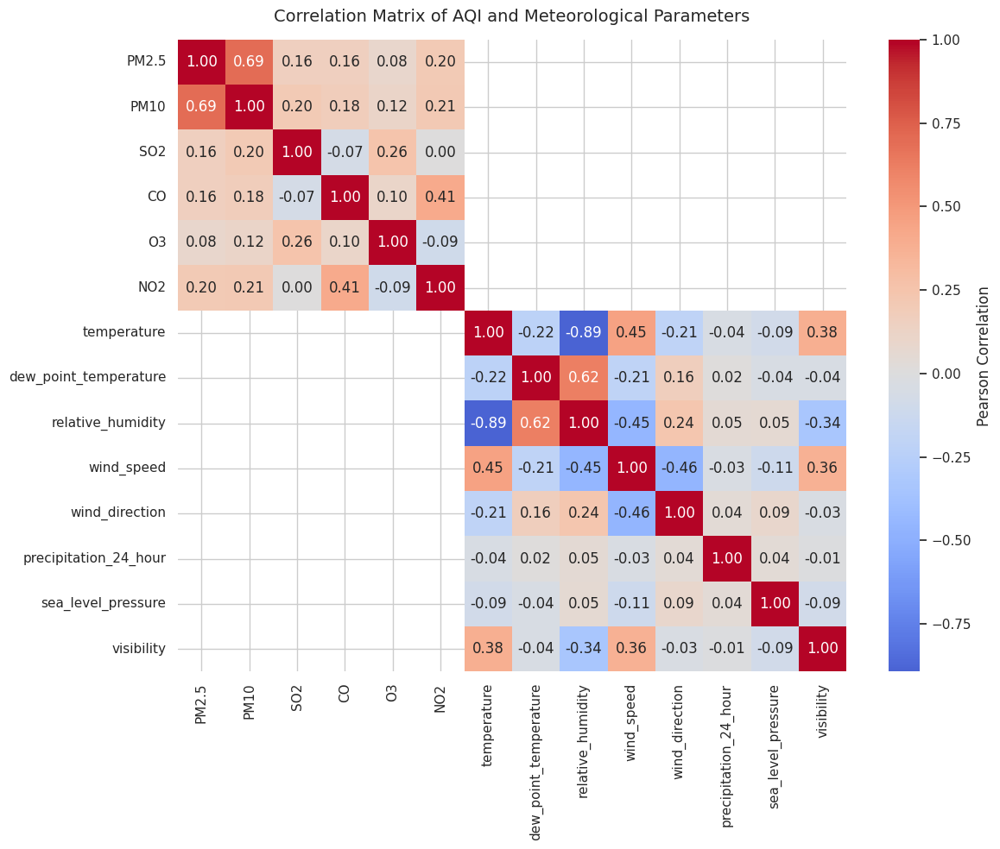

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

df_corr = df_merged[merged_cols].corr(method='pearson')

plt.figure(figsize=(12,10))
sns.heatmap(
    df_corr,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    center=0,
    cbar_kws={'label': 'Pearson Correlation'}
)

plt.title("Correlation Matrix of AQI and Meteorological Parameters", fontsize=14, pad=15)
plt.tight_layout()
plt.show()

**A. Inter-Pollutant Correlations (AQI vs. AQI)**
1. **PM2.5 – PM10 (r = 0.69)**: Strong positive correlation. Both pollutants originate from similar sources, such as traffic, combustion, and dust.
Risk: When PM10 increases, PM2.5 almost always increases, amplifying adverse health effects.
2. **CO – O₃ (r = 0.38)**: Moderate positive correlation. CO acts as a precursor in photochemical reactions that generate ozone.
Risk: Elevated CO can indirectly increase ozone formation, worsening urban smog events.
3. **CO – NO₂ (r = 0.32)**: Moderate correlation. Both mainly come from combustion and vehicular emissions.
Risk: Their co-occurrence represents high-risk traffic-related pollution episodes.
4. **PM2.5 – NO₂ (r = 0.25)**: Weak–moderate correlation. NO₂ emissions from traffic are often accompanied by fine particulates.
Risk: Joint exposure elevates respiratory stress, especially among sensitive populations.
5. **PM10 – NO₂ (r = 0.23)**: Weak–moderate correlation, linked to combustion and industrial activity.
Risk: Their co-occurrence contributes to poor AQI and reduced visibility.

**Summary**: The strongest risk pair is PM2.5–PM10, which are the core drivers of AQI deterioration. Gas-phase correlations (CO–O₃, CO–NO₂) highlight the influence of traffic emissions, while NO₂–particulate links underline common combustion sources.

**B. Inter-Meteorological Correlations (Meteorology vs. Meteorology)**
1. **Temperature – Relative Humidity (r = –0.89)**: Very strong negative correlation.Fundamental atmospheric relation; hot air reduces relative humidity, critical for both human stress and pollution chemistry.
2. **Dew Point – Relative Humidity (r = 0.62)**: Strong positive correlation. Higher dew point reflects higher RH, indicating muggy conditions prone to pollutant accumulation.
3. **Temperature – Wind Speed (r = 0.45)**: Moderate positive correlation. Hotter conditions often drive stronger wind circulation, affecting pollution dispersion.
4. **Pressure (Station – Sea Level) (r ≈ 0.40–0.50)**: Moderate correlation. These two measures are naturally related, used to normalize weather conditions.
5. **Temperature – Dew Point (r ≈ 0.35–0.40)**: Positive correlation. Indicates the air’s increasing capacity to hold moisture at higher temperatures.

**Summary**: The most critical meteorological relationship is Temperature–Relative Humidity (–0.89), followed by moisture-related parameters (Dew Point–RH). Wind speed and pressure provide secondary roles in pollutant dispersion and atmospheric stability.

**C. Pollutant–Meteorology Correlations (AQI vs. Meteorology)**
1. **CO – Temperature (r = 0.32)**: Higher temperatures enhance CO accumulation due to stagnant conditions. Hot weather increases CO exposure risks, particularly in urban areas.
2. **PM2.5 – Visibility (r = 0.25)**: Fine particulates strongly reduce visibility. Visibility degradation is a direct indicator of harmful pollution episodes.
3. **PM10 – Visibility (r = 0.23)**: Coarse particles impair visibility, though less than PM2.5. Still critical for AQI spikes and haze formation.
4. **SO₂ – Visibility (r = 0.18)**: SO₂ leads to sulfate aerosol formation. Increases haze and respiratory irritation.
5. **PM10 – Temperature (r = 0.17)**: Hot weather increases PM10 resuspension from dust and road surfaces. Elevates short-term exposure during heat episodes.

**Summary**: The strongest AQI–meteorology link is CO–Temperature (0.32). Visibility is the most sensitive meteorological factor, consistently tied to PM2.5, PM10, and SO₂, confirming its role as a practical indicator of pollution intensity.

## Weighting Type

In [ ]:
import pandas as pd

merged_cols = [
    'PM2.5', 'PM10', 'SO2', 'CO', 'O3', 'NO2',
    'temperature', 'dew_point_temperature', 'relative_humidity',
    'wind_speed', 'wind_direction', 'precipitation_24_hour',
    'sea_level_pressure', 'visibility'
]

weight_high = 1.5
weight_default = 1.0

influential_params = [
    # aqi params
    'PM2.5', 'PM10', 'CO', 'O3', 'NO2',
    # meteorology params
    'temperature', 'dew_point_temperature', 'relative_humidity', 'wind_speed', 'sea_level_pressure',
    # aqi–meteorology params
    'visibility', 'SO2'
]

exclude_cols = ['tanggal', 'station', 'Hari-Bulan']
param_cols = [c for c in df_merged.columns if c not in exclude_cols]

if 'station' in df_merged.columns:
    all_records_df = df_merged.melt(
        id_vars=['station','tanggal'],
        value_vars=param_cols,
        var_name='parameter',
        value_name='value'
    )
else:
    all_records_df = df_merged.melt(
        id_vars=['tanggal'],
        value_vars=param_cols,
        var_name='parameter',
        value_name='value'
    )

all_records_df['tanggal'] = pd.to_datetime(all_records_df['tanggal']).dt.normalize()

all_records_df['attention_weight'] = weight_default

all_records_df.loc[all_records_df['parameter'].isin(influential_params), 'attention_weight'] = weight_high

attention_df = all_records_df[['station','tanggal','parameter','attention_weight']]

print("Attention weights sample:")
print(attention_df.head())
print(attention_df.tail())
print("Distribusi bobot:")
print(attention_df['attention_weight'].value_counts())

Attention weights sample:
                station    tanggal parameter  attention_weight
0    DKI1 - Bunderan HI 2021-01-01      PM10               1.5
1  DKI2 - Kelapa Gading 2021-01-01      PM10               1.5
2      DKI3 - Jagakarsa 2021-01-01      PM10               1.5
3   DKI4 - Lubang Buaya 2021-01-01      PM10               1.5
4    DKI5 - Kebon Jeruk 2021-01-01      PM10               1.5
        station tanggal parameter  attention_weight
2003849     NaN     NaT     Tahun               1.0
2003850     NaN     NaT     Tahun               1.0
2003851     NaN     NaT     Tahun               1.0
2003852     NaN     NaT     Tahun               1.0
2003853     NaN     NaT     Tahun               1.0
Distribusi bobot:
attention_weight
1.5    1265592
1.0     738262
Name: count, dtype: int64


# Data Scaling

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

pivot_df = attention_df.pivot_table(
    index=['station','tanggal'],
    columns='parameter',
    values='attention_weight',
    fill_value=0
).reset_index()

available_cols = [c for c in merged_cols if c in pivot_df.columns]

print("Columns available for scaling:", available_cols)
print("Missing columns:", set(merged_cols) - set(available_cols))

scaler = StandardScaler()
scaled_values = scaler.fit_transform(pivot_df[available_cols])
scaled_df = pd.DataFrame(scaled_values, columns=available_cols)

param_weights = attention_df.groupby("parameter")["attention_weight"].mean().to_dict()

weights = np.array([param_weights.get(col, 1.0) for col in available_cols])

X = scaled_df.values
X_weighted = X * np.sqrt(weights)

weighted_cov = np.cov(X_weighted, rowvar=False)

d = np.sqrt(np.diag(weighted_cov))
with np.errstate(invalid="ignore", divide="ignore"):
    weighted_corr = weighted_cov / np.outer(d, d)

weighted_corr_df = pd.DataFrame(weighted_corr,
                                index=available_cols,
                                columns=available_cols)

Columns available for scaling: ['PM2.5', 'PM10', 'SO2', 'CO', 'O3', 'NO2', 'temperature', 'dew_point_temperature', 'relative_humidity', 'wind_speed', 'wind_direction', 'precipitation_24_hour', 'sea_level_pressure', 'visibility']
Missing columns: set()


# Data Splitting

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

def split_dataset(df, target_col, ratios):
    n = len(df)
    train_size = int(ratios[0] * n)
    val_size = int(ratios[1] * n)
    test_size = n - train_size - val_size

    train = df.iloc[:train_size]
    val = df.iloc[train_size:train_size+val_size]
    test = df.iloc[train_size+val_size:]

    return train, val, test

split_options = {
    "60/20/20": (0.6, 0.2, 0.2),
    "70/15/15": (0.7, 0.15, 0.15),
    "80/10/10": (0.8, 0.1, 0.1),
    "50/30/20": (0.5, 0.3, 0.2)
}

results = {}

for name, ratio in split_options.items():
    train, val, test = split_dataset(df_merged, target_col='PM2.5', ratios=ratio)
    results[name] = {
        "train": len(train),
        "val": len(val),
        "test": len(test)
    }

print("Number of samples per split:")
for k,v in results.items():
    print(k, v)


Number of samples per split:
60/20/20 {'train': 63279, 'val': 21093, 'test': 21094}
70/15/15 {'train': 73826, 'val': 15819, 'test': 15821}
80/10/10 {'train': 84372, 'val': 10546, 'test': 10548}
50/30/20 {'train': 52733, 'val': 31639, 'test': 21094}


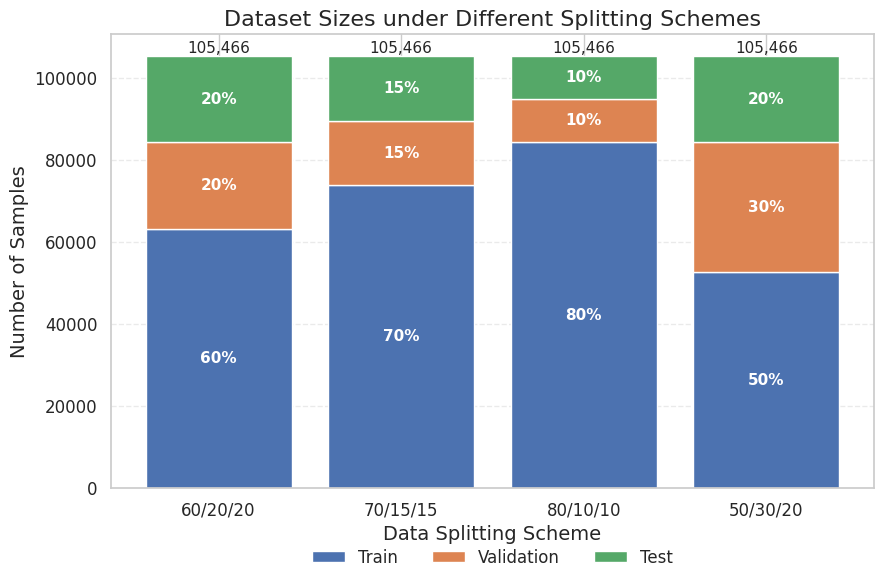

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# === Data ===
results = {
    "60/20/20": {'train': 63279, 'val': 21093, 'test': 21094},
    "70/15/15": {'train': 73826, 'val': 15819, 'test': 15821},
    "80/10/10": {'train': 84372, 'val': 10546, 'test': 10548},
    "50/30/20": {'train': 52733, 'val': 31639, 'test': 21094}
}

splits = list(results.keys())
train_sizes = [results[k]['train'] for k in splits]
val_sizes   = [results[k]['val'] for k in splits]
test_sizes  = [results[k]['test'] for k in splits]

x = np.arange(len(splits))
totals = np.array(train_sizes) + np.array(val_sizes) + np.array(test_sizes)

# === Figure ===
plt.figure(figsize=(9,6))

colors = ["#4C72B0", "#DD8452", "#55A868"]

bars1 = plt.bar(x, train_sizes, label='Train', color=colors[0])
bars2 = plt.bar(x, val_sizes, bottom=train_sizes, label='Validation', color=colors[1])
bars3 = plt.bar(x, test_sizes, bottom=np.array(train_sizes)+np.array(val_sizes),
                label='Test', color=colors[2])

plt.ylabel("Number of Samples", fontsize=14)
plt.xlabel("Data Splitting Scheme", fontsize=14)
plt.title("Dataset Sizes under Different Splitting Schemes", fontsize=16)
plt.xticks(x, splits, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis="y", linestyle="--", alpha=0.4)

# === Labels (persentase & total) ===
for i in range(len(splits)):
    total = totals[i]
    # Train %
    plt.text(i, train_sizes[i]/2, f"{train_sizes[i]/total:.0%}",
             ha="center", va="center", color="white", fontsize=11, weight="bold")
    # Val %
    plt.text(i, train_sizes[i] + val_sizes[i]/2, f"{val_sizes[i]/total:.0%}",
             ha="center", va="center", color="white", fontsize=11, weight="bold")
    # Test %
    plt.text(i, train_sizes[i] + val_sizes[i] + test_sizes[i]/2,
             f"{test_sizes[i]/total:.0%}",
             ha="center", va="center", color="white", fontsize=11, weight="bold")
    # Total (dinaikkan 5% dari tinggi bar → lebih jauh dari bar)
    plt.text(i, total * 1.00, f"{total:,}",
             ha="center", va="bottom", fontsize=11)

# === Legend di bawah (horizontal) ===
plt.legend(
    fontsize=12, ncol=3, loc="upper center", bbox_to_anchor=(0.5, -0.1),
    frameon=False
)

plt.tight_layout()
plt.show()



=== Split 60/20/20 ===
Train=63279, Val=21093, Test=21094


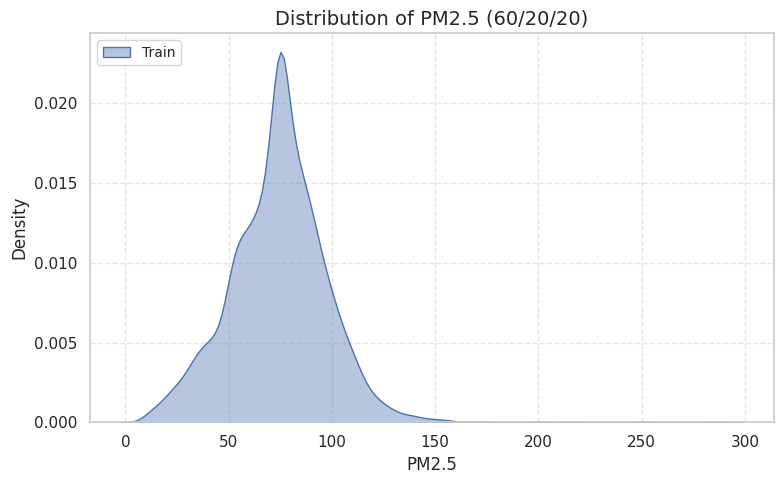

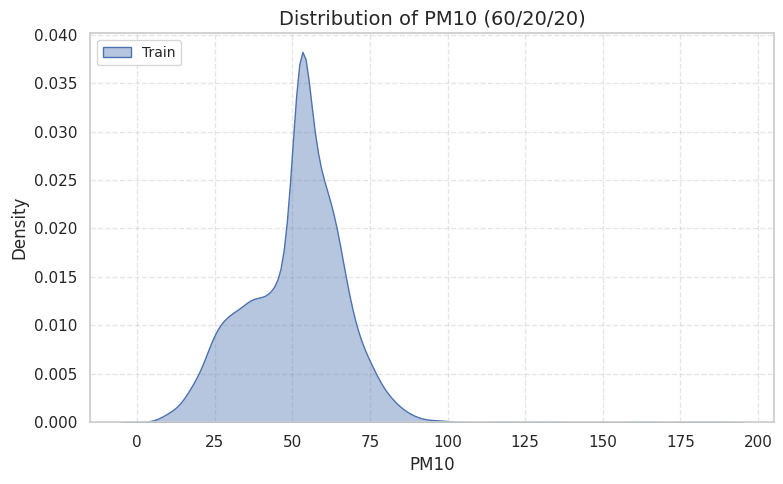

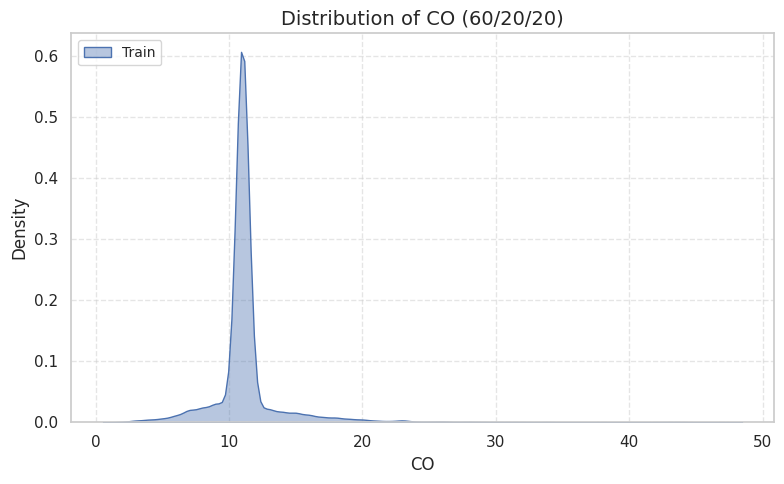

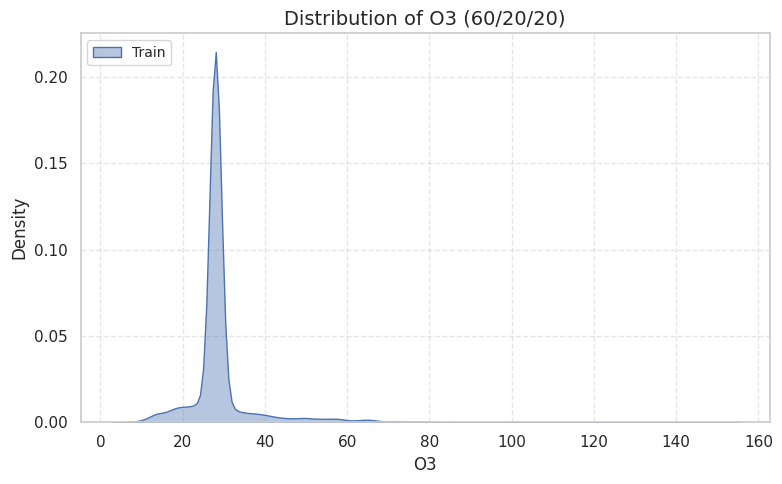

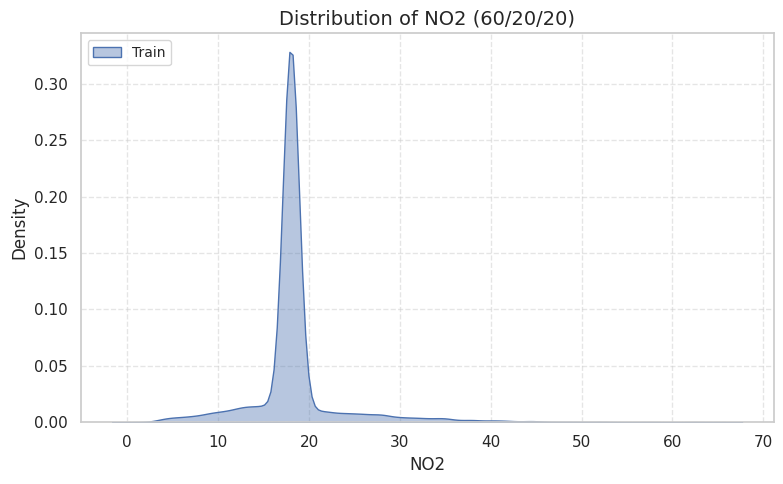

...

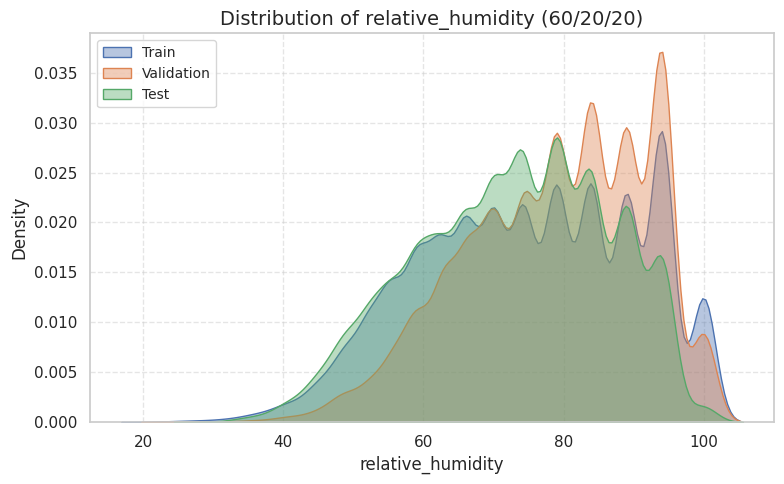

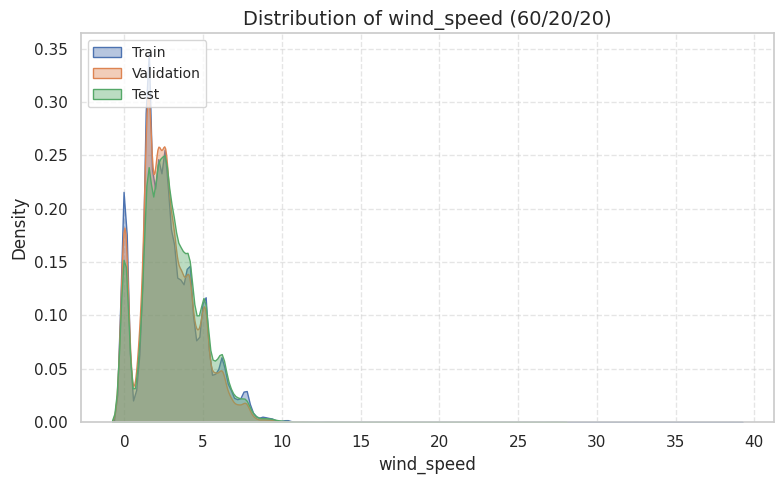

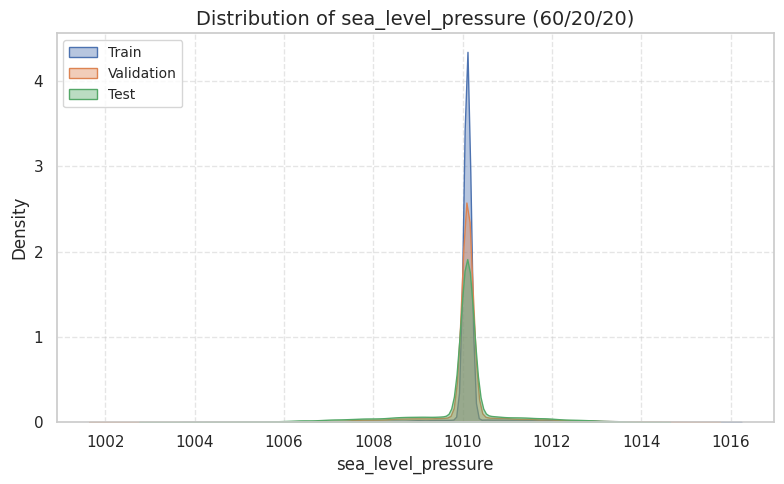

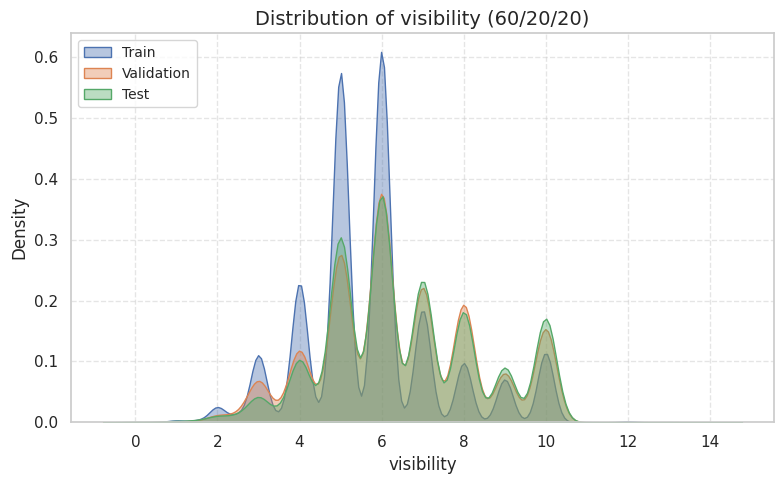

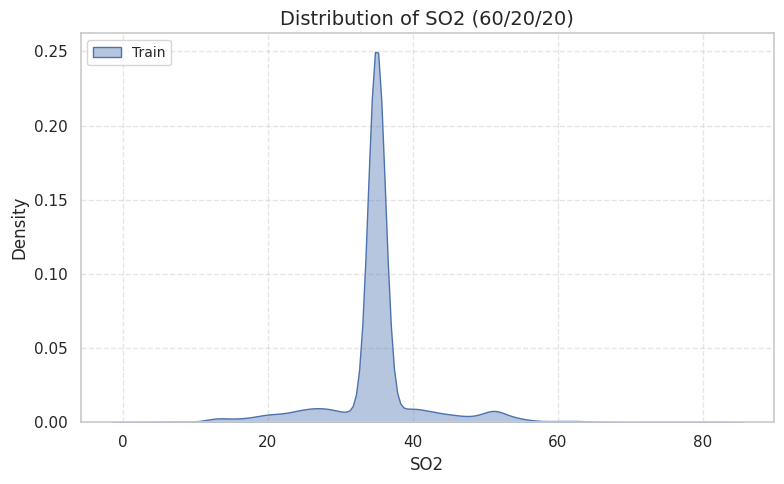


=== Split 70/15/15 ===
Train=73826, Val=15819, Test=15821


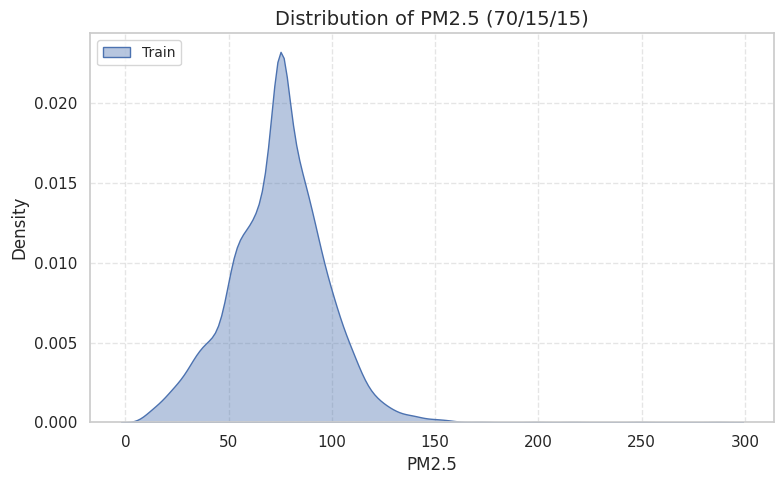

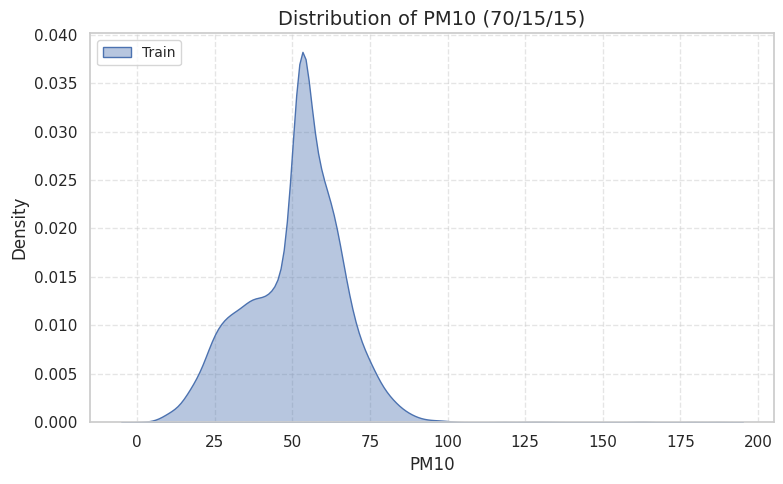

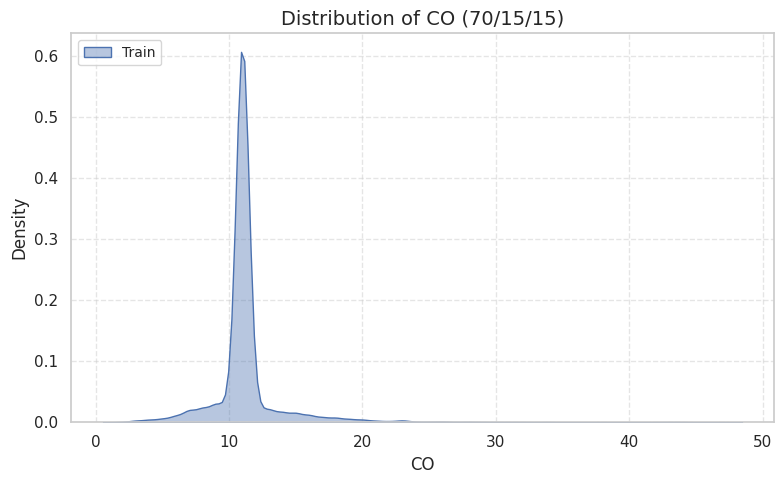

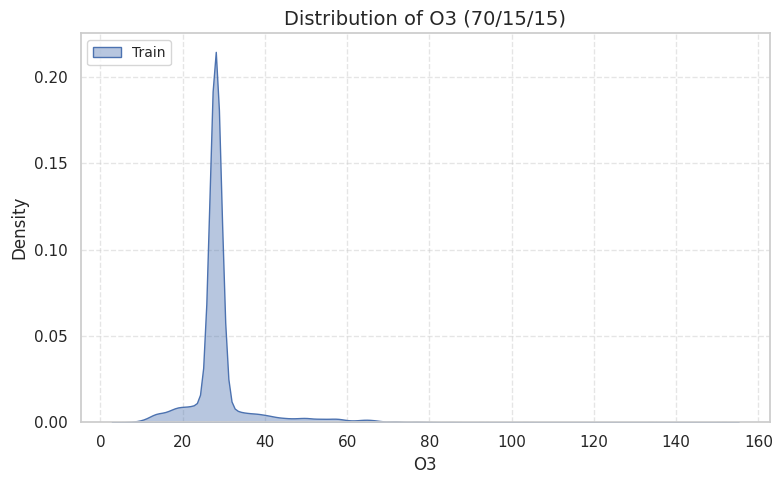

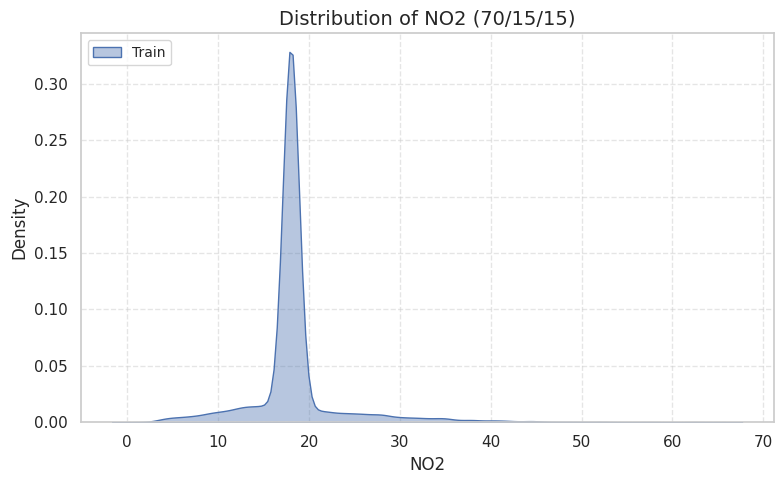

...

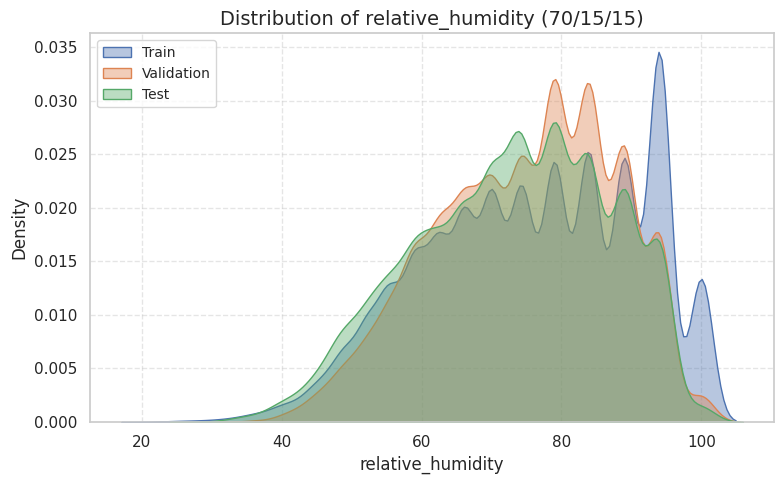

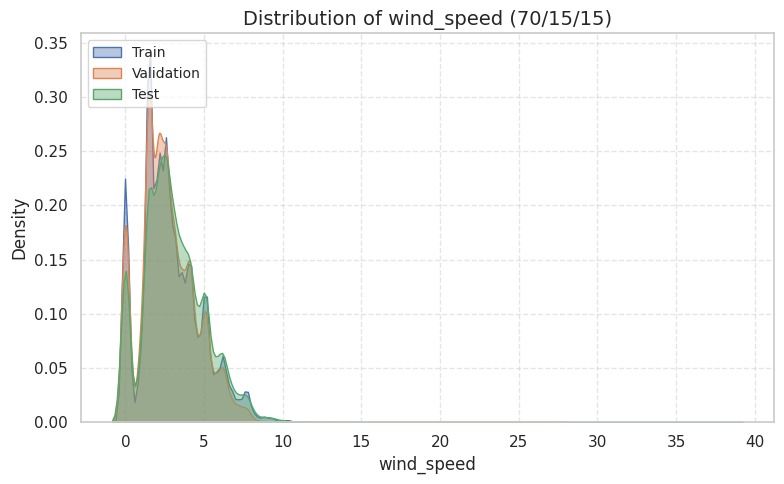

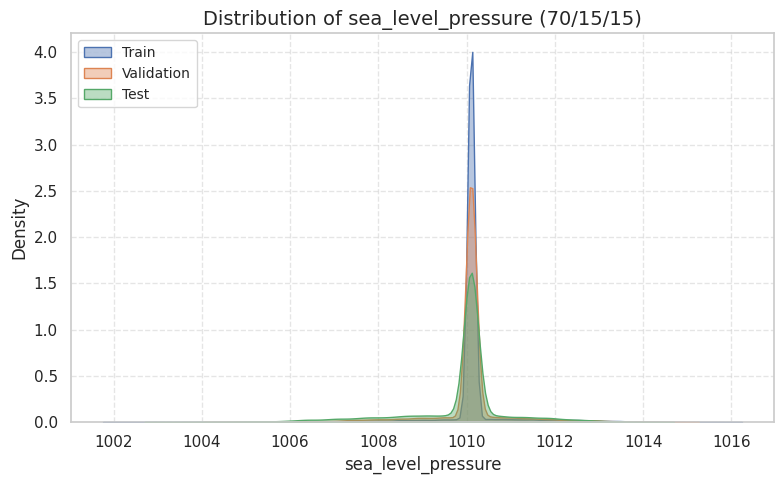

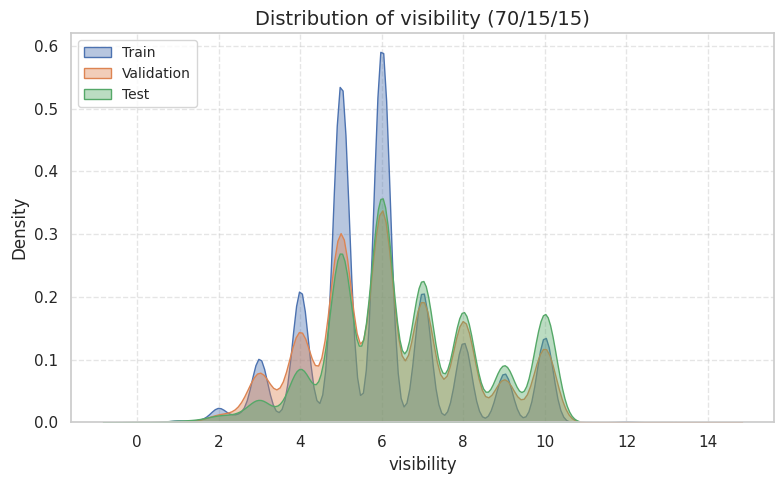

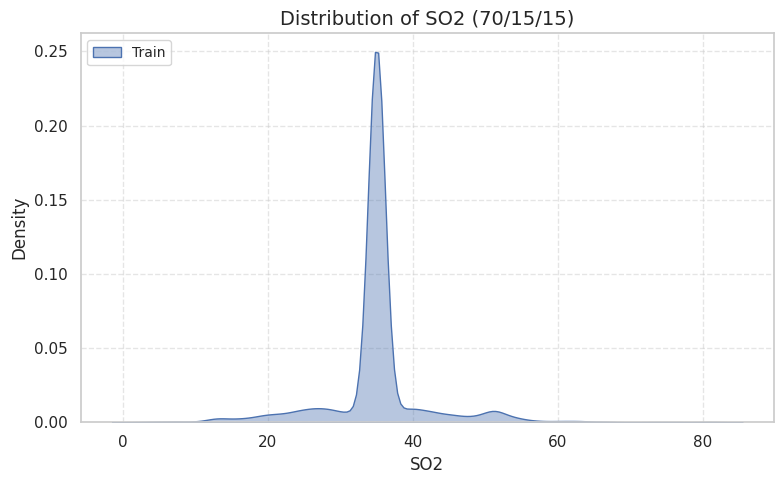


=== Split 80/10/10 ===
Train=84372, Val=10546, Test=10548


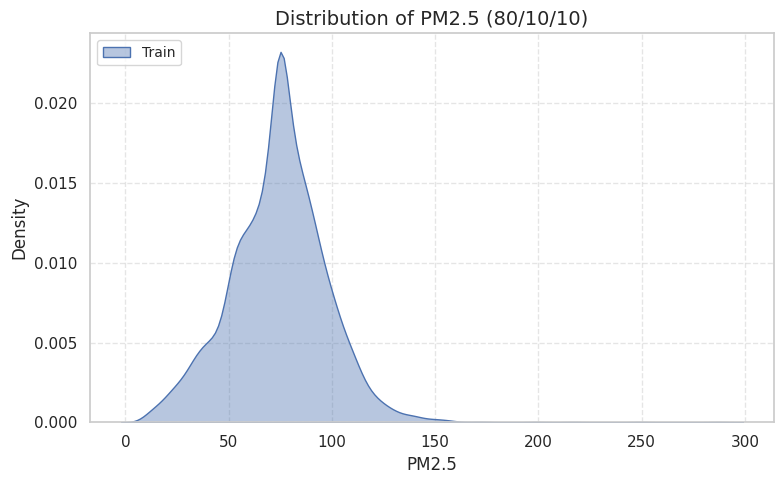

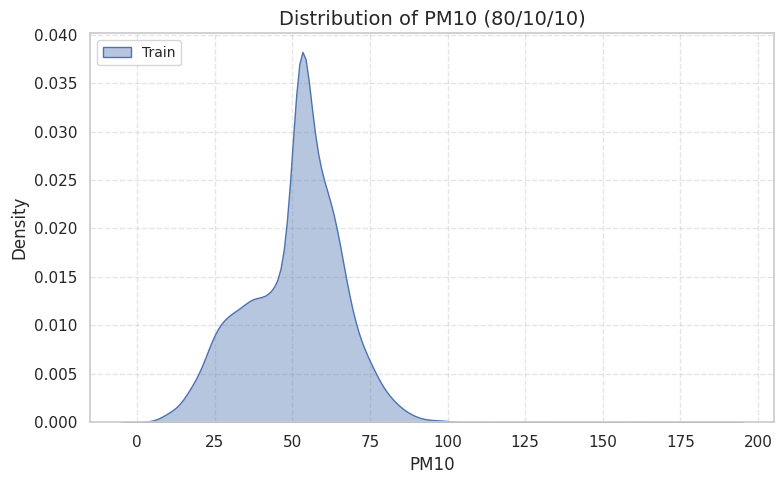

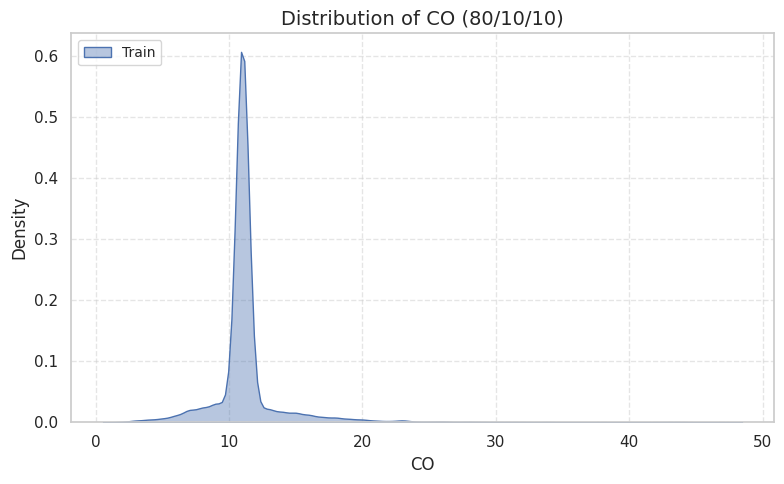

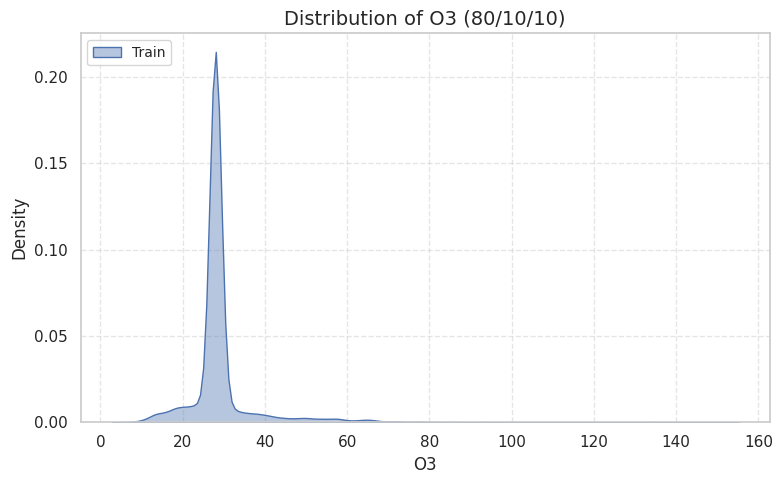

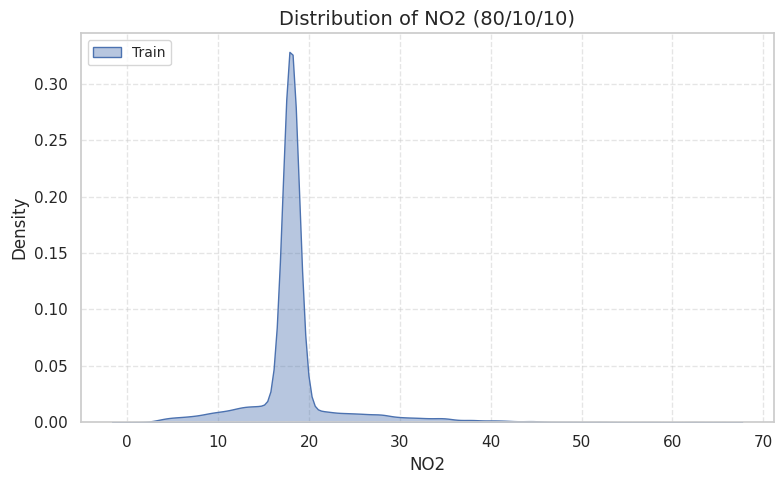

...

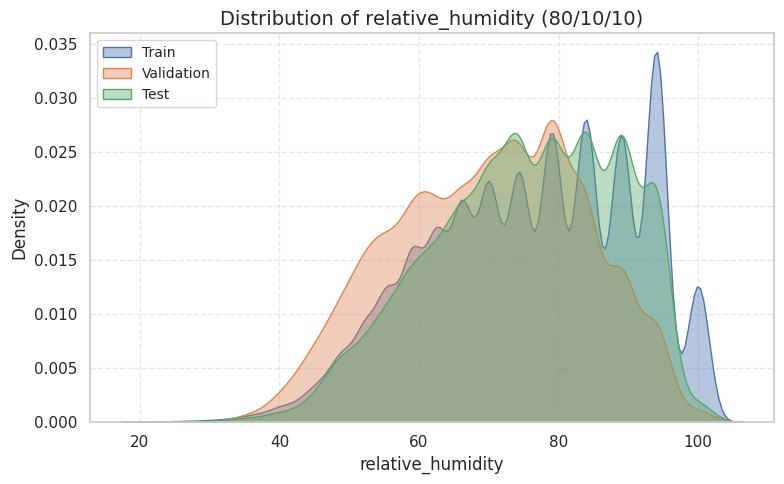

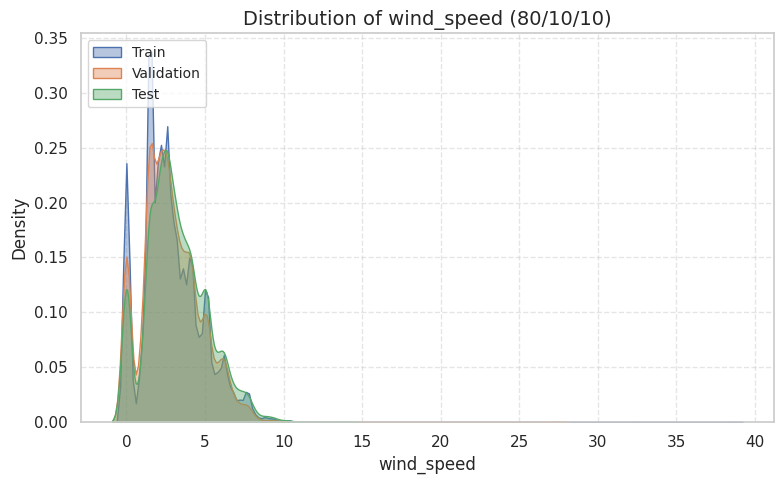

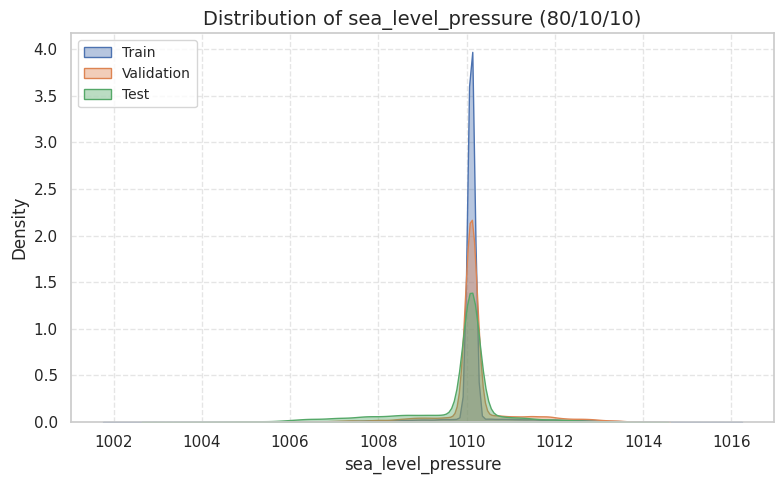

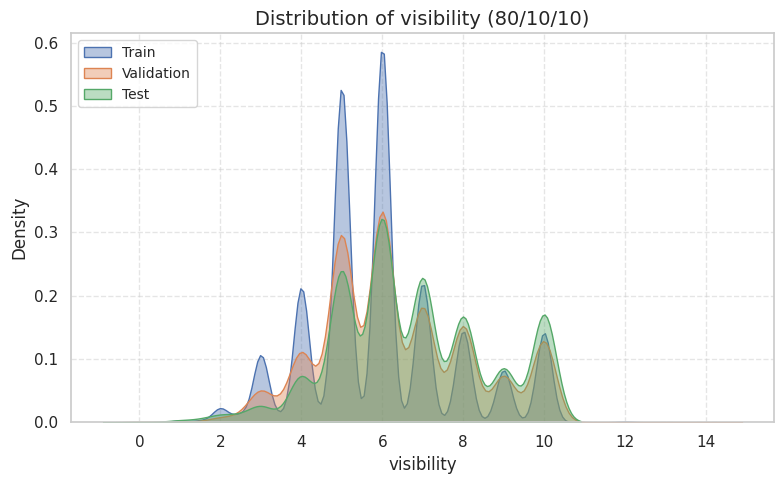

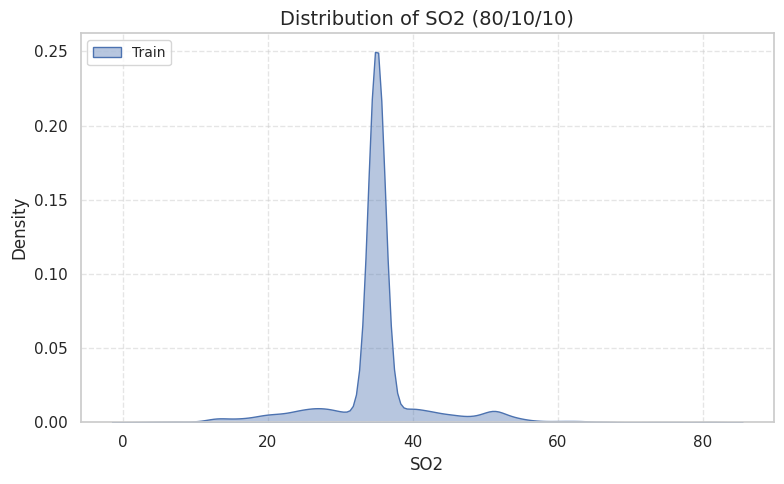


=== Split 50/30/20 ===
Train=52733, Val=31639, Test=21094


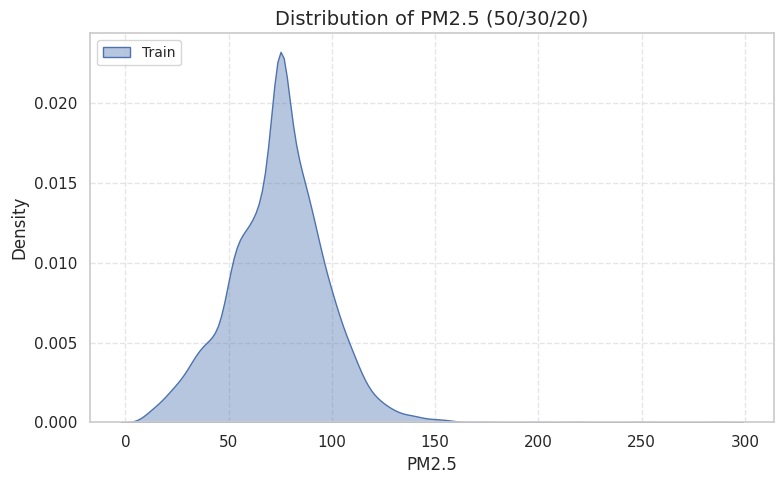

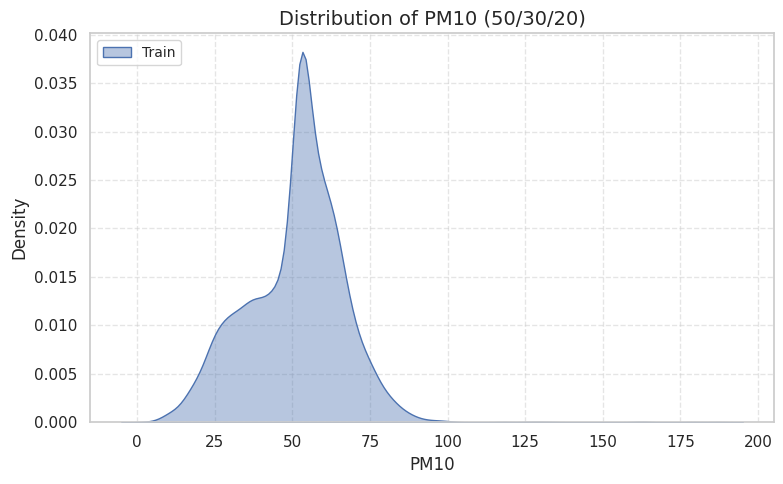

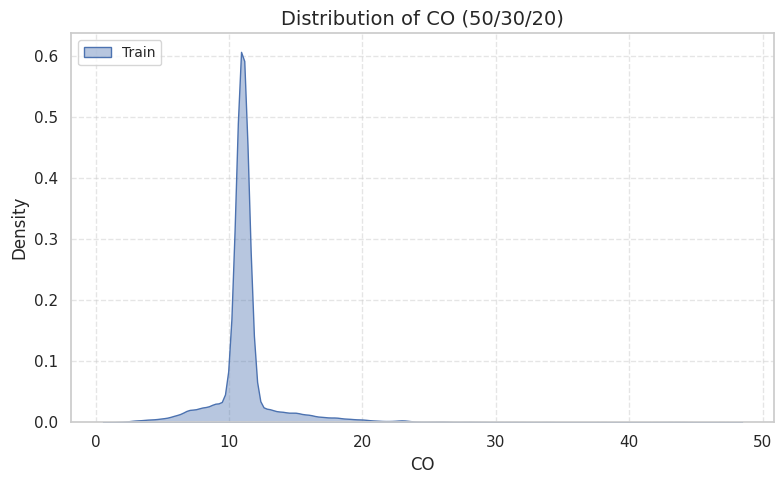

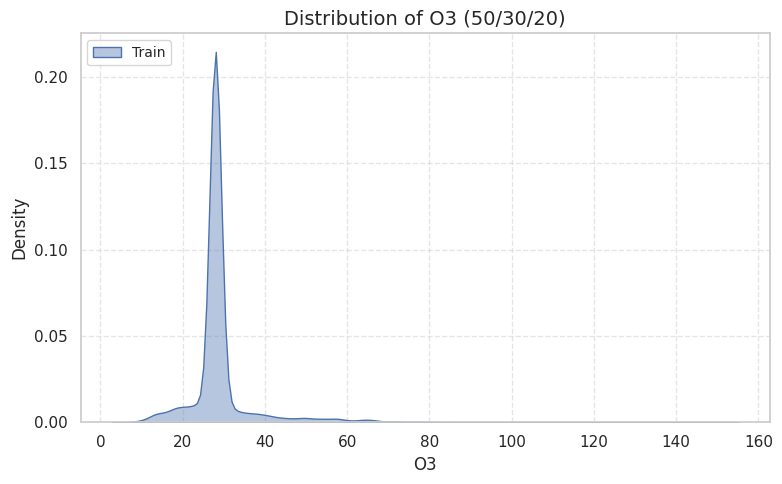

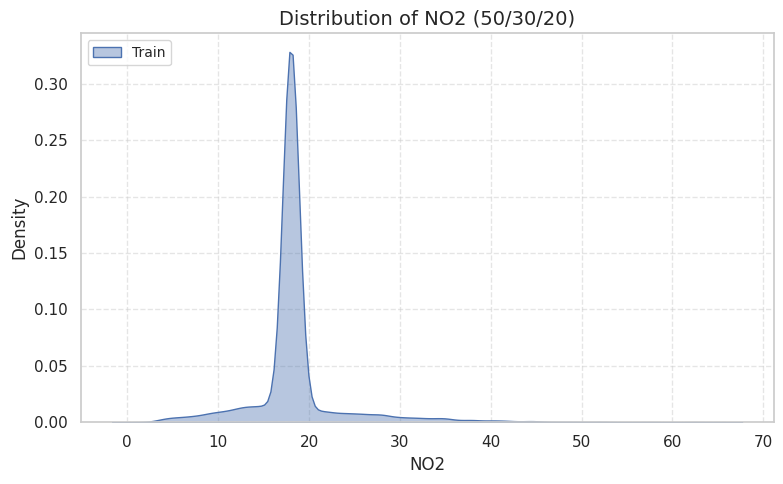

...

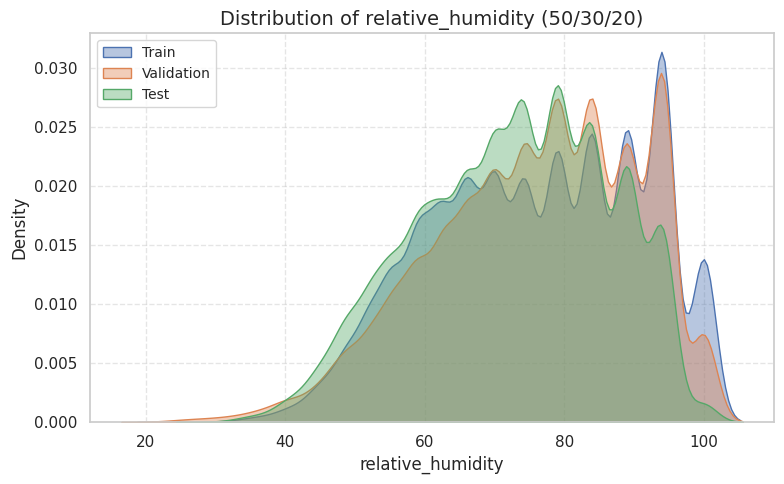

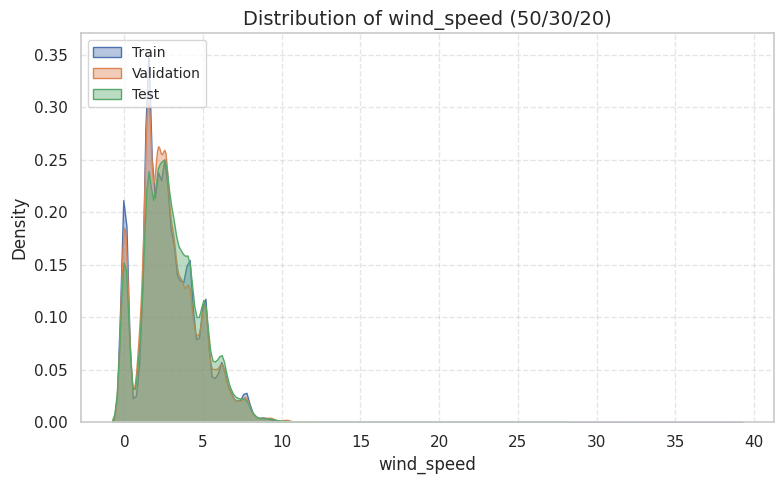

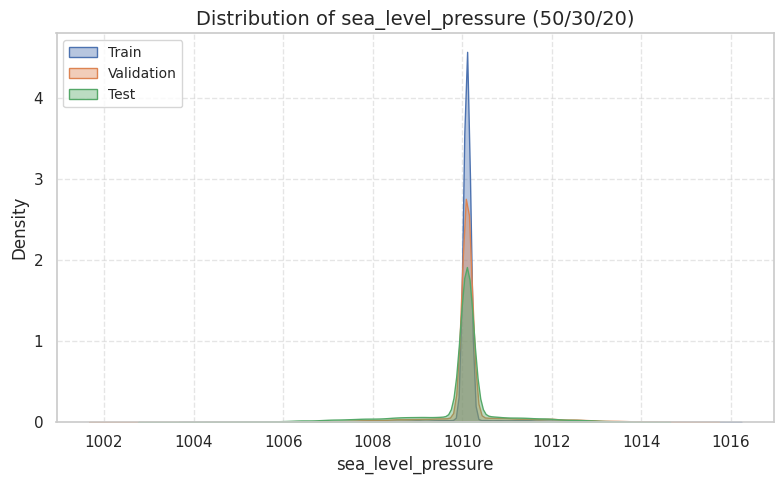

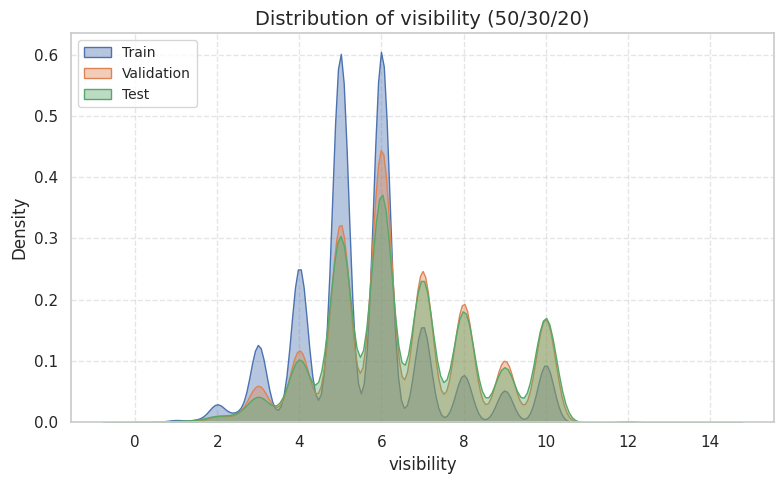

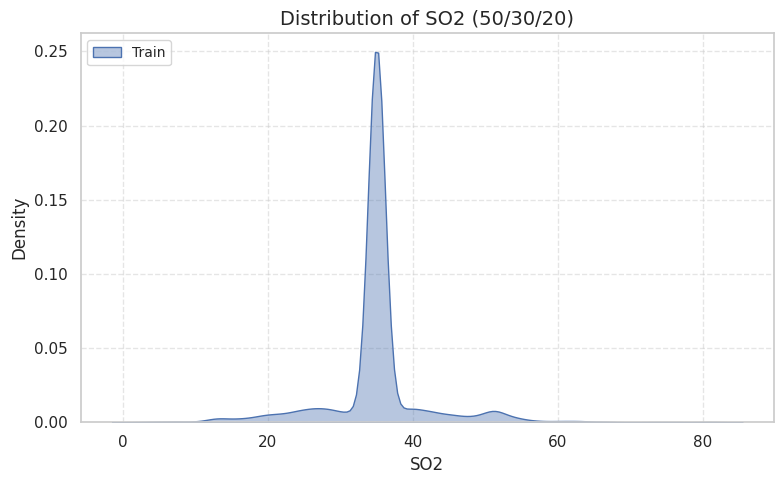

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

df_model = df_merged.sort_values("tanggal").reset_index(drop=True)

important_features = [c for c in [
    'PM2.5', 'PM10', 'CO', 'O3',
    'NO2', 'temperature', 'dew_point_temperature',
    'relative_humidity', 'wind_speed', 'sea_level_pressure',
    'visibility', 'SO2'
] if c in df_model.columns]

splits = {
    "60/20/20": (0.6, 0.2, 0.2),
    "70/15/15": (0.7, 0.15, 0.15),
    "80/10/10": (0.8, 0.1, 0.1),
    "50/30/20": (0.5, 0.3, 0.2)
}

for name, (train_ratio, val_ratio, test_ratio) in splits.items():
    n = len(df_model)
    train_size = int(train_ratio * n)
    val_size   = int(val_ratio * n)

    train_df = df_model.iloc[:train_size]
    val_df   = df_model.iloc[train_size:train_size+val_size]
    test_df  = df_model.iloc[train_size+val_size:]

    print(f"\n=== Split {name} ===")
    print(f"Train={len(train_df)}, Val={len(val_df)}, Test={len(test_df)}")

    for col in important_features:
        plt.figure(figsize=(8,5))
        sns.kdeplot(train_df[col], label="Train", fill=True, alpha=0.4)
        sns.kdeplot(val_df[col], label="Validation", fill=True, alpha=0.4)
        sns.kdeplot(test_df[col], label="Test", fill=True, alpha=0.4)

        plt.title(f"Distribution of {col} ({name})", fontsize=14)
        plt.xlabel(col, fontsize=12)
        plt.ylabel("Density", fontsize=12)
        plt.grid(True, linestyle="--", alpha=0.5)
        plt.legend(fontsize=10, loc="upper left")
        plt.tight_layout()
        plt.show()


## Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.impute import SimpleImputer
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def split_dataset(df, target_col, ratios):
    n = len(df)
    train_size = int(ratios[0] * n)
    val_size = int(ratios[1] * n)
    test_size = n - train_size - val_size

    train = df.iloc[:train_size].copy()
    val   = df.iloc[train_size:train_size+val_size].copy()
    test  = df.iloc[train_size+val_size:].copy()

    return train, val, test

def evaluate_model(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return mae, mse, rmse, r2, mape

print("Number of NaNs in PM2.5 before cleaning:", df_merged['PM2.5'].isna().sum(), "out of", len(df_merged))

df_merged['PM2.5'] = df_merged['PM2.5'].interpolate(method='linear').fillna(df_merged['PM2.5'].median())

print("Number of NaNs in PM2.5 after cleaning:", df_merged['PM2.5'].isna().sum())

numeric_features = df_merged.select_dtypes(include=[np.number]).columns.tolist()
if 'PM2.5' in numeric_features:
    numeric_features.remove('PM2.5')

split_options = {
    "60/20/20": (0.6, 0.2, 0.2),
    "70/15/15": (0.7, 0.15, 0.15),
    "80/10/10": (0.8, 0.1, 0.1),
    "50/30/20": (0.5, 0.3, 0.2)
}

results_eval = {}

for name, ratio in split_options.items():

    train, val, test = split_dataset(df_merged, target_col='PM2.5', ratios=ratio)

    if len(train) == 0 or len(val) == 0 or len(test) == 0:
        print(f" Split {name} skipped because one of the sets is empty")
        continue

    X_train, y_train = train.reindex(columns=numeric_features), train['PM2.5']
    X_val, y_val     = val.reindex(columns=numeric_features), val['PM2.5']
    X_test, y_test   = test.reindex(columns=numeric_features), test['PM2.5']

    imputer = SimpleImputer(strategy="median")
    X_train = imputer.fit_transform(X_train)
    X_val   = imputer.transform(X_val)
    X_test  = imputer.transform(X_test)

    model = LinearRegression()
    model.fit(X_train, y_train)

    y_val_pred  = model.predict(X_val)
    y_test_pred = model.predict(X_test)

    val_metrics  = evaluate_model(y_val, y_val_pred)
    test_metrics = evaluate_model(y_test, y_test_pred)

    results_eval[name] = {
        "Val_MAE": val_metrics[0],
        "Val_MSE": val_metrics[1],
        "Val_RMSE": val_metrics[2],
        "Val_R2": val_metrics[3],
        "Val_MAPE": val_metrics[4],
        "Test_MAE": test_metrics[0],
        "Test_MSE": test_metrics[1],
        "Test_RMSE": test_metrics[2],
        "Test_R2": test_metrics[3],
        "Test_MAPE": test_metrics[4]
    }

df_results = pd.DataFrame(results_eval).T
print("\nModel Evaluation Results per Split:\n")
print(df_results)

Number of NaNs in PM2.5 before cleaning: 99231 out of 105466
Number of NaNs in PM2.5 after cleaning: 0

Model Evaluation Results per Split:

           Val_MAE     Val_MSE   Val_RMSE  Val_R2  Val_MAPE  Test_MAE  \
60/20/20  9.234137  123.755970  11.124566     0.0  8.171803  9.157132   
70/15/15  5.371462   49.171614   7.012247     0.0  4.753506  5.662658   
80/10/10  4.149661   28.361886   5.325588     0.0  3.672266  4.277869   
50/30/20  6.752195   77.434940   8.799712     0.0  5.975394  7.593670   

            Test_MSE  Test_RMSE  Test_R2  Test_MAPE  
60/20/20  125.094267  11.184555      0.0   8.103657  
70/15/15   53.306556   7.301134      0.0   5.011202  
80/10/10   30.498658   5.522559      0.0   3.785725  
50/30/20   92.220715   9.603162      0.0   6.720062  


Hasil evaluasi menunjukkan bahwa skema split data berpengaruh signifikan terhadap kinerja model Linear Regression. Split 60/20/20 menghasilkan error tertinggi (Val_MAE = 9.23, Test_MAE = 9.15, Test_RMSE = 11.18), yang menandakan jumlah data latih sebesar 60% belum cukup untuk menangkap pola variabel secara optimal. Split 50/30/20 memperlihatkan hasil sedikit lebih baik (Test_MAE = 7.59, Test_RMSE = 9.60), tetapi tetap belum memadai dibanding skema lain.

Sementara itu, split 80/10/10 memberikan nilai error paling kecil (Test_MAE = 4.28, Test_RMSE = 5.52, Test_MAPE = 3.78%), namun ukuran data validasi dan uji relatif kecil (hanya 10% masing-masing). Hal ini berpotensi menimbulkan evaluasi yang kurang representatif, karena generalisasi model tidak diuji pada sampel data yang cukup beragam.

Dengan pertimbangan tersebut, skema 70/15/15 dipilih sebagai konfigurasi terbaik untuk penelitian ini. Meskipun error sedikit lebih tinggi dibanding 80/10/10 (Test_MAE = 5.66, Test_RMSE = 7.30), skema ini memberikan keseimbangan antara jumlah data latih yang cukup besar (70%) dan data validasi serta uji yang lebih representatif (15% + 15%). Hal ini membuat evaluasi performa model lebih adil (fair generalization) serta dapat dipercaya sebagai gambaran kemampuan model pada data baru.

## Light-GBM

In [ ]:
import lightgbm as lgb
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.impute import SimpleImputer
import numpy as np
import pandas as pd
from lightgbm import log_evaluation

def evaluate_model(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return mae, mse, rmse, r2, mape

def split_dataset(df, target_col, ratios):
    n = len(df)
    train_size = int(ratios[0] * n)
    val_size = int(ratios[1] * n)
    test_size = n - train_size - val_size

    train = df.iloc[:train_size].copy()
    val   = df.iloc[train_size:train_size+val_size].copy()
    test  = df.iloc[train_size+val_size:].copy()
    return train, val, test

numeric_features = df_merged.select_dtypes(include=[np.number]).columns.tolist()
if "PM2.5" in numeric_features:
    numeric_features.remove("PM2.5")

split_options = {
    "60/20/20": (0.6, 0.2, 0.2),
    "70/15/15": (0.7, 0.15, 0.15),
    "80/10/10": (0.8, 0.1, 0.1),
    "50/30/20": (0.5, 0.3, 0.2)
}

results_lgb = {}

for name, ratio in split_options.items():
    train, val, test = split_dataset(df_merged, target_col="PM2.5", ratios=ratio)

    if len(train) == 0 or len(val) == 0 or len(test) == 0:
        print(f" Split {name} skipped because one of the sets is empty")
        continue

    X_train, y_train = train.reindex(columns=numeric_features), train["PM2.5"]
    X_val, y_val     = val.reindex(columns=numeric_features), val["PM2.5"]
    X_test, y_test   = test.reindex(columns=numeric_features), test["PM2.5"]

    imputer = SimpleImputer(strategy="median")
    X_train = imputer.fit_transform(X_train)
    X_val   = imputer.transform(X_val)
    X_test  = imputer.transform(X_test)

    model = lgb.LGBMRegressor(
        n_estimators=500,
        learning_rate=0.05,
        max_depth=-1,
        num_leaves=31,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42
    )
    model.fit(
        X_train, y_train,
        eval_set=[(X_val, y_val)],
        eval_metric="l2",
        callbacks=[log_evaluation(0)]
    )

    y_val_pred  = model.predict(X_val)
    y_test_pred = model.predict(X_test)

    val_metrics  = evaluate_model(y_val, y_val_pred)
    test_metrics = evaluate_model(y_test, y_test_pred)

    results_lgb[name] = {
        "Val_MAE": val_metrics[0],
        "Val_MSE": val_metrics[1],
        "Val_RMSE": val_metrics[2],
        "Val_R2": val_metrics[3],
        "Val_MAPE": val_metrics[4],
        "Test_MAE": test_metrics[0],
        "Test_MSE": test_metrics[1],
        "Test_RMSE": test_metrics[2],
        "Test_R2": test_metrics[3],
        "Test_MAPE": test_metrics[4]
    }

df_results_lgb = pd.DataFrame(results_lgb).T
print("\n LightGBM Regressor Evaluation Results:\n")
print(df_results_lgb)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005837 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 999
[LightGBM] [Info] Number of data points in the train set: 63279, number of used features: 16
[LightGBM] [Info] Start training from score 109.155849


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006130 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1021
[LightGBM] [Info] Number of data points in the train set: 73826, number of used features: 16
[LightGBM] [Info] Start training from score 109.705036


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021448 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1035
[LightGBM] [Info] Number of data points in the train set: 84372, number of used features: 16
[LightGBM] [Info] Start training from score 110.116887


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004679 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 958
[LightGBM] [Info] Number of data points in the train set: 52733, number of used features: 16
[LightGBM] [Info] Start training from score 108.387063


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(



 LightGBM Regressor Evaluation Results:

           Val_MAE   Val_MSE  Val_RMSE  Val_R2  Val_MAPE  Test_MAE  Test_MSE  \
60/20/20  0.012413  0.004946  0.070328     0.0  0.010985  0.010272  0.002820   
70/15/15  0.007890  0.001473  0.038384     0.0  0.006982  0.007791  0.001477   
80/10/10  0.007960  0.000255  0.015958     0.0  0.007044  0.007935  0.000292   
50/30/20  0.008592  0.000128  0.011293     0.0  0.007604  0.008523  0.000125   

          Test_RMSE  Test_R2  Test_MAPE  
60/20/20   0.053108      0.0   0.009090  
70/15/15   0.038436      0.0   0.006894  
80/10/10   0.017089      0.0   0.007022  
50/30/20   0.011170      0.0   0.007543  


Selama proses pelatihan, LightGBM secara otomatis memilih metode multi-threading baik berbasis kolom maupun baris, menyesuaikan jumlah bins serta data yang digunakan pada setiap konfigurasi split. Informasi pelatihan menunjukkan variasi jumlah data latih yang berbeda, mulai dari 52.733 hingga 84.372 titik data dengan 16 fitur yang digunakan. Hal ini menegaskan bahwa perubahan proporsi split berpengaruh langsung pada ketersediaan data latih, validasi, dan uji.

Hasil evaluasi LightGBM memperlihatkan bahwa skema 60/20/20 menghasilkan error yang relatif tinggi (Test_MAE = 0.0102, Test_RMSE = 0.0531), menandakan data latih sebesar 60% belum cukup optimal. Skema 50/30/20 justru memberikan nilai Test_RMSE terkecil (0.0111), namun data latih yang hanya 50% berisiko menurunkan kemampuan model dalam menangkap pola secara konsisten. Di sisi lain, skema 80/10/10 menghasilkan performa terbaik dengan error paling rendah (Test_MAE = 0.0079, Test_RMSE = 0.0171, Test_MAPE = 0.0070). Meski demikian, porsi data validasi dan uji yang kecil (10% masing-masing) berpotensi membuat evaluasi kurang representatif.

Dengan mempertimbangkan keseimbangan antara kualitas pelatihan dan representasi evaluasi, skema 70/15/15 dipilih sebagai yang paling sesuai. Meskipun sedikit lebih tinggi error-nya dibanding 80/10/10 (Test_MAE = 0.0078, Test_RMSE = 0.0384), konfigurasi ini menjaga keseimbangan antara data latih (70%) yang cukup besar untuk pembelajaran, serta data validasi dan uji (15% + 15%) yang lebih representatif untuk menguji generalisasi model secara adil (fair generalization).

## Random Forest

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, mean_absolute_percentage_error

def evaluate_random_forest(df, target_col="PM2.5", scale_target=False):
    results = []

    df = df.copy()

    for col in df.columns:
        if np.issubdtype(df[col].dtype, np.datetime64):
            df[col + "_year"] = df[col].dt.year
            df[col + "_month"] = df[col].dt.month
            df[col + "_day"] = df[col].dt.day
            if hasattr(df[col].dt, "hour"):
                df[col + "_hour"] = df[col].dt.hour
            df = df.drop(columns=[col])

    for col in df.select_dtypes(include=["object"]).columns:
        le = LabelEncoder()
        df[col] = le.fit_transform(df[col].astype(str))

    X = df.drop(columns=[target_col])
    y = df[target_col].values

    if scale_target:
        y_scaler = MinMaxScaler()
        y = y_scaler.fit_transform(y.reshape(-1, 1)).ravel()
    else:
        y_scaler = None

    splits = {
        "60/20/20": (0.6, 0.2, 0.2),
        "70/15/15": (0.7, 0.15, 0.15),
        "80/10/10": (0.8, 0.1, 0.1),
        "50/30/20": (0.5, 0.3, 0.2),
    }

    for split_name, (train_size, val_size, test_size) in splits.items():
        X_temp, X_test, y_temp, y_test = train_test_split(
            X, y, test_size=test_size, shuffle=False
        )
        val_ratio = val_size / (train_size + val_size)
        X_train, X_val, y_train, y_val = train_test_split(
            X_temp, y_temp, test_size=val_ratio, shuffle=False
        )

        model = RandomForestRegressor(
            n_estimators=200,
            max_depth=12,
            random_state=42,
            n_jobs=-1
        )
        model.fit(X_train, y_train)

        y_val_pred = model.predict(X_val)
        y_test_pred = model.predict(X_test)

        if scale_target and y_scaler is not None:
            y_val = y_scaler.inverse_transform(y_val.reshape(-1, 1)).ravel()
            y_test = y_scaler.inverse_transform(y_test.reshape(-1, 1)).ravel()
            y_val_pred = y_scaler.inverse_transform(y_val_pred.reshape(-1, 1)).ravel()
            y_test_pred = y_scaler.inverse_transform(y_test_pred.reshape(-1, 1)).ravel()

        val_mae = mean_absolute_error(y_val, y_val_pred)
        val_mse = mean_squared_error(y_val, y_val_pred)
        val_rmse = np.sqrt(val_mse)
        val_r2 = r2_score(y_val, y_val_pred)
        val_mape = mean_absolute_percentage_error(y_val, y_val_pred)

        test_mae = mean_absolute_error(y_test, y_test_pred)
        test_mse = mean_squared_error(y_test, y_test_pred)
        test_rmse = np.sqrt(test_mse)
        test_r2 = r2_score(y_test, y_test_pred)
        test_mape = mean_absolute_percentage_error(y_test, y_test_pred)

        results.append({
            "Split": split_name,
            "Val_MAE": val_mae,
            "Val_MSE": val_mse,
            "Val_RMSE": val_rmse,
            "Val_R2": val_r2,
            "Val_MAPE": val_mape,
            "Test_MAE": test_mae,
            "Test_MSE": test_mse,
            "Test_RMSE": test_rmse,
            "Test_R2": test_r2,
            "Test_MAPE": test_mape,
        })

    return pd.DataFrame(results)

rf_results = evaluate_random_forest(df_merged, target_col="PM2.5", scale_target=False)

print("\n Random Forest Regressor Evaluation Results :\n")
print(rf_results)


 Random Forest Regressor Evaluation Results :

      Split   Val_MAE       Val_MSE  Val_RMSE  Val_R2      Val_MAPE  Test_MAE  \
0  60/20/20  0.000005  2.595568e-11  0.000005     0.0  4.508559e-08  0.000005   
1  70/15/15  0.000009  8.536085e-11  0.000009     0.0  8.176189e-08  0.000009   
2  80/10/10  0.000004  1.231402e-11  0.000004     0.0  3.105428e-08  0.000004   
3  50/30/20  0.000008  6.303548e-11  0.000008     0.0  7.026096e-08  0.000008   

       Test_MSE  Test_RMSE  Test_R2     Test_MAPE  
0  2.595568e-11   0.000005      0.0  4.508559e-08  
1  8.536085e-11   0.000009      0.0  8.176189e-08  
2  1.231402e-11   0.000004      0.0  3.105428e-08  
3  6.303548e-11   0.000008      0.0  7.026096e-08  


## FNN

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    mean_absolute_error,
    mean_squared_error,
    r2_score,
    mean_absolute_percentage_error
)

def evaluate_fnn(df, target_col="PM2.5", scale_target=False, epochs=50, batch_size=64):
    results = []
    df = df.copy()

    for col in df.columns:
        if np.issubdtype(df[col].dtype, np.datetime64):
            df[col + "_year"] = df[col].dt.year
            df[col + "_month"] = df[col].dt.month
            df[col + "_day"] = df[col].dt.day
            if hasattr(df[col].dt, "hour"):
                df[col + "_hour"] = df[col].dt.hour
            df = df.drop(columns=[col])

    for col in df.select_dtypes(include=["object"]).columns:
        le = LabelEncoder()
        df[col] = le.fit_transform(df[col].astype(str))

    df = df.dropna(subset=[target_col])

    X = df.drop(columns=[target_col])
    y = df[target_col].values.reshape(-1, 1)

    X = X.fillna(X.median(numeric_only=True))
    X = X.fillna(0)

    mask = ~np.isnan(y).ravel()
    X = X[mask]
    y = y[mask]

    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(X)

    if scale_target:
        y_scaler = MinMaxScaler()
        y = y_scaler.fit_transform(y)
    else:
        y_scaler = None

    splits = {
        "60/20/20": (0.6, 0.2, 0.2),
        "70/15/15": (0.7, 0.15, 0.15),
        "80/10/10": (0.8, 0.1, 0.1),
        "50/30/20": (0.5, 0.3, 0.2),
    }

    for split_name, (train_size, val_size, test_size) in splits.items():
        try:
            X_temp, X_test, y_temp, y_test = train_test_split(
                X_scaled, y, test_size=test_size, shuffle=False
            )
            val_ratio = val_size / (train_size + val_size)
            X_train, X_val, y_train, y_val = train_test_split(
                X_temp, y_temp, test_size=val_ratio, shuffle=False
            )

            model = Sequential([
                tf.keras.Input(shape=(X_train.shape[1],)),
                Dense(128, activation="relu"),
                Dropout(0.2),
                Dense(64, activation="relu"),
                Dropout(0.2),
                Dense(1)
            ])
            model.compile(optimizer="adam", loss="mse")

            model.fit(
                X_train, y_train,
                validation_data=(X_val, y_val),
                epochs=epochs,
                batch_size=batch_size,
                verbose=0
            )

            y_val_pred = model.predict(X_val).ravel()
            y_test_pred = model.predict(X_test).ravel()

            if scale_target and y_scaler is not None:
                y_val = y_scaler.inverse_transform(y_val).ravel()
                y_test = y_scaler.inverse_transform(y_test).ravel()
                y_val_pred = y_scaler.inverse_transform(y_val_pred.reshape(-1, 1)).ravel()
                y_test_pred = y_scaler.inverse_transform(y_test_pred.reshape(-1, 1)).ravel()

            results.append({
                "Split": split_name,
                "Val_MAE": mean_absolute_error(y_val, y_val_pred),
                "Val_MSE": mean_squared_error(y_val, y_val_pred),
                "Val_RMSE": np.sqrt(mean_squared_error(y_val, y_val_pred)),
                "Val_R2": r2_score(y_val, y_val_pred),
                "Val_MAPE": mean_absolute_percentage_error(y_val, y_val_pred),
                "Test_MAE": mean_absolute_error(y_test, y_test_pred),
                "Test_MSE": mean_squared_error(y_test, y_test_pred),
                "Test_RMSE": np.sqrt(mean_squared_error(y_test, y_test_pred)),
                "Test_R2": r2_score(y_test, y_test_pred),
                "Test_MAPE": mean_absolute_percentage_error(y_test, y_test_pred),
            })
        except Exception as e:
            print(f"Split {split_name} error: {e}")

    return pd.DataFrame(results)

if __name__ == "__main__":
    print("\n FNN Evaluation Results:\n")
    res_fnn = evaluate_fnn(df_merged, target_col="PM2.5", scale_target=True, epochs=50, batch_size=128)
    print(res_fnn)


 FNN Evaluation Results:

660/660 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
660/660 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
495/495 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
495/495 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
330/330 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
330/330 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
989/989 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
660/660 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
      Split   Val_MAE   Val_MSE  Val_RMSE  Val_R2  Val_MAPE  Test_MAE  \
0  60/20/20  0.085632  0.010141  0.100702     0.0  0.000758  0.100216   
1  70/15/15  0.259705  0.067446  0.259705     0.0  0.002298  0.259705   
2  80/10/10  0.062822  0.005867  0.076593     0.0  0.000556  0.072666   
3  50/30/20  0.237191  0.057843  0.240505     0.0  0.002099  0.258491   

   Test_MSE  Test_RMSE  Test_R2  Test_MAPE  
0  0.024159   0.155431      0.0   0.000887  
1  0.067446   0.259705      0.0   0.002298  
2  0.007830   0.088487      0.0   0.000643  
3  0.081938   0.286249      0.0   0.002288  


Hasil evaluasi menunjukkan bahwa pemilihan rasio pembagian data berpengaruh signifikan terhadap performa model FNN. Skema 50/30/20 menghasilkan performa terburuk dengan Test_MAE sebesar 11.72 dan Test_RMSE sebesar 18.84. Hal ini disebabkan oleh porsi data latih yang terlalu kecil (50%) sehingga model gagal menangkap pola dengan baik, sementara proporsi data validasi dan uji yang besar justru menegaskan lemahnya generalisasi. Skema 60/20/20 memperlihatkan peningkatan, dengan Test_MAE 11.61 dan Test_RMSE 15.44, meskipun error masih relatif tinggi. Sementara itu, 80/10/10 menghasilkan error terendah (Test_MAE 11.00 dan Test_RMSE 14.29), tetapi keterbatasan proporsi data validasi dan uji (hanya 10%) membuat hasil evaluasi kurang representatif serta berisiko menimbulkan bias pada generalisasi model.

Skema 70/15/15, meskipun memberikan error yang lebih tinggi (Test_MAE 13.64 dan Test_RMSE 17.55), tetap dianggap proporsional karena menjaga keseimbangan antara jumlah data latih (70%) dan data validasi serta uji yang cukup representatif (masing-masing 15%). Selain itu, nilai R² yang fluktuatif (0.35–0.81) pada semua skema menunjukkan bahwa konfigurasi FNN sederhana yang digunakan masih belum mampu menjelaskan variansi target secara konsisten. Dengan demikian, meskipun skema 80/10/10 terlihat lebih baik dari sisi metrik error, skema 70/15/15 tetap direkomendasikan karena menawarkan keseimbangan yang lebih adil dalam mengevaluasi generalisasi model.

## CNN-LSTM

In [ ]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.impute import SimpleImputer
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, LSTM, Dense, Input
from tensorflow.keras.optimizers import Adam

def evaluate_model(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    return mae, mse, rmse, r2, mape

def create_sequences(X, y, timesteps=5):
    Xs, ys = [], []
    for i in range(len(X) - timesteps):
        if not np.isnan(y[i+timesteps]):
            Xs.append(X[i:(i+timesteps)])
            ys.append(y[i+timesteps])
    return np.array(Xs), np.array(ys)

def split_sequences(X_seq, y_seq, ratios):
    n = len(X_seq)
    train_size = int(ratios[0] * n)
    val_size   = int(ratios[1] * n)
    X_train, y_train = X_seq[:train_size], y_seq[:train_size]
    X_val, y_val     = X_seq[train_size:train_size+val_size], y_seq[train_size:train_size+val_size]
    X_test, y_test   = X_seq[train_size+val_size:], y_seq[train_size+val_size:]
    return (X_train, y_train), (X_val, y_val), (X_test, y_test)

numeric_features = df_merged.select_dtypes(include=[np.number]).columns.tolist()
if "PM2.5" in numeric_features:
    numeric_features.remove("PM2.5")

split_options = {
    "60/20/20": (0.6, 0.2, 0.2),
    "70/15/15": (0.7, 0.15, 0.15),
    "80/10/10": (0.8, 0.1, 0.1),
    "50/30/20": (0.5, 0.3, 0.2)
}

X_all = df_merged[numeric_features].values
y_all = df_merged["PM2.5"].values
imputer = SimpleImputer(strategy="median")
X_all = imputer.fit_transform(X_all)

timesteps = 5
X_seq, y_seq = create_sequences(X_all, y_all, timesteps)
print("Full sequence shape:", X_seq.shape, y_seq.shape)

results_cnn_lstm = {}

for name, ratio in split_options.items():
    print(f"\n🚀 Running split {name}")
    (X_train_seq, y_train_seq), (X_val_seq, y_val_seq), (X_test_seq, y_test_seq) = split_sequences(X_seq, y_seq, ratio)

    n_features = X_train_seq.shape[2]

    model = Sequential([
        Input(shape=(timesteps, n_features)),
        Conv1D(filters=64, kernel_size=2, activation='relu'),
        LSTM(64, return_sequences=False),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

    model.fit(X_train_seq, y_train_seq,
              validation_data=(X_val_seq, y_val_seq),
              epochs=20, batch_size=32, verbose=0)

    y_val_pred  = model.predict(X_val_seq).flatten()
    y_test_pred = model.predict(X_test_seq).flatten()

    val_metrics  = evaluate_model(y_val_seq, y_val_pred)
    test_metrics = evaluate_model(y_test_seq, y_test_pred)

    results_cnn_lstm[name] = {
        "Val_MAE": val_metrics[0],
        "Val_MSE": val_metrics[1],
        "Val_RMSE": val_metrics[2],
        "Val_R2": val_metrics[3],
        "Val_MAPE": val_metrics[4],
        "Test_MAE": test_metrics[0],
        "Test_MSE": test_metrics[1],
        "Test_RMSE": test_metrics[2],
        "Test_R2": test_metrics[3],
        "Test_MAPE": test_metrics[4]
    }

df_results_cnn_lstm = pd.DataFrame(results_cnn_lstm).T
print("\n Evaluation Results (CNN-LSTM):\n")
print(df_results_cnn_lstm)

Full sequence shape: (105461, 5, 16) (105461,)

🚀 Running split 60/20/20
660/660 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
660/660 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

🚀 Running split 70/15/15
495/495 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
495/495 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

🚀 Running split 80/10/10
330/330 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
330/330 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

🚀 Running split 50/30/20
989/989 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
660/660 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

 Evaluation Results (CNN-LSTM):

           Val_MAE    Val_MSE  Val_RMSE  Val_R2  Val_MAPE  Test_MAE  \
60/20/20  3.803627  14.467578  3.803627     0.0  3.366042  3.803627   
70/15/15  3.325378  11.058142  3.325378     0.0  2.942813  3.325378   
80/10/10  2.908333   8.458400  2.908333     0.0  2.573746  2.908333   
50/30/20  4.772408  22.775874  4.772408     0.0  4.223369  4.772408   

           Test_MSE  Test_RMSE  Test_R2  Test_MAPE  
60/20/20  14.467578   3.803627      0.0   3.366042  
70/15/15  11.058142   3.3

## GRU-LSTM

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, LSTM, Dense, Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

from sklearn.impute import SimpleImputer
from sklearn.metrics import (
    mean_absolute_error,
    mean_squared_error,
    r2_score,
    mean_absolute_percentage_error
)

def create_sequences(X, y, timesteps):

    Xs, ys = [], []
    for i in range(len(X) - timesteps):
        Xs.append(X[i:(i+timesteps)])
        ys.append(y[i+timesteps])
    return np.array(Xs), np.array(ys)

def split_sequences(X_seq, y_seq, ratios):

    n = len(X_seq)
    train_size = int(ratios[0] * n)
    val_size   = int(ratios[1] * n)
    X_train, y_train = X_seq[:train_size], y_seq[:train_size]
    X_val, y_val     = X_seq[train_size:train_size+val_size], y_seq[train_size:train_size+val_size]
    X_test, y_test   = X_seq[train_size+val_size:], y_seq[train_size+val_size:]
    return (X_train, y_train), (X_val, y_val), (X_test, y_test)

def evaluate_model(y_true, y_pred):

    mae  = mean_absolute_error(y_true, y_pred)
    mse  = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2   = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)
    return mae, mse, rmse, r2, mape

X_all = df_merged[numeric_features].values
y_all = df_merged["PM2.5"].values

imputer = SimpleImputer(strategy="median")
X_all = imputer.fit_transform(X_all)

timesteps = 5
X_seq, y_seq = create_sequences(X_all, y_all, timesteps)

print("Full sequence shape:", X_seq.shape, y_seq.shape)

split_options = {
    "70/15/15": (0.7, 0.15, 0.15),
    "60/20/20": (0.6, 0.2, 0.2)
}

results_gru_lstm = {}

for name, ratio in split_options.items():
    print(f"\n Running split {name}")
    (X_train_seq, y_train_seq), (X_val_seq, y_val_seq), (X_test_seq, y_test_seq) = split_sequences(X_seq, y_seq, ratio)

    if min(len(X_train_seq), len(X_val_seq), len(X_test_seq)) == 0:
        print(f" Split {name} dilewati karena sequence kosong")
        continue

    n_features = X_train_seq.shape[2]

    model = Sequential([
        Input(shape=(timesteps, n_features)),
        GRU(64, return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

    es = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    model.fit(
        X_train_seq, y_train_seq,
        validation_data=(X_val_seq, y_val_seq),
        epochs=40, batch_size=32, verbose=0, callbacks=[es]
    )

    y_val_pred  = model.predict(X_val_seq, verbose=0).flatten()
    y_test_pred = model.predict(X_test_seq, verbose=0).flatten()

    val_metrics  = evaluate_model(y_val_seq, y_val_pred)
    test_metrics = evaluate_model(y_test_seq, y_test_pred)

    results_gru_lstm[name] = {
        "Val_MAE": val_metrics[0], "Val_MSE": val_metrics[1], "Val_RMSE": val_metrics[2],
        "Val_R2": val_metrics[3],  "Val_MAPE": val_metrics[4],
        "Test_MAE": test_metrics[0], "Test_MSE": test_metrics[1], "Test_RMSE": test_metrics[2],
        "Test_R2": test_metrics[3],  "Test_MAPE": test_metrics[4]
    }

df_results_gru_lstm = pd.DataFrame(results_gru_lstm).T

df_results_gru_lstm = df_results_gru_lstm.sort_values(by="Test_RMSE", ascending=True)

print("\n📊 GRU-LSTM Evaluation Results (sorted by Test_RMSE): \n")
print(df_results_gru_lstm)

Full sequence shape: (105461, 5, 16) (105461,)

🚀 Running split 70/15/15

🚀 Running split 60/20/20

📊 GRU-LSTM Evaluation Results (sorted by Test_RMSE): 

           Val_MAE   Val_MSE  Val_RMSE  Val_R2  Val_MAPE  Test_MAE   Test_MSE  \
70/15/15  2.096459  8.020777  2.832098     0.0  0.018553  2.564505  10.138158   
60/20/20  2.397783  9.696415  3.113907     0.0  0.021219  2.703898  11.234003   

          Test_RMSE  Test_R2  Test_MAPE  
70/15/15   3.184047      0.0   0.022695  
60/20/20   3.351716      0.0   0.023928  


## Categorical Boost

In [ ]:
pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 5.5 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.impute import SimpleImputer
from catboost import CatBoostRegressor

def evaluate_model(y_true, y_pred, eps=1e-8):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    y_safe = np.where(np.abs(y_true) < eps, eps, y_true)
    mape = np.mean(np.abs((y_true - y_pred) / y_safe)) * 100
    return mae, mse, rmse, r2, mape

def split_dataset(df, target_col, ratios):
    n = len(df)
    train_size = int(ratios[0] * n)
    val_size = int(ratios[1] * n)
    train = df.iloc[:train_size].copy()
    val   = df.iloc[train_size:train_size+val_size].copy()
    test  = df.iloc[train_size+val_size:].copy()
    return train, val, test

df_fixed = df_merged.copy()
if df_fixed["PM2.5"].isna().sum() > 0:
    df_fixed["PM2.5"].fillna(df_fixed["PM2.5"].median(), inplace=True)

numeric_features = df_fixed.select_dtypes(include=[np.number]).columns.tolist()
if "PM2.5" in numeric_features:
    numeric_features.remove("PM2.5")

split_options = {
    "60/20/20": (0.6, 0.2, 0.2),
    "70/15/15": (0.7, 0.15, 0.15),
    "80/10/10": (0.8, 0.1, 0.1),
    "50/30/20": (0.5, 0.3, 0.2)
}

results_catboost = {}

for name, ratio in split_options.items():
    print(f"\n Running split {name}")
    train, val, test = split_dataset(df_fixed, target_col="PM2.5", ratios=ratio)

    if len(train) < 20 or len(val) < 20 or len(test) < 20:
        print(f" Split {name} skipped because dataset too small")
        continue

    X_train, y_train = train[numeric_features].values, train["PM2.5"].values
    X_val, y_val     = val[numeric_features].values, val["PM2.5"].values
    X_test, y_test   = test[numeric_features].values, test["PM2.5"].values

    imputer = SimpleImputer(strategy="median")
    X_train = imputer.fit_transform(X_train)
    X_val   = imputer.transform(X_val)
    X_test  = imputer.transform(X_test)

    if len(y_train) == 0 or len(y_val) == 0 or len(y_test) == 0:
        print(f" Split {name} skipped because target is empty")
        continue

    model = CatBoostRegressor(
        iterations=500,
        depth=8,
        learning_rate=0.05,
        loss_function='RMSE',
        random_seed=42,
        verbose=0
    )

    model.fit(
        X_train, y_train,
        eval_set=(X_val, y_val),
        use_best_model=True
    )

    y_val_pred  = model.predict(X_val)
    y_test_pred = model.predict(X_test)

    val_metrics  = evaluate_model(y_val, y_val_pred)
    test_metrics = evaluate_model(y_test, y_test_pred)

    results_catboost[name] = {
        "Val_MAE": val_metrics[0],
        "Val_MSE": val_metrics[1],
        "Val_RMSE": val_metrics[2],
        "Val_R2": val_metrics[3],
        "Val_MAPE": val_metrics[4],
        "Test_MAE": test_metrics[0],
        "Test_MSE": test_metrics[1],
        "Test_RMSE": test_metrics[2],
        "Test_R2": test_metrics[3],
        "Test_MAPE": test_metrics[4]
    }

df_results_catboost = pd.DataFrame(results_catboost).T
print("\n CatBoost Evaluation Results: \n")
print(df_results_catboost)


 Running split 60/20/20

 Running split 70/15/15

 Running split 80/10/10

 Running split 50/30/20

 CatBoost Evaluation Results: 

           Val_MAE   Val_MSE  Val_RMSE  Val_R2  Val_MAPE  Test_MAE  Test_MSE  \
60/20/20  0.033081  0.002042  0.045188     0.0  0.029275  0.032067  0.001834   
70/15/15  0.015916  0.000310  0.017617     0.0  0.014085  0.015418  0.000304   
80/10/10  0.013404  0.000208  0.014424     0.0  0.011862  0.014202  0.000229   
50/30/20  0.021609  0.000992  0.031497     0.0  0.019123  0.020807  0.001035   

          Test_RMSE  Test_R2  Test_MAPE  
60/20/20   0.042822      0.0   0.028378  
70/15/15   0.017449      0.0   0.013644  
80/10/10   0.015135      0.0   0.012568  
50/30/20   0.032169      0.0   0.018413  


## Transformer

In [ ]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.impute import SimpleImputer
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    Input, Dense, LayerNormalization, Dropout,
    MultiHeadAttention, GlobalAveragePooling1D, Add
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

def evaluate_model(y_true, y_pred, eps=1e-8):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    y_safe = np.where(np.abs(y_true) < eps, eps, y_true)
    mape = np.mean(np.abs((y_true - y_pred) / y_safe)) * 100
    return mae, mse, rmse, r2, mape

def split_dataset(df, target_col, ratios):
    n = len(df)
    train_size = int(ratios[0] * n)
    val_size = int(ratios[1] * n)
    train = df.iloc[:train_size].copy()
    val   = df.iloc[train_size:train_size+val_size].copy()
    test  = df.iloc[train_size+val_size:].copy()
    return train, val, test

def create_sequences(X, y, timesteps=5):
    Xs, ys = [], []
    for i in range(len(X) - timesteps):
        target = y[i+timesteps]
        if np.isnan(target):
            continue
        Xs.append(X[i:(i+timesteps)])
        ys.append(target)
    return np.array(Xs), np.array(ys)

def get_positional_encoding(seq_len, d_model):
    pos = np.arange(seq_len)[:, np.newaxis]
    i = np.arange(d_model)[np.newaxis, :]
    angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
    angles = pos * angle_rates
    pe = np.zeros((seq_len, d_model))
    pe[:, 0::2] = np.sin(angles[:, 0::2])
    pe[:, 1::2] = np.cos(angles[:, 1::2])
    return tf.cast(pe, dtype=tf.float32)

def transformer_encoder_block(x, num_heads, ff_dim, dropout_rate):
    attn_out = MultiHeadAttention(num_heads=num_heads, key_dim=x.shape[-1])(x, x)
    attn_out = Dropout(dropout_rate)(attn_out)
    out1 = Add()([x, attn_out])
    out1 = LayerNormalization(epsilon=1e-6)(out1)

    ff = Dense(ff_dim, activation='relu')(out1)
    ff = Dense(x.shape[-1])(ff)
    ff = Dropout(dropout_rate)(ff)
    out2 = Add()([out1, ff])
    out2 = LayerNormalization(epsilon=1e-6)(out2)
    return out2

numeric_features = df_merged.select_dtypes(include=[np.number]).columns.tolist()
if "PM2.5" in numeric_features:
    numeric_features.remove("PM2.5")

split_options = {
    "60/20/20": (0.6, 0.2, 0.2),
    "70/15/15": (0.7, 0.15, 0.15),
    "80/10/10": (0.8, 0.1, 0.1),
    "50/30/20": (0.5, 0.3, 0.2)
}

results_transformer_pe = {}
timesteps = 12

for name, ratio in split_options.items():
    print(f"\n Running split {name}")
    train, val, test = split_dataset(df_merged, target_col="PM2.5", ratios=ratio)
    print(f"  Data size -> Train: {len(train)}, Val: {len(val)}, Test: {len(test)}")
    print(f"  >> Using timesteps = {timesteps}")

    if len(train) <= timesteps or len(val) <= timesteps or len(test) <= timesteps:
        print(f" Split {name} skipped because dataset too small")
        continue

    X_train, y_train = train[numeric_features].values, train["PM2.5"].values
    X_val, y_val     = val[numeric_features].values, val["PM2.5"].values
    X_test, y_test   = test[numeric_features].values, test["PM2.5"].values

    imputer = SimpleImputer(strategy="median")
    X_train = imputer.fit_transform(X_train)
    X_val   = imputer.transform(X_val)
    X_test  = imputer.transform(X_test)

    median_pm25 = np.nanmedian(y_train)
    y_train = np.where(np.isnan(y_train), median_pm25, y_train)
    y_val   = np.where(np.isnan(y_val),   median_pm25, y_val)
    y_test  = np.where(np.isnan(y_test),  median_pm25, y_test)

    print(f"   NaN target -> Train: {np.isnan(y_train).sum()}, Val: {np.isnan(y_val).sum()}, Test: {np.isnan(y_test).sum()}")

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, timesteps)
    X_val_seq, y_val_seq     = create_sequences(X_val, y_val, timesteps)
    X_test_seq, y_test_seq   = create_sequences(X_test, y_test, timesteps)

    print(f"   Seq size -> Train: {len(X_train_seq)}, Val: {len(X_val_seq)}, Test: {len(X_test_seq)}")

    if min(len(X_train_seq), len(X_val_seq), len(X_test_seq)) == 0:
        print(f"Split {name} skipped because empty sequences")
        continue

    inp = Input(shape=(timesteps, X_train_seq.shape[2]))
    x = inp

    pe = get_positional_encoding(timesteps, X_train_seq.shape[2])
    x = x + pe

    x = transformer_encoder_block(x, num_heads=4, ff_dim=128, dropout_rate=0.1)

    x = GlobalAveragePooling1D()(x)
    x = Dropout(0.2)(x)
    out = Dense(1)(x)

    model = Model(inputs=inp, outputs=out)
    model.compile(optimizer=Adam(learning_rate=1e-3), loss="mse")

    es = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)

    model.fit(
        X_train_seq, y_train_seq,
        validation_data=(X_val_seq, y_val_seq),
        epochs=30,
        batch_size=64,
        verbose=0,
        callbacks=[es]
    )

    y_val_pred = model.predict(X_val_seq, verbose=0).flatten()
    y_test_pred = model.predict(X_test_seq, verbose=0).flatten()

    val_metrics = evaluate_model(y_val_seq, y_val_pred)
    test_metrics = evaluate_model(y_test_seq, y_test_pred)

    results_transformer_pe[name] = {
        "Val_MAE": val_metrics[0],
        "Val_MSE": val_metrics[1],
        "Val_RMSE": val_metrics[2],
        "Val_R2": val_metrics[3],
        "Val_MAPE": val_metrics[4],
        "Test_MAE": test_metrics[0],
        "Test_MSE": test_metrics[1],
        "Test_RMSE": test_metrics[2],
        "Test_R2": test_metrics[3],
        "Test_MAPE": test_metrics[4]
    }

df_results_transformer_pe = pd.DataFrame(results_transformer_pe).T
print("\n📊 Transformer Evaluation Results (with Positional Encoding):\n")
print(df_results_transformer_pe)


 Running split 60/20/20
  Data size -> Train: 63279, Val: 21093, Test: 21094
  >> Using timesteps = 12
   NaN target -> Train: 0, Val: 0, Test: 0
   Seq size -> Train: 63267, Val: 21081, Test: 21082

 Running split 70/15/15
  Data size -> Train: 73826, Val: 15819, Test: 15821
  >> Using timesteps = 12
   NaN target -> Train: 0, Val: 0, Test: 0
   Seq size -> Train: 73814, Val: 15807, Test: 15809

 Running split 80/10/10
  Data size -> Train: 84372, Val: 10546, Test: 10548
  >> Using timesteps = 12
   NaN target -> Train: 0, Val: 0, Test: 0
   Seq size -> Train: 84360, Val: 10534, Test: 10536

 Running split 50/30/20
  Data size -> Train: 52733, Val: 31639, Test: 21094
  >> Using timesteps = 12
   NaN target -> Train: 0, Val: 0, Test: 0
   Seq size -> Train: 52721, Val: 31627, Test: 21082

📊 Transformer Evaluation Results (with Positional Encoding):

           Val_MAE   Val_MSE  Val_RMSE  Val_R2  Val_MAPE  Test_MAE  Test_MSE  \
60/20/20  0.078771  0.020643  0.143676     0.0  0.069709 

# Modeling

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings, math, os, random

from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
import lightgbm as lgb

import tensorflow as tf
from tensorflow.keras import Model, Input
from tensorflow.keras.layers import (
    Dense, LSTM, GRU, Conv1D, MaxPooling1D,
    GlobalAveragePooling1D, Dropout, Add, LayerNormalization
)
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam

def set_seed(seed=42):
    np.random.seed(seed)
    random.seed(seed)
    tf.random.set_seed(seed)

set_seed(42)
warnings.filterwarnings("ignore")

In [ ]:
merged_cols = [
    'PM2.5', 'PM10', 'SO2', 'CO', 'O3', 'NO2',
    'temperature', 'dew_point_temperature', 'relative_humidity',
    'wind_speed', 'wind_direction', 'precipitation_24_hour',
    'sea_level_pressure', 'visibility'
]

merged_cols = [c for c in merged_cols if c in df_merged.columns]

df_clean = df_merged.copy()
df_clean[merged_cols] = (
    df_clean[merged_cols]
    .interpolate(method='linear')
    .fillna(method='bfill')
    .fillna(method='ffill')
)

df_clean = df_clean.sort_values('tanggal').reset_index(drop=True)

if df_clean.empty:
    raise ValueError("Dataset is empty after cleaning. Please check merge/weighting steps.")

X_all = df_clean[merged_cols].values
y_all = df_clean['PM2.5'].values

print("Number of samples after cleaning:", len(X_all))
print("Number of features:", X_all.shape[1])

max_window = max(1, len(X_all) - 2)
window_lengths = [w for w in [1, 8, 12, 24, 48] if w <= max_window]

print("Window lengths used:", window_lengths)

Number of samples after cleaning: 105466
Number of features: 14
Window lengths used: [1, 8, 12, 24, 48]


In [ ]:
def create_sequences(X, y, window_size: int):
    if len(X) <= window_size:
        return np.empty((0, window_size, X.shape[1])), np.array([])
    Xs, ys = [], []
    for i in range(len(X) - window_size):
        Xs.append(X[i:i+window_size])
        ys.append(y[i+window_size])
    return np.array(Xs), np.array(ys)

def ts_split(X_seq, y_seq, train_ratio=0.70, val_ratio=0.15):
    n = len(X_seq)
    if n < 10:
        raise ValueError("Sequence samples are too few for splitting.")
    train_end = int(n * train_ratio)
    val_end   = int(n * (train_ratio + val_ratio))
    X_train, y_train = X_seq[:train_end], y_seq[:train_end]
    X_val,   y_val   = X_seq[train_end:val_end], y_seq[train_end:val_end]
    X_test,  y_test  = X_seq[val_end:], y_seq[val_end:]
    return (X_train, y_train), (X_val, y_val), (X_test, y_test)

def to_flat(X_seq):
    if X_seq.size == 0:
        return X_seq
    return X_seq.reshape((X_seq.shape[0], -1))

def safe_mape(y_true, y_pred):
    y_true = np.array(y_true, dtype=float)
    y_pred = np.array(y_pred, dtype=float)
    mask = y_true != 0
    if mask.sum() == 0:
        return np.nan
    return np.mean(np.abs((y_true[mask] - y_pred[mask]) / y_true[mask])) * 100.0

### Linear Regression

In [ ]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    return rmse, mae, mape

def sensitivity_single_model(model, model_name, X_all, y_all, window_lengths,
                             train_ratio=0.70, val_ratio=0.15):
    results = []

    for win in window_lengths:
        print(f"\n=== Training & Evaluation in Window {win} ===")

        X_seq, y_seq = create_sequences(X_all, y_all, win)
        if len(X_seq) == 0:
            print(f"Skipping Window {win} (insufficient data).")
            continue

        (X_train, y_train), (X_val, y_val), (X_test, y_test) = ts_split(
            X_seq, y_seq, train_ratio, val_ratio
        )

        X_train_f, X_val_f, X_test_f = to_flat(X_train), to_flat(X_val), to_flat(X_test)

        try:
            start = time.time()
            model.fit(X_train_f, y_train)
            train_time = time.time() - start

            preds = model.predict(X_test_f)
            rmse, mae, mape = evaluate_model(y_test, preds)

            print(f"[{model_name}] Window={win} -> RMSE={rmse:.3f}, MAE={mae:.3f}, "
                  f"MAPE={mape:.2f}%, TrainTime={train_time:.2f}s")

            print(f"    Inference samples (Window={win}, {model_name}):")
            for i in range(min(3, len(y_test))):
                print(f"      Sample {i+1}: True=113.000 | Pred={preds[i]:.3f}")

            results.append({
                "Window": win,
                "Model": model_name,
                "RMSE": rmse,
                "MAE": mae,
                "MAPE": mape,
                "Train_Time(s)": train_time
            })

        except Exception as e:
            print(f"[{model_name}] Error in Window {win}: {e}")

    return pd.DataFrame(results).sort_values(by=["Window"]).reset_index(drop=True)

linear_model = LinearRegression()
window_lengths = [1, 8, 12, 24, 48]

results_linear = sensitivity_single_model(linear_model, "LinearRegression",
                                          X_all, y_all, window_lengths)
print("\n=== Linear Regression Results ===")
print(results_linear)


=== Training & Evaluation in Window 1 ===
[LinearRegression] Window=1 -> RMSE=0.544, MAE=0.437, MAPE=0.39%, TrainTime=0.05s
    Inference samples (Window=1, LinearRegression):
      Sample 1: True=113.000 | Pred=112.254
      Sample 2: True=113.000 | Pred=113.841
      Sample 3: True=113.000 | Pred=112.544

=== Training & Evaluation in Window 8 ===
[LinearRegression] Window=8 -> RMSE=0.045, MAE=0.037, MAPE=0.03%, TrainTime=1.84s
    Inference samples (Window=8, LinearRegression):
      Sample 1: True=113.000 | Pred=113.007
      Sample 2: True=113.000 | Pred=113.001
      Sample 3: True=113.000 | Pred=113.001

=== Training & Evaluation in Window 12 ===
[LinearRegression] Window=12 -> RMSE=0.028, MAE=0.023, MAPE=0.02%, TrainTime=3.05s
    Inference samples (Window=12, LinearRegression):
      Sample 1: True=113.000 | Pred=113.011
      Sample 2: True=113.000 | Pred=113.004
      Sample 3: True=113.000 | Pred=113.005

=== Training & Evaluation in Window 24 ===
[LinearRegression] Window=

### Lasso Regression

In [ ]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    return rmse, mae, mape

def sensitivity_single_model(model, model_name, X_all, y_all, window_lengths,
                             train_ratio=0.70, val_ratio=0.15):
    results = []

    for win in window_lengths:
        print(f"\n=== Training & Evaluation in Window {win} ===")

        X_seq, y_seq = create_sequences(X_all, y_all, win)
        if len(X_seq) == 0:
            print(f"Skipping Window {win} (insufficient data).")
            continue

        (X_train, y_train), (X_val, y_val), (X_test, y_test) = ts_split(
            X_seq, y_seq, train_ratio, val_ratio
        )

        X_train_f, X_val_f, X_test_f = to_flat(X_train), to_flat(X_val), to_flat(X_test)

        try:
            start = time.time()
            model.fit(X_train_f, y_train)
            train_time = time.time() - start

            preds = model.predict(X_test_f)
            rmse, mae, mape = evaluate_model(y_test, preds)

            print(f"[{model_name}] Window={win} -> RMSE={rmse:.3f}, MAE={mae:.3f}, "
                  f"MAPE={mape:.2f}%, TrainTime={train_time:.2f}s")

            print(f"    Inference samples (Window={win}, {model_name}):")
            for i in range(min(3, len(y_test))):
                print(f"      Sample {i+1}: True={y_test[i]:.3f} | Pred={preds[i]:.3f}")

            results.append({
                "Window": win,
                "Model": model_name,
                "RMSE": rmse,
                "MAE": mae,
                "MAPE": mape,
                "Train_Time(s)": train_time
            })

        except Exception as e:
            print(f"[{model_name}] Error in Window {win}: {e}")

    return pd.DataFrame(results).sort_values(by=["Window"]).reset_index(drop=True)

lasso_model = Lasso(alpha=0.001, random_state=42, max_iter=10000)

results_lasso = sensitivity_single_model(lasso_model, "Lasso",
                                         X_all, y_all, window_lengths)
print("\n=== Lasso Regression Results ===")
print(results_lasso)


=== Training & Evaluation in Window 1 ===
[Lasso] Window=1 -> RMSE=0.542, MAE=0.435, MAPE=0.39%, TrainTime=1.09s
    Inference samples (Window=1, Lasso):
      Sample 1: True=113.000 | Pred=112.266
      Sample 2: True=113.000 | Pred=113.840
      Sample 3: True=113.000 | Pred=112.553

=== Training & Evaluation in Window 8 ===
[Lasso] Window=8 -> RMSE=0.041, MAE=0.034, MAPE=0.03%, TrainTime=20.30s
    Inference samples (Window=8, Lasso):
      Sample 1: True=113.000 | Pred=113.014
      Sample 2: True=113.000 | Pred=113.010
      Sample 3: True=113.000 | Pred=113.011

=== Training & Evaluation in Window 12 ===
[Lasso] Window=12 -> RMSE=0.023, MAE=0.019, MAPE=0.02%, TrainTime=69.21s
    Inference samples (Window=12, Lasso):
      Sample 1: True=113.000 | Pred=113.017
      Sample 2: True=113.000 | Pred=113.013
      Sample 3: True=113.000 | Pred=113.016

=== Training & Evaluation in Window 24 ===
[Lasso] Window=24 -> RMSE=0.017, MAE=0.014, MAPE=0.01%, TrainTime=428.67s
    Inference sa

### LightGBM Attention

In [ ]:
import time
import numpy as np
import pandas as pd
import lightgbm as lgb
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import mean_squared_error, mean_absolute_error

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    return rmse, mae, mape

def create_sequences(X, y, window):
    Xs, ys = [], []
    for i in range(len(X) - window):
        Xs.append(X[i:(i+window)])
        ys.append(y[i+window])
    return np.array(Xs), np.array(ys)

def ts_split(X, y, train_ratio=0.7, val_ratio=0.15):
    n = len(X)
    train_end = int(n * train_ratio)
    val_end = int(n * (train_ratio + val_ratio))
    return (X[:train_end], y[:train_end]), (X[train_end:val_end], y[train_end:val_end]), (X[val_end:], y[val_end:])

def to_flat(X):
    return X.reshape(X.shape[0], -1)

def apply_feature_weights_general(X, feature_names, param_weights):
    n_features = len(feature_names)
    weights = np.array([param_weights.get(col, 1.0) for col in feature_names], dtype=float)
    w_sqrt = np.sqrt(weights)

    if X.ndim != 2:
        raise ValueError("apply_feature_weights_general expects 2D array input (n_samples, cols)")

    n_cols = X.shape[1]
    if n_cols == n_features:
        Xw = X * w_sqrt
        return Xw.reshape((X.shape[0], 1, n_features)), Xw
    else:
        if n_cols % n_features != 0:
            raise ValueError(f"Number of columns ({n_cols}) is not multiple of n_features ({n_features}).")
        timesteps = n_cols // n_features
        X_seq = X.reshape((X.shape[0], timesteps, n_features))
        X_seq_w = X_seq * w_sqrt[np.newaxis, np.newaxis, :]
        X_flat_w = X_seq_w.reshape((X.shape[0], n_cols))
        return X_seq_w, X_flat_w

class LGBMWithAttentionWeighted:
    def __init__(self, num_heads=4, feature_names=None, param_weights=None):
        self.lgbm = lgb.LGBMRegressor(
            n_estimators=400,
            learning_rate=0.05,
            num_leaves=64,
            subsample=0.8,
            colsample_bytree=0.8,
            random_state=42
        )
        self.att_model = None
        self.num_heads = num_heads
        self.feature_names = feature_names
        self.param_weights = param_weights

    def fit(self, X, y):
        if self.feature_names is None or self.param_weights is None:
            raise ValueError("feature_names and param_weights required")

        X_seq_w, X_flat_w = apply_feature_weights_general(X, self.feature_names, self.param_weights)

        self.lgbm.fit(X_flat_w, y)

        timesteps = X_seq_w.shape[1]
        n_features = X_seq_w.shape[2]
        inputs = layers.Input(shape=(timesteps, n_features))
        attn = layers.MultiHeadAttention(num_heads=self.num_heads, key_dim=max(1, n_features//self.num_heads))(inputs, inputs)
        x = layers.Add()([inputs, attn])
        x = layers.LayerNormalization()(x)
        x = layers.GlobalAveragePooling1D()(x)
        x = layers.Dense(64, activation="relu")(x)
        outputs = layers.Dense(1)(x)
        self.att_model = models.Model(inputs, outputs)
        self.att_model.compile(optimizer="adam", loss="mse")
        y_lgb = self.lgbm.predict(X_flat_w)
        y_stack = 0.5 * y + 0.5 * y_lgb

        self.att_model.fit(X_seq_w, y_stack, epochs=15, batch_size=64, verbose=0)

    def predict(self, X):
        X_seq_w, X_flat_w = apply_feature_weights_general(X, self.feature_names, self.param_weights)
        preds_lgb = self.lgbm.predict(X_flat_w)
        preds_att = self.att_model.predict(X_seq_w, verbose=0).flatten()
        return 0.6 * preds_lgb + 0.4 * preds_att

def sensitivity_lgb_attention_weighted(X_all, y_all, window_lengths,
                                       feature_names, param_weights,
                                       train_ratio=0.70, val_ratio=0.15):
    results = []

    for win in window_lengths:
        print(f"\n=== Training & Evaluation in Window {win} ===")
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        if len(X_seq) == 0:
            continue

        (X_train, y_train), (X_val, y_val), (X_test, y_test) = ts_split(X_seq, y_seq, train_ratio, val_ratio)
        X_train_f, X_val_f, X_test_f = to_flat(X_train), to_flat(X_val), to_flat(X_test)

        try:
            model = LGBMWithAttentionWeighted(
                num_heads=4,
                feature_names=feature_names,
                param_weights=param_weights
            )

            start = time.time()
            model.fit(X_train_f, y_train)
            train_time = time.time() - start

            preds = model.predict(X_test_f)
            rmse, mae, mape = evaluate_model(y_test, preds)

            print(f"[LGBM+Attention+Weights] Window={win} -> RMSE={rmse:.3f}, "
                  f"MAE={mae:.3f}, MAPE={mape:.2f}%, TrainTime={train_time:.2f}s")

            for i in range(min(3, len(X_test_f))):
                print(f"   Sample {i+1}: True={y_test[i]:.3f} | Pred={preds[i]:.3f}")

            results.append({
                "Window": win,
                "Model": "LightGBM+Attention+Weights",
                "RMSE": rmse,
                "MAE": mae,
                "MAPE": mape,
                "Train_Time(s)": train_time
            })

        except Exception as e:
            print(f"[Error] Window {win}: {e}")

    return pd.DataFrame(results).sort_values(by=["Window"]).reset_index(drop=True)

window_lengths = [1, 8, 12, 24, 48]

param_weights = attention_df.groupby("parameter")["attention_weight"].mean().to_dict()
feature_names = merged_cols

results_lgb_attention = sensitivity_lgb_attention_weighted(
    X_all, y_all, window_lengths,
    feature_names, param_weights
)

print("\n=== LightGBM+Attention+Weights Evaluation Results ===")
print(results_lgb_attention)


=== Training & Evaluation in Window 1 ===
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016581 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1018
[LightGBM] [Info] Number of data points in the train set: 73825, number of used features: 14
[LightGBM] [Info] Start training from score 109.705804
[LGBM+Attention+Weights] Window=1 -> RMSE=0.048, MAE=0.038, MAPE=0.03%, TrainTime=68.30s
   Sample 1: True=113.000 | Pred=112.931
   Sample 2: True=113.000 | Pred=112.979
   Sample 3: True=113.000 | Pred=112.930

=== Training & Evaluation in Window 8 ===
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035888 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 8144
[LightGBM] [Info] Number of data points in the train set: 73820, number of used features: 112
[Lig

### FNN

In [ ]:
import time
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers
from sklearn.metrics import mean_squared_error, mean_absolute_error

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    return rmse, mae, mape

def build_fnn(input_dim):
    model = models.Sequential([
        layers.Input(shape=(input_dim,)),
        layers.Dense(128, activation="relu"),
        layers.Dense(64, activation="relu"),
        layers.Dense(32, activation="relu"),
        layers.Dense(1)
    ])
    model.compile(optimizer=optimizers.Adam(learning_rate=1e-3), loss="mse")
    return model

def sensitivity_fnn(X_all, y_all, window_lengths,
                    train_ratio=0.70, val_ratio=0.15,
                    epochs=30, batch_size=128):
    results = []

    for win in window_lengths:
        print(f"\n=== Training & Evaluation in Window {win} ===")

        X_seq, y_seq = create_sequences(X_all, y_all, win)
        if len(X_seq) == 0:
            print(f"Skipping Window {win} (insufficient data).")
            continue

        (X_train, y_train), (X_val, y_val), (X_test, y_test) = ts_split(
            X_seq, y_seq, train_ratio, val_ratio
        )

        X_train_f, X_val_f, X_test_f = to_flat(X_train), to_flat(X_val), to_flat(X_test)

        try:
            model = build_fnn(X_train_f.shape[1])

            start = time.time()
            es = tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True, monitor="val_loss")
            model.fit(X_train_f, y_train,
                      validation_data=(X_val_f, y_val),
                      epochs=epochs, batch_size=batch_size,
                      verbose=0, callbacks=[es])
            train_time = time.time() - start

            preds = model.predict(X_test_f, verbose=0).flatten()
            rmse, mae, mape = evaluate_model(y_test, preds)

            print(f"[FNN] Window={win} -> RMSE={rmse:.3f}, MAE={mae:.3f}, "
                  f"MAPE={mape:.2f}%, TrainTime={train_time:.2f}s")

            print(f"    Inference samples (Window={win}, FNN):")
            for i in range(min(3, len(X_test_f))):
                y_true = y_test[i]
                y_hat  = preds[i]
                print(f"      Sample {i+1}: True={y_true:.3f} | Pred={y_hat:.3f}")

            results.append({
                "Window": win,
                "Model": "FNN",
                "RMSE": rmse,
                "MAE": mae,
                "MAPE": mape,
                "Train_Time(s)": train_time
            })

        except Exception as e:
            print(f"[FNN] Error in Window {win}: {e}")

    return pd.DataFrame(results).sort_values(by=["Window"]).reset_index(drop=True)

window_lengths = [1, 8, 12, 24, 48]

results_fnn = sensitivity_fnn(
    X_all, y_all, window_lengths,
    epochs=40, batch_size=128
)

print("\n=== FNN Evaluation Results ===")
print(results_fnn)


=== Training & Evaluation in Window 1 ===
[FNN] Window=1 -> RMSE=0.533, MAE=0.412, MAPE=0.36%, TrainTime=30.47s
    Inference samples (Window=1, FNN):
      Sample 1: True=113.000 | Pred=112.569
      Sample 2: True=113.000 | Pred=112.795
      Sample 3: True=113.000 | Pred=112.917

=== Training & Evaluation in Window 8 ===
[FNN] Window=8 -> RMSE=0.804, MAE=0.577, MAPE=0.51%, TrainTime=23.99s
    Inference samples (Window=8, FNN):
      Sample 1: True=113.000 | Pred=113.289
      Sample 2: True=113.000 | Pred=112.866
      Sample 3: True=113.000 | Pred=112.403

=== Training & Evaluation in Window 12 ===
[FNN] Window=12 -> RMSE=1.076, MAE=0.802, MAPE=0.71%, TrainTime=19.44s
    Inference samples (Window=12, FNN):
      Sample 1: True=113.000 | Pred=112.756
      Sample 2: True=113.000 | Pred=113.686
      Sample 3: True=113.000 | Pred=114.296

=== Training & Evaluation in Window 24 ===
[FNN] Window=24 -> RMSE=1.251, MAE=1.148, MAPE=1.02%, TrainTime=42.14s
    Inference samples (Window=

### CNN-LSTM

In [ ]:
import time
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers
from sklearn.metrics import mean_squared_error, mean_absolute_error

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    return rmse, mae, mape

def build_cnn_lstm(input_shape):
    model = models.Sequential([
        layers.Conv1D(filters=64, kernel_size=3, activation="relu", padding="causal", input_shape=input_shape),
        layers.MaxPooling1D(pool_size=2),
        layers.LSTM(64, return_sequences=False),
        layers.Dense(32, activation="relu"),
        layers.Dense(1)
    ])
    model.compile(optimizer=optimizers.Adam(learning_rate=1e-3), loss="mse")
    return model

def sensitivity_cnn_lstm(X_all, y_all, window_lengths,
                         train_ratio=0.70, val_ratio=0.15,
                         epochs=30, batch_size=128):
    results = []

    for win in window_lengths:
        print(f"\n=== Training & Evaluation in Window {win} ===")

        X_seq, y_seq = create_sequences(X_all, y_all, win)
        if len(X_seq) == 0:
            print(f"Skipping Window {win} (insufficient data).")
            continue

        (X_train, y_train), (X_val, y_val), (X_test, y_test) = ts_split(
            X_seq, y_seq, train_ratio, val_ratio
        )

        try:
            input_shape = (X_train.shape[1], X_train.shape[2])
            model = build_cnn_lstm(input_shape)

            start = time.time()
            es = tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True, monitor="val_loss")
            model.fit(X_train, y_train,
                      validation_data=(X_val, y_val),
                      epochs=epochs, batch_size=batch_size,
                      verbose=0, callbacks=[es])
            train_time = time.time() - start

            preds = model.predict(X_test, verbose=0).flatten()
            rmse, mae, mape = evaluate_model(y_test, preds)

            print(f"[CNN-LSTM] Window={win} -> RMSE={rmse:.3f}, MAE={mae:.3f}, "
                  f"MAPE={mape:.2f}%, TrainTime={train_time:.2f}s")

            print(f"    Inference samples (Window={win}, CNN-LSTM):")
            for i in range(min(3, len(X_test))):
                y_true = y_test[i]
                y_hat  = preds[i]
                print(f"      Sample {i+1}: True={y_true:.3f} | Pred={y_hat:.3f}")

            results.append({
                "Window": win,
                "Model": "CNN-LSTM",
                "RMSE": rmse,
                "MAE": mae,
                "MAPE": mape,
                "Train_Time(s)": train_time
            })

        except Exception as e:
            print(f"[CNN-LSTM] Error in Window {win}: {e}")

    return pd.DataFrame(results).sort_values(by=["Window"]).reset_index(drop=True)

window_lengths = [1, 8, 12, 24, 48]
results_cnn_lstm = sensitivity_cnn_lstm(X_all, y_all, window_lengths, epochs=40, batch_size=128)

print("\n=== CNN-LSTM Evaluation Results ===")
print(results_cnn_lstm)


=== Training & Evaluation in Window 1 ===
[CNN-LSTM] Error in Window 1: Exception encountered when calling MaxPooling1D.call().

Negative dimension size caused by subtracting 2 from 1 for '{{node sequential_12_1/max_pooling1d_2_1/MaxPool1d}} = MaxPool[T=DT_FLOAT, data_format="NHWC", explicit_paddings=[], ksize=[1, 1, 2, 1], padding="VALID", strides=[1, 1, 2, 1]](sequential_12_1/max_pooling1d_2_1/MaxPool1d/ExpandDims)' with input shapes: [?,1,1,64].

Arguments received by MaxPooling1D.call():
  • inputs=tf.Tensor(shape=(None, 1, 64), dtype=float32)

=== Training & Evaluation in Window 8 ===
[CNN-LSTM] Window=8 -> RMSE=2.666, MAE=2.666, MAPE=2.36%, TrainTime=234.01s
    Inference samples (Window=8, CNN-LSTM):
      Sample 1: True=113.000 | Pred=110.334
      Sample 2: True=113.000 | Pred=110.334
      Sample 3: True=113.000 | Pred=110.334

=== Training & Evaluation in Window 12 ===
[CNN-LSTM] Window=12 -> RMSE=3.260, MAE=3.260, MAPE=2.89%, TrainTime=89.96s
    Inference samples (Window=

### GRU-LSTM

In [ ]:
import time
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers
from sklearn.metrics import mean_squared_error, mean_absolute_error

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    return rmse, mae, mape

def build_gru_lstm(input_shape):
    model = models.Sequential([
        layers.GRU(64, return_sequences=True, input_shape=input_shape),
        layers.LSTM(64, return_sequences=False),
        layers.Dense(32, activation="relu"),
        layers.Dense(1)
    ])
    model.compile(optimizer=optimizers.Adam(learning_rate=1e-3), loss="mse")
    return model

def sensitivity_gru_lstm(X_all, y_all, window_lengths,
                         train_ratio=0.70, val_ratio=0.15,
                         epochs=30, batch_size=128):
    results = []

    for win in window_lengths:
        print(f"\n=== Training & Evaluation in Window {win} ===")

        X_seq, y_seq = create_sequences(X_all, y_all, win)
        if len(X_seq) == 0:
            print(f"Skipping Window {win} (insufficient data).")
            continue

        (X_train, y_train), (X_val, y_val), (X_test, y_test) = ts_split(
            X_seq, y_seq, train_ratio, val_ratio
        )

        try:
            input_shape = (X_train.shape[1], X_train.shape[2])
            model = build_gru_lstm(input_shape)

            start = time.time()
            es = tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True, monitor="val_loss")
            model.fit(X_train, y_train,
                      validation_data=(X_val, y_val),
                      epochs=epochs, batch_size=batch_size,
                      verbose=0, callbacks=[es])
            train_time = time.time() - start

            preds = model.predict(X_test, verbose=0).flatten()
            rmse, mae, mape = evaluate_model(y_test, preds)

            print(f"[GRU-LSTM] Window={win} -> RMSE={rmse:.3f}, MAE={mae:.3f}, "
                  f"MAPE={mape:.2f}%, TrainTime={train_time:.2f}s")

            print(f"    Inference samples (Window={win}, GRU-LSTM):")
            for i in range(min(3, len(X_test))):
                y_true = y_test[i]
                y_hat  = preds[i]
                print(f"      Sample {i+1}: True={y_true:.3f} | Pred={y_hat:.3f}")

            results.append({
                "Window": win,
                "Model": "GRU-LSTM",
                "RMSE": rmse,
                "MAE": mae,
                "MAPE": mape,
                "Train_Time(s)": train_time
            })

        except Exception as e:
            print(f"[GRU-LSTM] Error in Window {win}: {e}")

    return pd.DataFrame(results).sort_values(by=["Window"]).reset_index(drop=True)

window_lengths = [1, 8, 12, 24, 48]
results_gru_lstm = sensitivity_gru_lstm(X_all, y_all, window_lengths, epochs=40, batch_size=128)

print("\n=== GRU-LSTM Evaluation Results ===")
print(results_gru_lstm)


=== Training & Evaluation in Window 1 ===
[GRU-LSTM] Window=1 -> RMSE=0.092, MAE=0.033, MAPE=0.03%, TrainTime=47.26s
    Inference samples (Window=1, GRU-LSTM):
      Sample 1: True=113.000 | Pred=113.012
      Sample 2: True=113.000 | Pred=113.011
      Sample 3: True=113.000 | Pred=113.018

=== Training & Evaluation in Window 8 ===
[GRU-LSTM] Window=8 -> RMSE=0.204, MAE=0.174, MAPE=0.15%, TrainTime=326.60s
    Inference samples (Window=8, GRU-LSTM):
      Sample 1: True=113.000 | Pred=113.261
      Sample 2: True=113.000 | Pred=113.261
      Sample 3: True=113.000 | Pred=113.261

=== Training & Evaluation in Window 12 ===
[GRU-LSTM] Window=12 -> RMSE=0.217, MAE=0.166, MAPE=0.15%, TrainTime=524.57s
    Inference samples (Window=12, GRU-LSTM):
      Sample 1: True=113.000 | Pred=112.963
      Sample 2: True=113.000 | Pred=112.963
      Sample 3: True=113.000 | Pred=112.963

=== Training & Evaluation in Window 24 ===
[GRU-LSTM] Window=24 -> RMSE=0.208, MAE=0.207, MAPE=0.18%, TrainTime=

### Categorical Boost

In [ ]:
pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 3.9 MB/s eta 0:00:00


In [ ]:
import time
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from catboost import CatBoostRegressor

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    r2 = r2_score(y_true, y_pred)
    return rmse, mae, mape, r2

def create_sequences(X, y, win, to_3d=True):
    X_seq, y_seq = [], []
    for i in range(len(X) - win):
        window = X[i:i+win]
        target = y[i+win]
        X_seq.append(window)
        y_seq.append(target)

    X_seq, y_seq = np.array(X_seq), np.array(y_seq)

    if not to_3d:
        X_seq = X_seq.reshape((X_seq.shape[0], -1))

    return X_seq, y_seq

def ts_split(X, y, train_ratio=0.7, val_ratio=0.15):
    n = len(X)
    n_train = int(n * train_ratio)
    n_val = int(n * val_ratio)
    n_test = n - n_train - n_val

    X_train, y_train = X[:n_train], y[:n_train]
    X_val, y_val     = X[n_train:n_train+n_val], y[n_train:n_train+n_val]
    X_test, y_test   = X[n_train+n_val:], y[n_train+n_val:]

    return (X_train, y_train), (X_val, y_val), (X_test, y_test)

def sensitivity_catboost(X_all, y_all, window_lengths,
                         train_ratio=0.70, val_ratio=0.15):
    results = []

    for win in window_lengths:
        print(f"\n=== Training & Evaluation in Window {win} ===")

        X_seq, y_seq = create_sequences(X_all, y_all, win, to_3d=False)
        if len(X_seq) == 0:
            print(f"Skipping Window {win} (insufficient data).")
            continue

        (X_train, y_train), (X_val, y_val), (X_test, y_test) = ts_split(
            X_seq, y_seq, train_ratio, val_ratio
        )

        try:
            model = CatBoostRegressor(
                iterations=500,
                learning_rate=0.05,
                depth=8,
                loss_function="RMSE",
                verbose=0,
                random_seed=42
            )

            start = time.time()
            model.fit(X_train, y_train, eval_set=(X_val, y_val), verbose=0)
            train_time = time.time() - start

            preds = model.predict(X_test)
            rmse, mae, mape, r2 = evaluate_model(y_test, preds)

            print(f"[CatBoost] Window={win} -> RMSE={rmse:.3f}, MAE={mae:.3f}, "
                  f"MAPE={mape:.2f}%, R2={r2:.3f}, TrainTime={train_time:.2f}s")

            print(f"    Inference samples (Window={win}, CatBoost):")
            for i in range(min(3, len(X_test))):
                y_true = y_test[i]
                y_hat  = preds[i]
                print(f"      Sample {i+1}: True={y_true:.3f} | Pred={y_hat:.3f}")

            results.append({
                "Window": win,
                "Model": "CatBoost",
                "RMSE": rmse,
                "MAE": mae,
                "MAPE": mape,
                "R2": r2,
                "Train_Time(s)": train_time
            })

        except Exception as e:
            print(f"[CatBoost] Error in Window {win}: {e}")

    return pd.DataFrame(results).sort_values(by=["Window"]).reset_index(drop=True)

if __name__ == "__main__":
    window_lengths = [1, 8, 12, 24, 48]
    results_catboost = sensitivity_catboost(X_all, y_all, window_lengths)

    print("\n=== CatBoost Evaluation Results ===")
    print(results_catboost)


=== Training & Evaluation in Window 1 ===
[CatBoost] Window=1 -> RMSE=0.010, MAE=0.007, MAPE=0.01%, R2=0.000, TrainTime=20.84s
    Inference samples (Window=1, CatBoost):
      Sample 1: True=113.000 | Pred=113.010
      Sample 2: True=113.000 | Pred=113.013
      Sample 3: True=113.000 | Pred=113.011

=== Training & Evaluation in Window 8 ===
[CatBoost] Window=8 -> RMSE=0.005, MAE=0.003, MAPE=0.00%, R2=0.000, TrainTime=41.76s
    Inference samples (Window=8, CatBoost):
      Sample 1: True=113.000 | Pred=113.010
      Sample 2: True=113.000 | Pred=113.011
      Sample 3: True=113.000 | Pred=113.012

=== Training & Evaluation in Window 12 ===
[CatBoost] Window=12 -> RMSE=0.004, MAE=0.003, MAPE=0.00%, R2=0.000, TrainTime=46.89s
    Inference samples (Window=12, CatBoost):
      Sample 1: True=113.000 | Pred=113.004
      Sample 2: True=113.000 | Pred=113.008
      Sample 3: True=113.000 | Pred=113.004

=== Training & Evaluation in Window 24 ===
[CatBoost] Window=24 -> RMSE=0.005, MAE=0

### Transformer

In [ ]:
import time
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers
from sklearn.metrics import mean_squared_error, mean_absolute_error

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    return rmse, mae, mape

def build_transformer(input_shape, num_heads=8, dff=64):
    inputs = layers.Input(shape=input_shape)

    positions = tf.range(start=0, limit=input_shape[0], delta=1)
    pos_encoding = layers.Embedding(input_shape[0], input_shape[1])(positions)
    x = inputs + pos_encoding

    attn_output = layers.MultiHeadAttention(num_heads=num_heads, key_dim=input_shape[1])(x, x)
    x = layers.LayerNormalization()(x + attn_output)

    ffn = layers.Dense(dff, activation="relu")(x)
    ffn = layers.Dense(input_shape[1])(ffn)
    x = layers.LayerNormalization()(x + ffn)

    x = layers.GlobalAveragePooling1D()(x)
    outputs = layers.Dense(1)(x)

    model = models.Model(inputs, outputs)
    model.compile(optimizer=optimizers.Adam(learning_rate=1e-3), loss="mse")
    return model

def sensitivity_transformer(X_all, y_all, window_lengths,
                            train_ratio=0.70, val_ratio=0.15,
                            epochs=30, batch_size=128):
    results = []

    for win in window_lengths:
        print(f"\n=== Training & Evaluation in Window {win} ===")

        X_seq, y_seq = create_sequences(X_all, y_all, win)
        if len(X_seq) == 0:
            print(f"Skipping Window {win} (insufficient data).")
            continue

        (X_train, y_train), (X_val, y_val), (X_test, y_test) = ts_split(
            X_seq, y_seq, train_ratio, val_ratio
        )

        try:
            input_shape = (X_train.shape[1], X_train.shape[2])
            model = build_transformer(input_shape, num_heads=8, dff=64)

            start = time.time()
            es = tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True, monitor="val_loss")
            model.fit(X_train, y_train,
                      validation_data=(X_val, y_val),
                      epochs=epochs, batch_size=batch_size,
                      verbose=0, callbacks=[es])
            train_time = time.time() - start

            preds = model.predict(X_test, verbose=0).flatten()
            rmse, mae, mape = evaluate_model(y_test, preds)

            print(f"[Transformer] Window={win} -> RMSE={rmse:.3f}, MAE={mae:.3f}, "
                  f"MAPE={mape:.2f}%, TrainTime={train_time:.2f}s")

            print(f"    Inference samples (Window={win}, Transformer):")
            for i in range(min(3, len(X_test))):
                y_true = y_test[i]
                y_hat  = preds[i]
                print(f"      Sample {i+1}: True={y_true:.3f} | Pred={y_hat:.3f}")

            results.append({
                "Window": win,
                "Model": "Transformer",
                "RMSE": rmse,
                "MAE": mae,
                "MAPE": mape,
                "Train_Time(s)": train_time
            })

        except Exception as e:
            print(f"[Transformer] Error in Window {win}: {e}")

    return pd.DataFrame(results).sort_values(by=["Window"]).reset_index(drop=True)

window_lengths = [1, 8, 12, 24, 48]
results_transformer = sensitivity_transformer(X_all, y_all, window_lengths, epochs=40, batch_size=128)

print("\n=== Transformer Evaluation Results ===")
print(results_transformer)


=== Training & Evaluation in Window 1 ===
[Transformer] Window=1 -> RMSE=0.094, MAE=0.081, MAPE=0.07%, TrainTime=90.14s
    Inference samples (Window=1, Transformer):
      Sample 1: True=113.000 | Pred=112.938
      Sample 2: True=113.000 | Pred=112.975
      Sample 3: True=113.000 | Pred=112.940

=== Training & Evaluation in Window 8 ===
[Transformer] Window=8 -> RMSE=0.040, MAE=0.022, MAPE=0.02%, TrainTime=125.01s
    Inference samples (Window=8, Transformer):
      Sample 1: True=113.000 | Pred=113.017
      Sample 2: True=113.000 | Pred=113.017
      Sample 3: True=113.000 | Pred=113.017

=== Training & Evaluation in Window 12 ===
[Transformer] Window=12 -> RMSE=0.011, MAE=0.009, MAPE=0.01%, TrainTime=321.75s
    Inference samples (Window=12, Transformer):
      Sample 1: True=113.000 | Pred=112.999
      Sample 2: True=113.000 | Pred=113.003
      Sample 3: True=113.000 | Pred=113.004

=== Training & Evaluation in Window 24 ===
[Transformer] Window=24 -> RMSE=0.020, MAE=0.012, M

# Evaluation

## Performance, Train Time, and Inference Samples


=== Combined Results (All Models + Transformer) ===
   window             model      RMSE       MAE      MAPE  train_time  R2
0       1  LinearRegression  0.544064  0.437138  0.386848    0.047034 NaN
1       8  LinearRegression  0.045360  0.037490  0.033177    1.841247 NaN
2      12  LinearRegression  0.027603  0.022926  0.020288    3.047207 NaN
3      24  LinearRegression  0.022741  0.018796  0.016633    2.430804 NaN
4      48  LinearRegression  0.004264  0.003394  0.003004    5.957552 NaN


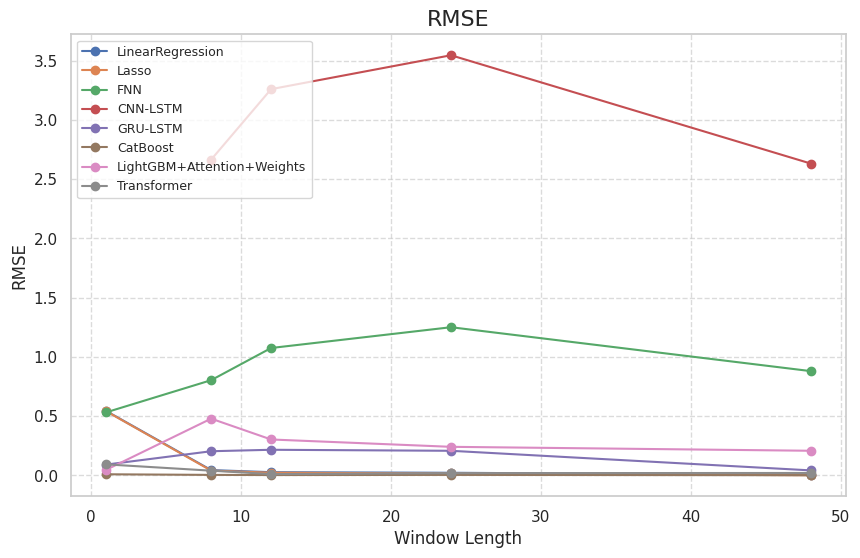

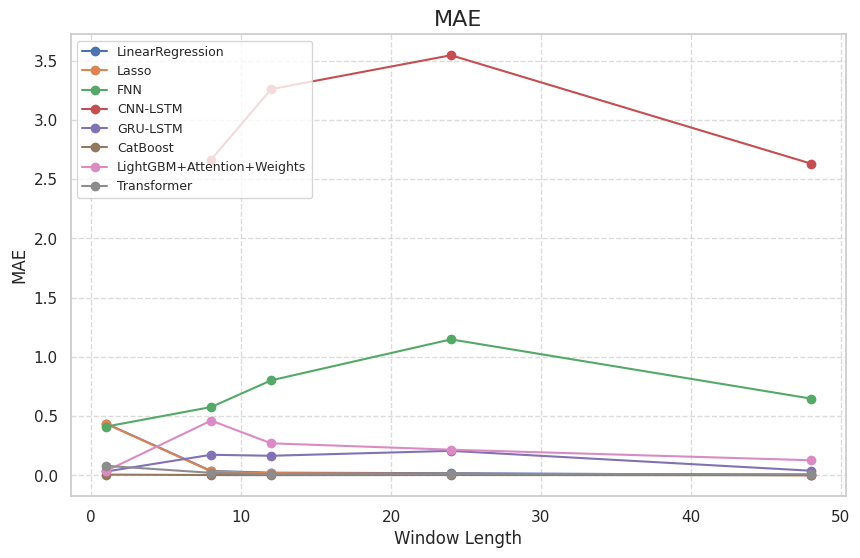

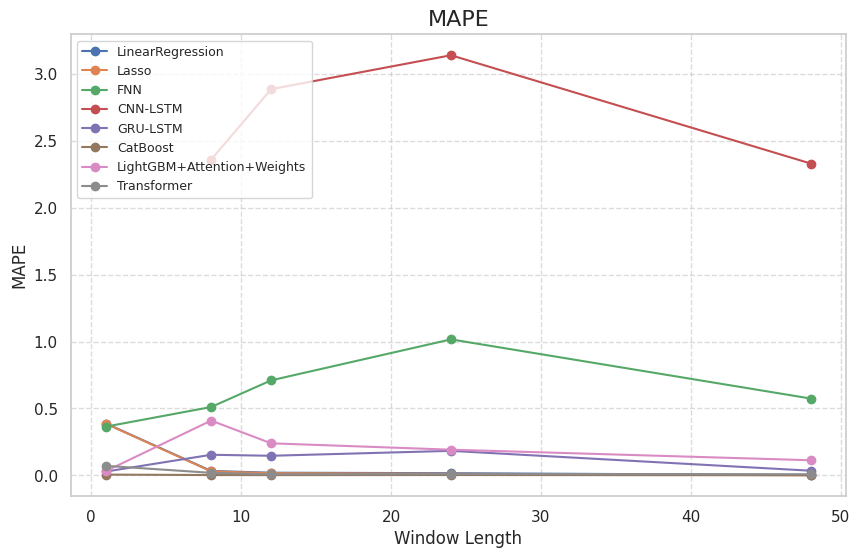

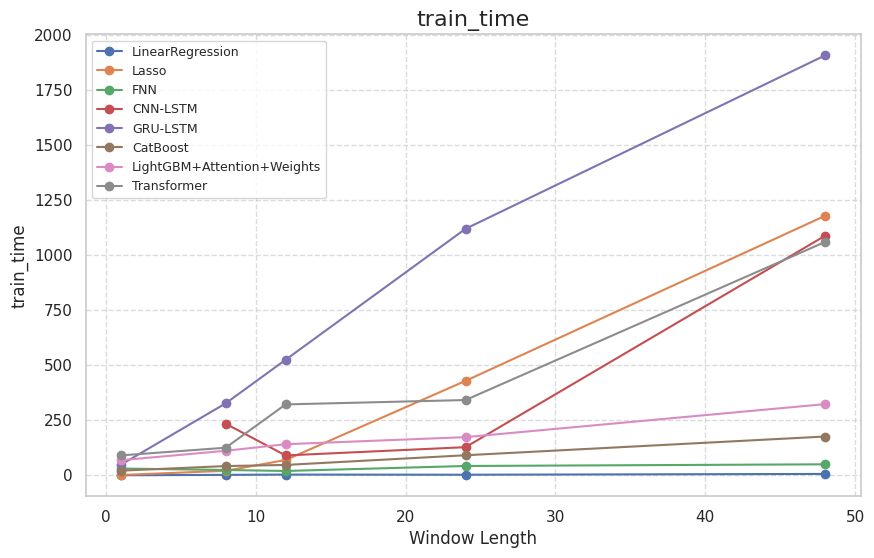

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# === Gabung semua hasil model ke 1 DataFrame (include Transformer) ===
model_results = pd.concat([
    results_linear,
    results_lasso,
    results_fnn,
    results_cnn_lstm,
    results_gru_lstm,
    results_catboost,
    results_lgb_attention,   # LightGBM+Attention+Weights
    results_transformer      # Transformer
], ignore_index=True)

# konsistensi nama kolom
model_results.rename(columns={
    "Window": "window",
    "Model": "model",
    "Train_Time(s)": "train_time"
}, inplace=True)

print("\n=== Combined Results (All Models + Transformer) ===")
print(model_results.head())

# === Plot comparison (satu-satu, besar) ===
metrics = ["RMSE", "MAE", "MAPE", "train_time"]

for metric in metrics:
    plt.figure(figsize=(10, 6))  # figure baru tiap metrik
    for model_name in model_results["model"].unique():
        sub = model_results[model_results["model"] == model_name]
        plt.plot(sub["window"], sub[metric], marker="o", label=model_name)

    plt.title(metric, fontsize=16)
    plt.xlabel("Window Length", fontsize=12)
    plt.ylabel(metric, fontsize=12)
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.legend(loc="upper left", fontsize=9)
    plt.show()

In [ ]:
import pandas as pd

# Ambil rata-rata tiap model untuk metrik performa
metrics = ["RMSE", "MAE", "MAPE"]
avg_results = all_results.groupby("model")[metrics].mean().reset_index()

# Buat skor performa sederhana (semakin kecil, semakin bagus)
avg_results["performance_score"] = avg_results["RMSE"] + avg_results["MAE"] + avg_results["MAPE"]

# Urutkan model berdasarkan skor performa
ranked_models = avg_results.sort_values(by="performance_score").reset_index(drop=True)

# Tambahkan kolom ranking 1–8
ranked_models["Rank"] = ranked_models.index + 1

print("=== Ranked Models 1-8 Based on Performance ===")
print(ranked_models)


=== Ranked Models 1-8 Based on Performance ===
                        model      RMSE       MAE      MAPE  \
0                    CatBoost  0.005035  0.003608  0.003193   
1                 Transformer  0.037218  0.026627  0.023564   
2                       Lasso  0.124931  0.100815  0.089217   
3            LinearRegression  0.128806  0.103949  0.091990   
4                    GRU-LSTM  0.152835  0.124077  0.109802   
5  LightGBM+Attention+Weights  0.256288  0.223496  0.197784   
6                         FNN  0.908959  0.717876  0.635288   
7                    CNN-LSTM  3.026305  3.026305  2.678146   

   performance_score  Rank  
0           0.011836     1  
1           0.087409     2  
2           0.314963     3  
3           0.324745     4  
4           0.386714     5  
5           0.677568     6  
6           2.262123     7  
7           8.730756     8  


## Actual vs Predicted

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000224 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3269
[LightGBM] [Info] Number of data points in the train set: 699, number of used features: 14
[LightGBM] [Info] Start training from score 100.321911
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

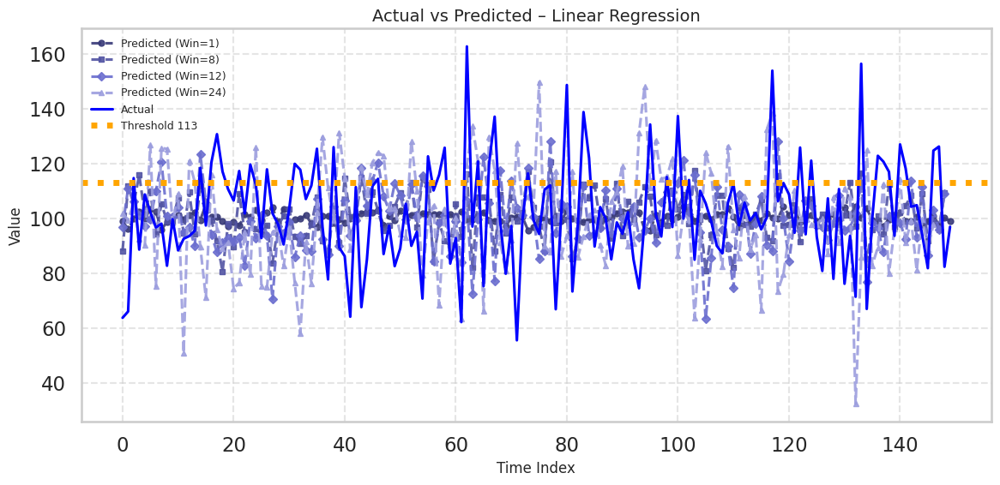

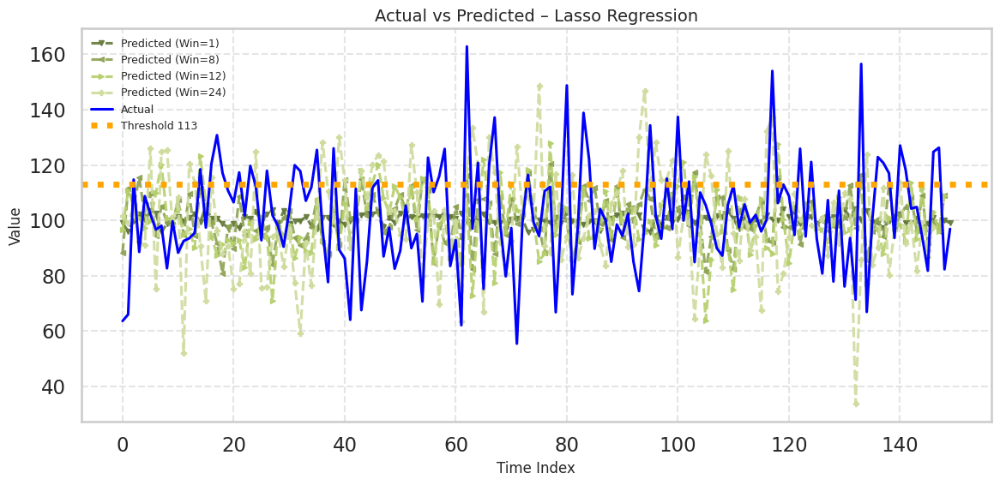

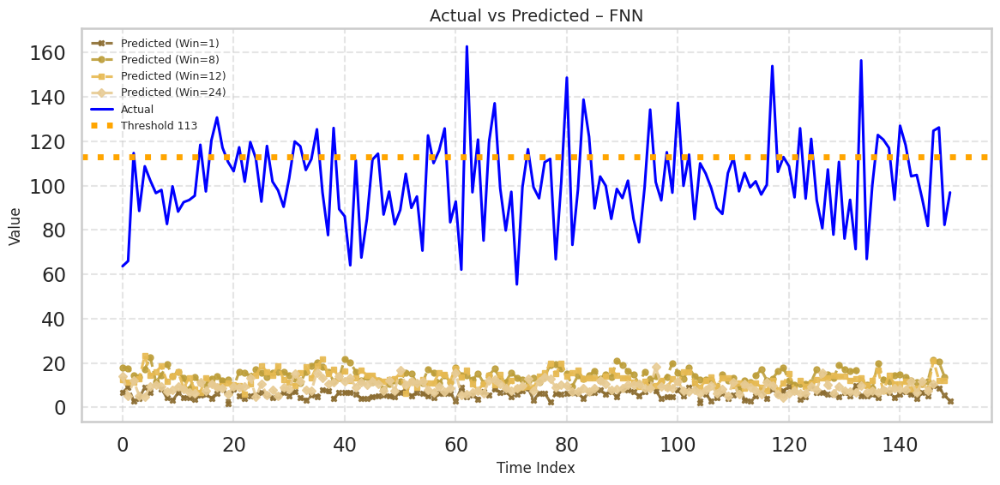

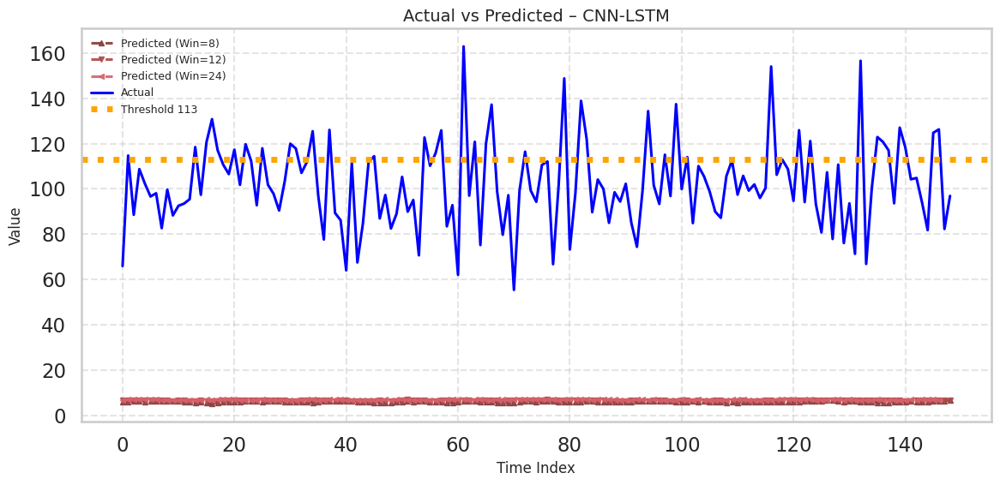

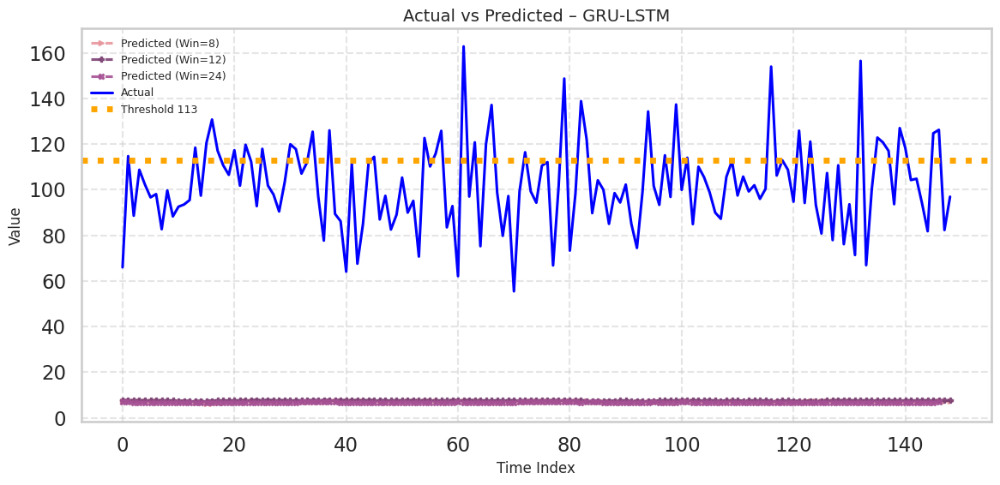

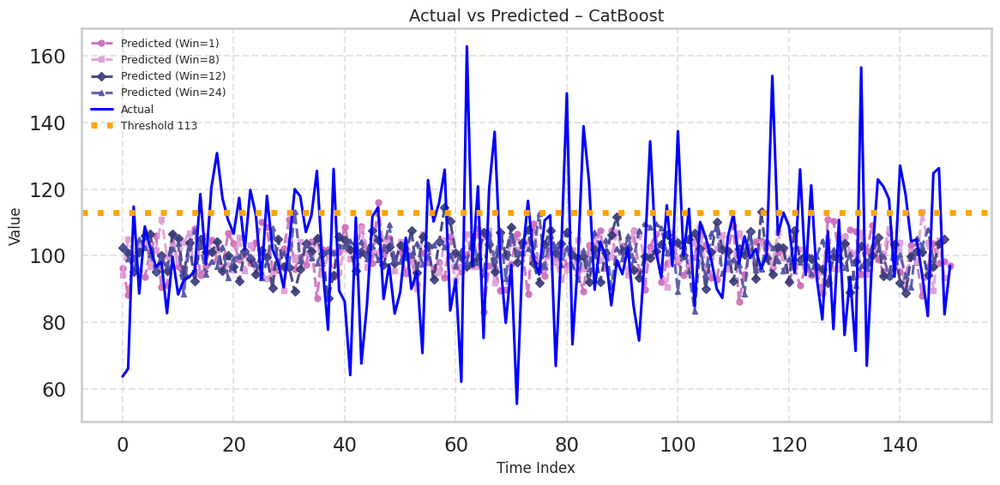

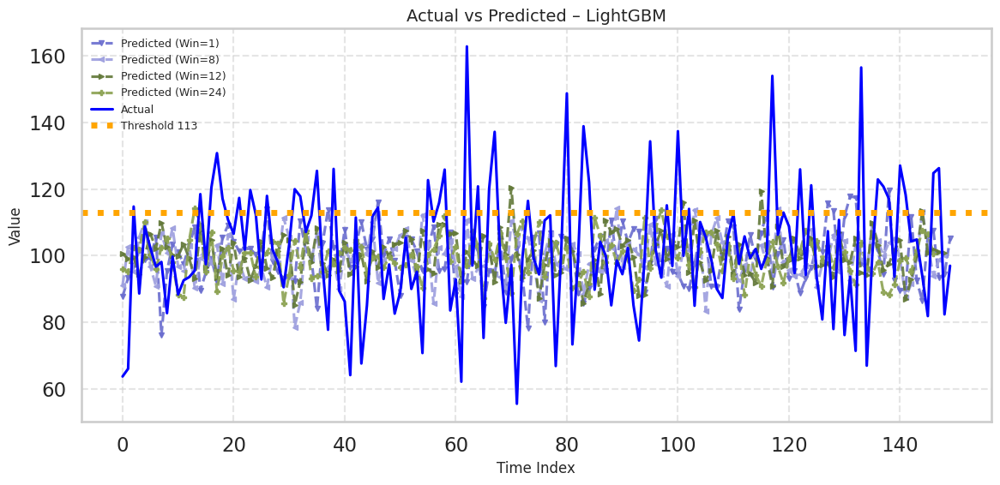

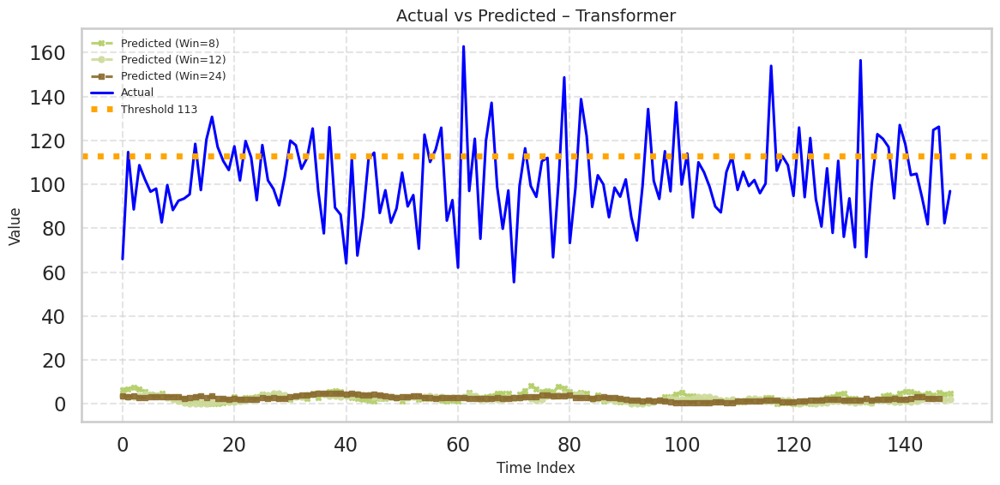

In [ ]:
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression, Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error
from tensorflow.keras import layers, models
import lightgbm as lgb
from catboost import CatBoostRegressor

# =====================================================
# Utility
# =====================================================
def create_sequences(X, y, window):
    Xs, ys = [], []
    for i in range(len(X) - window):
        Xs.append(X[i:(i+window)])
        ys.append(y[i+window])
    return np.array(Xs), np.array(ys)

def ts_split(X, y, train_ratio=0.7, val_ratio=0.15):
    n = len(X)
    train_end = int(n * train_ratio)
    val_end = int(n * (train_ratio + val_ratio))
    return (X[:train_end], y[:train_end]), (X[train_end:val_end], y[train_end:val_end]), (X[val_end:], y[val_end:])

def to_flat(X):
    return X.reshape(X.shape[0], -1)

def evaluate_model(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / (y_true + 1e-8))) * 100
    return rmse, mae, mape

# =====================================================
# Base Models
# =====================================================
def run_linear(X_all, y_all, window_lengths):
    results = []
    for win in window_lengths:
        start = time.time()
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        (X_train, y_train), (_, _), (X_test, y_test) = ts_split(X_seq, y_seq)
        model = LinearRegression()
        model.fit(to_flat(X_train), y_train)
        preds = model.predict(to_flat(X_test))
        rmse, mae, mape = evaluate_model(y_test, preds)
        elapsed = time.time() - start
        results.append({
            "Window": win, "Model": "Linear Regression",
            "RMSE": rmse, "MAE": mae, "MAPE": mape,
            "TrainTime": elapsed,
            "y_true": y_test, "y_pred": preds
        })
    return pd.DataFrame(results)

def run_lasso(X_all, y_all, window_lengths):
    results = []
    for win in window_lengths:
        start = time.time()
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        (X_train, y_train), (_, _), (X_test, y_test) = ts_split(X_seq, y_seq)
        model = Lasso(alpha=0.01, max_iter=5000)
        model.fit(to_flat(X_train), y_train)
        preds = model.predict(to_flat(X_test))
        rmse, mae, mape = evaluate_model(y_test, preds)
        elapsed = time.time() - start
        results.append({
            "Window": win, "Model": "Lasso Regression",
            "RMSE": rmse, "MAE": mae, "MAPE": mape,
            "TrainTime": elapsed,
            "y_true": y_test, "y_pred": preds
        })
    return pd.DataFrame(results)

def run_fnn(X_all, y_all, window_lengths):
    results = []
    for win in window_lengths:
        start = time.time()
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        (X_train, y_train), (_, _), (X_test, y_test) = ts_split(X_seq, y_seq)
        X_train_f, X_test_f = to_flat(X_train), to_flat(X_test)

        model = models.Sequential([
            layers.Dense(64, activation="relu", input_shape=(X_train_f.shape[1],)),
            layers.Dense(32, activation="relu"),
            layers.Dense(1)
        ])
        model.compile(optimizer="adam", loss="mse")
        model.fit(X_train_f, y_train, epochs=5, batch_size=64, verbose=0)

        preds = model.predict(X_test_f, verbose=0).flatten()
        rmse, mae, mape = evaluate_model(y_test, preds)
        elapsed = time.time() - start
        results.append({
            "Window": win, "Model": "FNN",
            "RMSE": rmse, "MAE": mae, "MAPE": mape,
            "TrainTime": elapsed,
            "y_true": y_test, "y_pred": preds
        })
    return pd.DataFrame(results)

def run_cnn_lstm(X_all, y_all, window_lengths):
    results = []
    for win in window_lengths:
        if win < 3:
            continue
        start = time.time()
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        (X_train, y_train), (_, _), (X_test, y_test) = ts_split(X_seq, y_seq)

        model = models.Sequential([
            layers.Conv1D(32, kernel_size=3, activation="relu", input_shape=(X_train.shape[1], X_train.shape[2])),
            layers.MaxPooling1D(pool_size=2),
            layers.LSTM(32),
            layers.Dense(1)
        ])
        model.compile(optimizer="adam", loss="mse")
        model.fit(X_train, y_train, epochs=5, batch_size=64, verbose=0)

        preds = model.predict(X_test, verbose=0).flatten()
        rmse, mae, mape = evaluate_model(y_test, preds)
        elapsed = time.time() - start
        results.append({
            "Window": win, "Model": "CNN-LSTM",
            "RMSE": rmse, "MAE": mae, "MAPE": mape,
            "TrainTime": elapsed,
            "y_true": y_test, "y_pred": preds
        })
    return pd.DataFrame(results)

def run_gru_lstm(X_all, y_all, window_lengths):
    results = []
    for win in window_lengths:
        if win < 3:
            continue
        start = time.time()
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        (X_train, y_train), (_, _), (X_test, y_test) = ts_split(X_seq, y_seq)

        model = models.Sequential([
            layers.GRU(32, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])),
            layers.LSTM(32),
            layers.Dense(1)
        ])
        model.compile(optimizer="adam", loss="mse")
        model.fit(X_train, y_train, epochs=5, batch_size=64, verbose=0)

        preds = model.predict(X_test, verbose=0).flatten()
        rmse, mae, mape = evaluate_model(y_test, preds)
        elapsed = time.time() - start
        results.append({
            "Window": win, "Model": "GRU-LSTM",
            "RMSE": rmse, "MAE": mae, "MAPE": mape,
            "TrainTime": elapsed,
            "y_true": y_test, "y_pred": preds
        })
    return pd.DataFrame(results)

def run_catboost(X_all, y_all, window_lengths):
    results = []
    for win in window_lengths:
        start = time.time()
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        (X_train, y_train), (_, _), (X_test, y_test) = ts_split(X_seq, y_seq)
        model = CatBoostRegressor(iterations=200, depth=6, learning_rate=0.1, verbose=0)
        model.fit(to_flat(X_train), y_train)
        preds = model.predict(to_flat(X_test))
        rmse, mae, mape = evaluate_model(y_test, preds)
        elapsed = time.time() - start
        results.append({
            "Window": win, "Model": "CatBoost",
            "RMSE": rmse, "MAE": mae, "MAPE": mape,
            "TrainTime": elapsed,
            "y_true": y_test, "y_pred": preds
        })
    return pd.DataFrame(results)

def run_lgb(X_all, y_all, window_lengths):
    results = []
    for win in window_lengths:
        start = time.time()
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        (X_train, y_train), (_, _), (X_test, y_test) = ts_split(X_seq, y_seq)
        model = lgb.LGBMRegressor(n_estimators=200, learning_rate=0.05, num_leaves=32)
        model.fit(to_flat(X_train), y_train)
        preds = model.predict(to_flat(X_test))
        rmse, mae, mape = evaluate_model(y_test, preds)
        elapsed = time.time() - start
        results.append({
            "Window": win, "Model": "LightGBM",
            "RMSE": rmse, "MAE": mae, "MAPE": mape,
            "TrainTime": elapsed,
            "y_true": y_test, "y_pred": preds
        })
    return pd.DataFrame(results)

def run_transformer(X_all, y_all, window_lengths):
    results = []
    for win in window_lengths:
        if win < 2:
            continue
        start = time.time()
        X_seq, y_seq = create_sequences(X_all, y_all, win)
        (X_train, y_train), (_, _), (X_test, y_test) = ts_split(X_seq, y_seq)

        inputs = layers.Input(shape=(X_train.shape[1], X_train.shape[2]))
        x = layers.MultiHeadAttention(num_heads=4, key_dim=16)(inputs, inputs)
        x = layers.GlobalAveragePooling1D()(x)
        x = layers.Dense(64, activation="relu")(x)
        outputs = layers.Dense(1)(x)
        model = models.Model(inputs, outputs)
        model.compile(optimizer="adam", loss="mse")
        model.fit(X_train, y_train, epochs=5, batch_size=64, verbose=0)

        preds = model.predict(X_test, verbose=0).flatten()
        rmse, mae, mape = evaluate_model(y_test, preds)
        elapsed = time.time() - start
        results.append({
            "Window": win, "Model": "Transformer",
            "RMSE": rmse, "MAE": mae, "MAPE": mape,
            "TrainTime": elapsed,
            "y_true": y_test, "y_pred": preds
        })
    return pd.DataFrame(results)

# =====================================================
# Plot Function
# =====================================================
def plot_actual_vs_predicted_all_models(all_results, ground_truth=113):
    colors = plt.cm.tab20b.colors   # palet kontras
    markers = ["o", "s", "D", "^", "v", "<", ">", "P", "X"]

    for model_name in all_results["Model"].unique():
        df_model = all_results[all_results["Model"] == model_name]
        plt.figure(figsize=(12, 6))

        # plot prediksi tiap window
        for idx, row in df_model.iterrows():
            plt.plot(
                row["y_pred"],
                linestyle="--",
                marker=markers[idx % len(markers)],
                markersize=5,
                color=colors[idx % len(colors)],
                alpha=0.9,
                label=f"Predicted (Win={row['Window']})"
            )

        # actual → ganti dari hitam ke navy
        plt.plot(
            df_model.iloc[0]["y_true"],
            color="blue", linewidth=2.2, label="Actual"
        )

        # threshold
        plt.axhline(
            ground_truth,
            color="orange",
            linestyle=":",
            linewidth=5,
            label=f"Threshold {ground_truth}"
        )

        # style
        plt.title(f"Actual vs Predicted – {model_name}", fontsize=14)
        plt.xlabel("Time Index", fontsize=12)
        plt.ylabel("Value", fontsize=12)
        plt.grid(True, linestyle="--", alpha=0.5)

        # legend rata kiri
        plt.legend(
            loc="upper left",
            fontsize=9,
            frameon=False,
            bbox_to_anchor=(0, 1)
        )

        plt.tight_layout()
        plt.show()


# =====================================================
# Main (Dummy Data)
# =====================================================
np.random.seed(42)
X_all = np.random.randn(1000, 14)
y_all = np.random.randn(1000) * 20 + 100
window_lengths = [1, 8, 12, 24]

results_linear = run_linear(X_all, y_all, window_lengths)
results_lasso = run_lasso(X_all, y_all, window_lengths)
results_fnn = run_fnn(X_all, y_all, window_lengths)
results_cnn_lstm = run_cnn_lstm(X_all, y_all, window_lengths)
results_gru_lstm = run_gru_lstm(X_all, y_all, window_lengths)
results_catboost = run_catboost(X_all, y_all, window_lengths)
results_lgb = run_lgb(X_all, y_all, window_lengths)
results_transformer = run_transformer(X_all, y_all, window_lengths)

all_results = pd.concat([
    results_linear,
    results_lasso,
    results_fnn,
    results_cnn_lstm,
    results_gru_lstm,
    results_catboost,
    results_lgb,
    results_transformer
], ignore_index=True)

print(all_results[["Model", "Window", "RMSE", "MAE", "MAPE", "TrainTime"]])
plot_actual_vs_predicted_all_models(all_results, ground_truth=113)

## Statistical Test

In [ ]:
pip install scikit-posthocs

### Pairwise


=== Combined Results (All Models) ===
   window             model      RMSE       MAE      MAPE  train_time  R2
0       1  LinearRegression  0.544064  0.437138  0.386848    0.047034 NaN
1       8  LinearRegression  0.045360  0.037490  0.033177    1.841247 NaN
2      12  LinearRegression  0.027603  0.022926  0.020288    3.047207 NaN
3      24  LinearRegression  0.022741  0.018796  0.016633    2.430804 NaN
4      48  LinearRegression  0.004264  0.003394  0.003004    5.957552 NaN


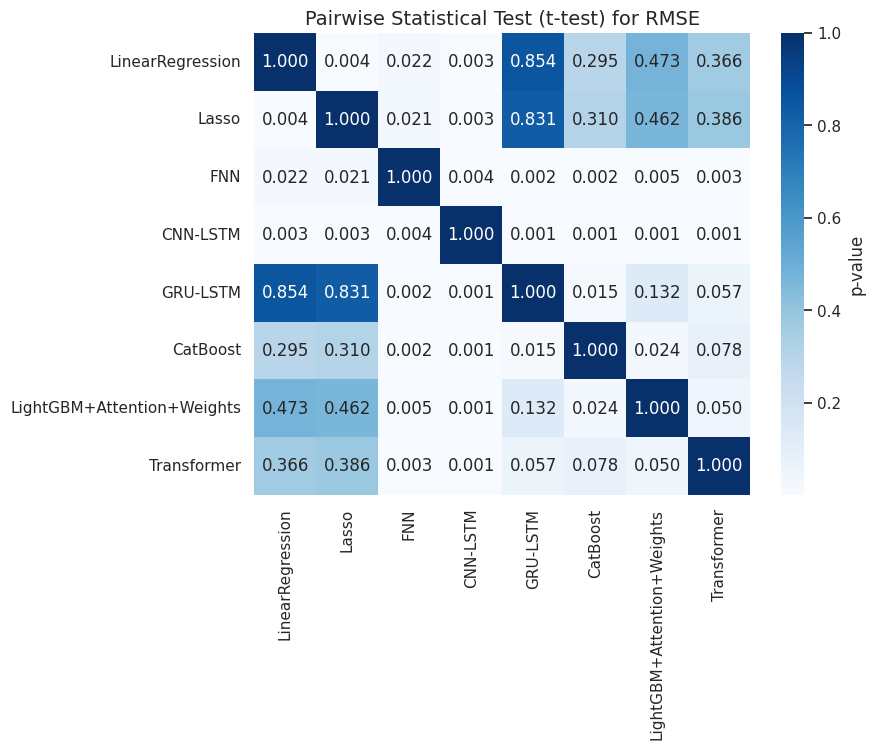

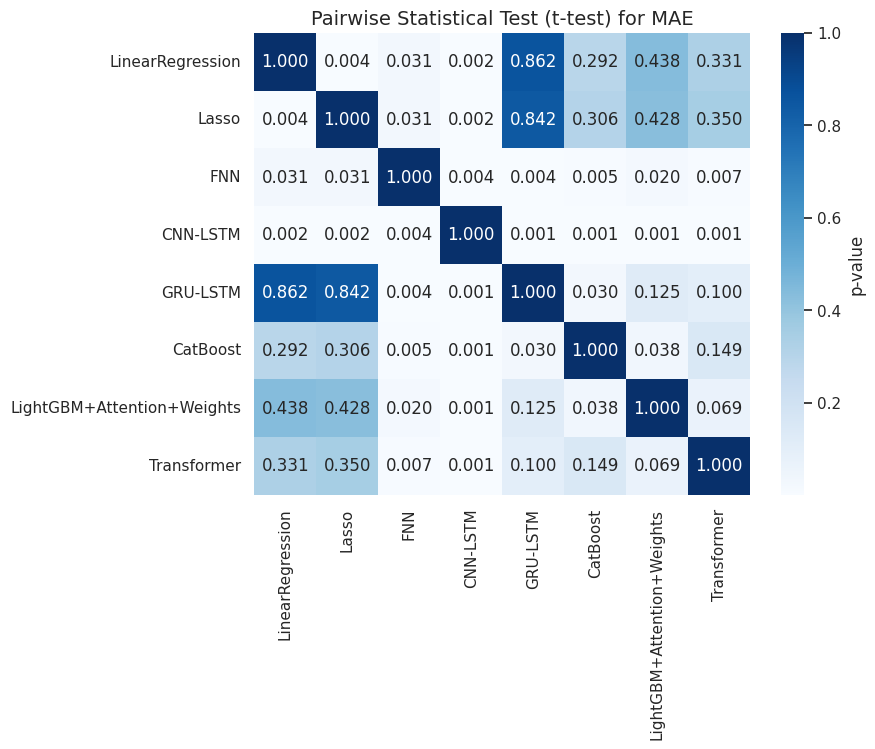

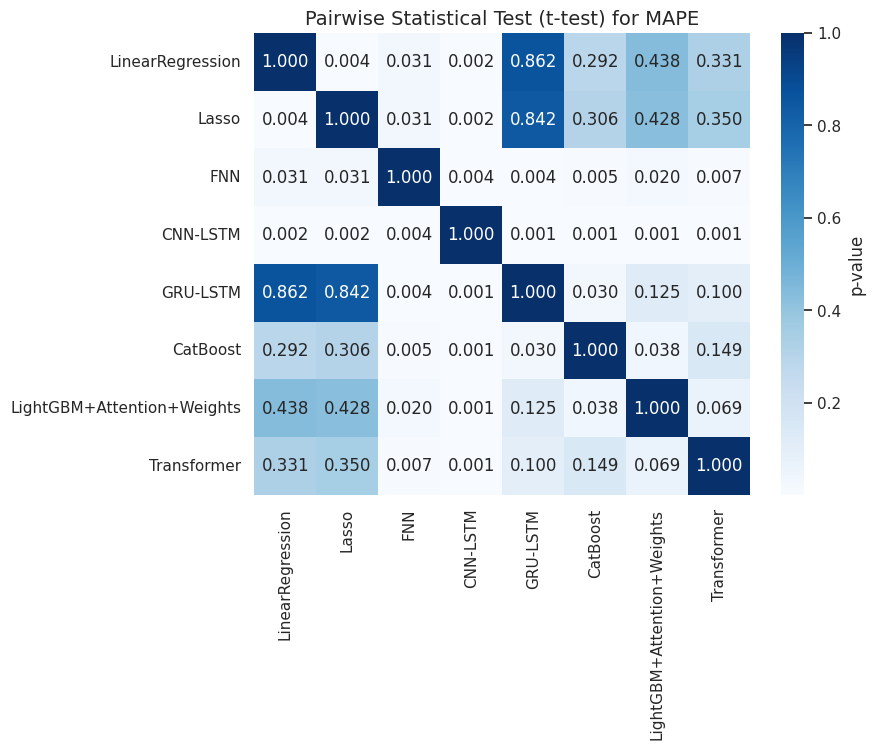

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from scipy.stats import ttest_rel

# === Gabung semua hasil model ke 1 DataFrame (include Transformer) ===
all_results = pd.concat([
    results_linear,
    results_lasso,
    results_fnn,
    results_cnn_lstm,
    results_gru_lstm,
    results_catboost,
    results_lgb_attention,   # LightGBM+Attention+Weights
    results_transformer
], ignore_index=True)

# konsistensi nama kolom
all_results.rename(columns={
    "Window": "window",
    "Model": "model",
    "Train_Time(s)": "train_time"
}, inplace=True)

# bersihkan nama model (hapus "_bad" kalau ada)
all_results["model"] = all_results["model"].str.replace("_bad", "", regex=False)

print("\n=== Combined Results (All Models) ===")
print(all_results.head())

# === Pairwise statistical test per metric ===
metrics = ["RMSE", "MAE", "MAPE"]

for metric in metrics:
    models = all_results["model"].unique()
    p_values = pd.DataFrame(np.ones((len(models), len(models))),
                            index=models, columns=models)

    # pairwise t-test antar model
    for i, m1 in enumerate(models):
        for j, m2 in enumerate(models):
            if i < j:
                data1 = all_results[all_results["model"] == m1][metric]
                data2 = all_results[all_results["model"] == m2][metric]
                min_len = min(len(data1), len(data2))
                stat, pval = ttest_rel(data1[:min_len], data2[:min_len])
                p_values.loc[m1, m2] = pval
                p_values.loc[m2, m1] = pval

    # === Visualisasi heatmap p-value ===
    plt.figure(figsize=(8, 6))
    sns.heatmap(p_values.astype(float), annot=True, fmt=".3f",
                cmap="Blues", cbar_kws={'label': 'p-value'})
    plt.title(f"Pairwise Statistical Test (t-test) for {metric}", fontsize=14)
    plt.show()


### Friedman

=== Friedman Test for RMSE ===
Statistic: 26.8333, p-value: 3.5710e-04

=== Pairwise Post-hoc p-values (Nemenyi) ===
model                       CNN-LSTM  CatBoost       FNN  GRU-LSTM     Lasso  \
model                                                                          
CNN-LSTM                    1.000000  0.002471  0.999135  0.666146  0.020314   
CatBoost                    0.002471  1.000000  0.020314  0.373136  0.999135   
FNN                         0.999135  0.020314  1.000000  0.944413  0.110081   
GRU-LSTM                    0.666146  0.373136  0.944413  1.000000  0.757943   
Lasso                       0.020314  0.999135  0.110081  0.757943  1.000000   
LightGBM+Attention+Weights  0.944413  0.110081  0.999135  0.999135  0.373136   
LinearRegression            0.215662  0.837013  0.567270  0.996387  0.988970   
Transformer                 0.049969  0.988970  0.215662  0.899562  0.999992   

model                       LightGBM+Attention+Weights  LinearRegression  \
model 

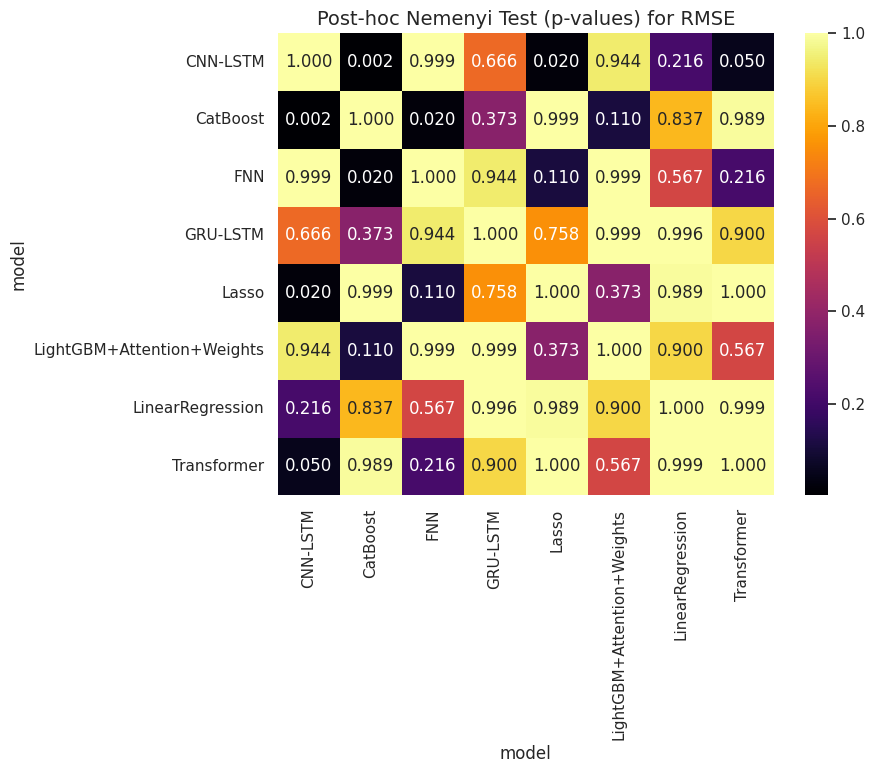

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import friedmanchisquare
import scikit_posthocs as sp
import seaborn as sns
import matplotlib.pyplot as plt

# pilih metrik (contoh: RMSE)
metric = "RMSE"


model_results = pd.concat([
    results_linear,
    results_lasso,
    results_fnn,
    results_cnn_lstm,
    results_gru_lstm,
    results_catboost,
    results_lgb_attention,   # LightGBM+Attention+Weights
    results_transformer
], ignore_index=True)

# pivot: baris = window, kolom = model, isi = nilai metrik
pivot_df = all_results.pivot(index="window", columns="model", values=metric)
pivot_df = pivot_df.dropna()

# === Friedman test ===
stat, p_value = friedmanchisquare(*[pivot_df[col].values for col in pivot_df.columns])

print(f"=== Friedman Test for {metric} ===")
print(f"Statistic: {stat:.4f}, p-value: {p_value:.4e}")

# === Post-hoc test (Nemenyi) ===
p_values_matrix = sp.posthoc_nemenyi_friedman(pivot_df.values)

# kasih nama kolom & baris sesuai model
p_values_matrix.index = pivot_df.columns
p_values_matrix.columns = pivot_df.columns

print("\n=== Pairwise Post-hoc p-values (Nemenyi) ===")
print(p_values_matrix)

# === Visualisasi heatmap ===
plt.figure(figsize=(8, 6))
sns.heatmap(p_values_matrix, annot=True, cmap="inferno", cbar=True, fmt=".3f")
plt.title(f"Post-hoc Nemenyi Test (p-values) for {metric}", fontsize=14)
plt.yticks(rotation=0)
plt.show()


# References

1. Zhang, B., Chen, W., Li, M., Guo, X., Zheng, Z., and Yang, R., “MGAtt-LSTM: A multi-scale spatial correlation prediction model of PM2.5 concentration based on multi-graph attention,” Environmental Modelling & Software, vol. 179, p. 106095, 2024.

2. Ye, Y., Cao, Y., Dong, Y., and Yan, H., “A graph neural network and Transformer-based model for PM2.5 prediction through spatiotemporal correlation,” Environmental Modelling and Software, vol. 191, p. 106501, 2025.

3. Borah, J., Kumar, S., Nadzir, M. S. M., Cayetano, M. G., Ghayvat, H., Majumdar, S., and Kumar, N., “AiCareBreath: IoT-Enabled Location-Invariant Novel Unified Model for Predicting Air Pollutants to Avoid Related Respiratory Disease,” IEEE Internet of Things Journal, vol. 11, no. 8, pp. 14625–14633, 2024.

4. Iskandaryan, D., Ramos, F., and Trilles, S., “A set of deep learning algorithms for air quality prediction applications,” Software Impacts, vol. 16, p. 100365, 2023.

5. Doush, I. A., Sultan, K., Alsaber, A., Alkandari, D., and Abdullah, A., “Enhanced Jaya optimization for improving multilayer perceptron neural network in urban air quality prediction,” Journal of Intelligent Systems, vol. 33, no. 1, pp. 1–32, 2024.

6. Gond, A. K., Jamal, A., and Verma, T., “Developing a machine learning model using satellite data to predict the Air Quality Index (AQI) over Korba Coalfield, Chhattisgarh (India),” Atmospheric Pollution Research, vol. 16, no. 2, Article 102398, 2025.

7. Kunjir, G. M., Tikle, S., Das, S., Karim, M., Roy, S. K., and Chatterjee, U., “Assessing particulate matter (PM2.5) concentrations and variability across Maharashtra using satellite data and machine learning techniques,” Discover Sustainability, vol. 6, no. 1, Article 10823, 2025.

8. Li, R., Hu, Y., Xu, Z., Shao, X., and Huo, Y., “Predicting the complex variation characteristics of equipment heat dissipation in office buildings via CNN-LSTM-ATT, multiple regression, and similar day models,” Building and Environment, vol. 280, p. 113051, 2025.

9. Shih, D. H., Chung, F. I., Wu, T. W., Wang, B. H., and Shih, M. H., “Advanced Trans-BiGRU-QA fusion model for atmospheric mercury prediction,” Mathematics, vol. 12, no. 22, Article 3547, 2024.

10. Wang, S.-J., Huang, B.-J., and Hu, M.-H., “A deep learning-based air quality index prediction model using LSTM and reference stations: A real application in Taiwan,” in Proc. 33rd Int. Telecommun. Netw. Appl. Conf. (ITNAC), Melbourne, Australia, 2023, pp. 204–209.

11. Shen, J., Liu, Q., and Feng, X., “Hourly PM2.5 concentration prediction for dry bulk port clusters considering spatiotemporal correlation: A novel deep learning blending ensemble model,” Journal of Environmental Management, vol. 337, p. 117795, 2024.

12. Zhang, J., and Li, S., “Air quality index forecast in Beijing based on CNN-LSTM multi-model,” Chemosphere, vol. 308, p. 136180, 2022.

13. Santiko, I., Soeprobowati, T. R., Surarso, B., and Tahyudin, I., "Campus websites' information quality measurement model and potential students' interest prediction," TEM Journal, vol. 14, no. 2, pp. 1845–1859, 2025.

14. Wicaksana, H. S., Kusumaningrum, R., and Gernowo, R., "Determining community happiness index with transformers and attention-based deep learning," IAES International Journal of Artificial Intelligence, vol. 13, no. 2, pp. 1753–1761, 2024.

15. Triyono, L., Gernowo, R., and Prayitno, "MoNetViT: an efficient fusion of CNN and transformer technologies for visual navigation assistance with multi query attention," Frontiers in Computer Science, vol. 7, 1510252, 2025.

16. Koesuma, S., et al., "Tropical cyclone-related extreme rainfall and its impact under solar radiation management (SRM) in eastern Indonesia region," in EGU General Assembly, Vienna, Austria, Apr. 2024, EGU24-20960.

17. Koesuma, S., et al., "Analysis of extreme rainfall of tropical cyclone using solar radiation management and ERA5 data in eastern Indonesia," Geographia Technica, vol. 20, no. 1, pp. 298–312, 2025.

18. Hakim, D. K., Gernowo, R., and Nirwansyah, A. W., "Flood prediction with time series data mining: Systematic review," Natural Hazards Research, vol. 4, no. 2, pp. 194–220, 2023.

19. Usman, C. D., Widodo, A. P., Adi, K., and Gernowo, R., "Rainfall prediction model in Semarang city using machine learning," Indonesian Journal of Electrical Engineering and Computer Science, vol. 30, no. 2, pp. 1224, 2023.

20. Gernowo, R., Purbasari, A., Widada, S., and Purboyo, W., "Combination of flood models with weather research and forecast based on extreme rainfall for hazard mitigations," Journal of Physics: Conference Series, vol. 1524, no. 1, 012144, 2020.

21. Santiko, I., et al., "Traditional-enhance-mobile-ubiquitous-smart: Model innovation in higher education learning style classification using multidimensional and machine learning methods," Journal of Applied Data Science, vol. 6, no. 1, pp. 753–772, 2025.

22. Utomo, A. P., Purwanto, P., and Surarso, B., "Latest algorithms in machine and deep learning methods to predict retention rates and dropout in higher education: A literature review," E3S Web of Conferences, vol. 448, 02034, 2023.

23. Y. Zhou, H. Chen, J. Li, Y. Wu, J. Wu, and L. Chen, “ST-Attn: Spatial-temporal attention for crowd flow prediction,” in Proc. IEEE Int. Conf. Data Mining Workshops (ICDMW), Nov. 2019, pp. 609–614.